In [1]:
import os
import random
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import glob
from scipy.signal import butter, filtfilt
from scipy.signal import resample_poly
import librosa

**FASE DI PREPROCESSING E REORDERING DEI FILE IN COLONNE**

***

Processando il file: ThesisS19_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3903.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS19_Lab_Math.txt


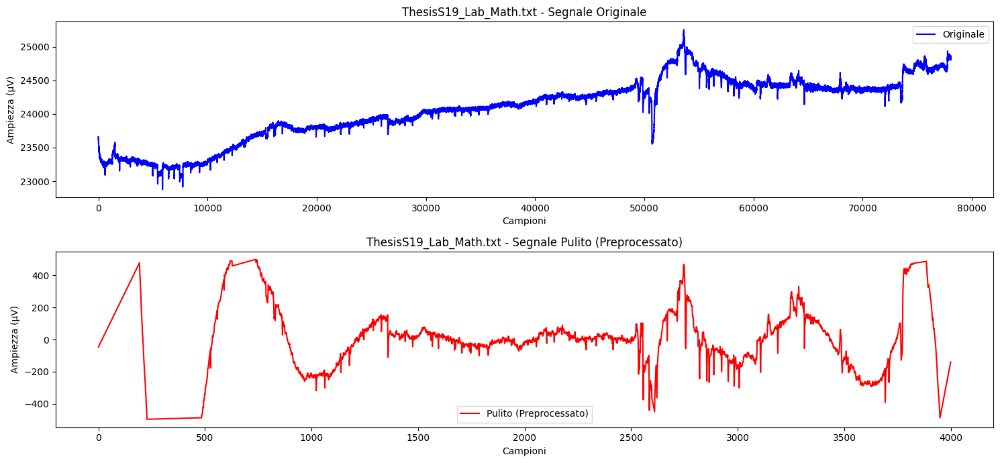

Processando il file: ThesisS10_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4003.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS10_Lab_EyesClosed.txt


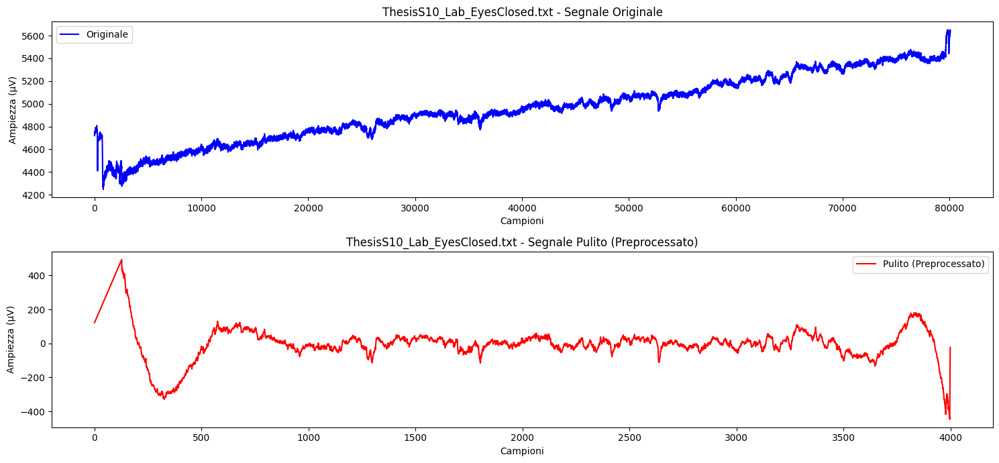

Processando il file: ThesisS26_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS26_Lab_EyesClosed.txt


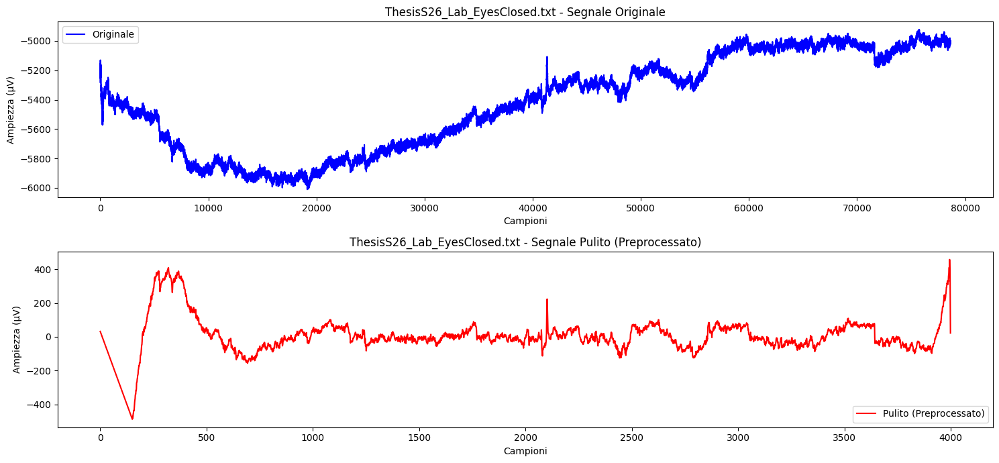

Processando il file: ThesisS5_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3887.6 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS5_Natural_EyesClosed.txt


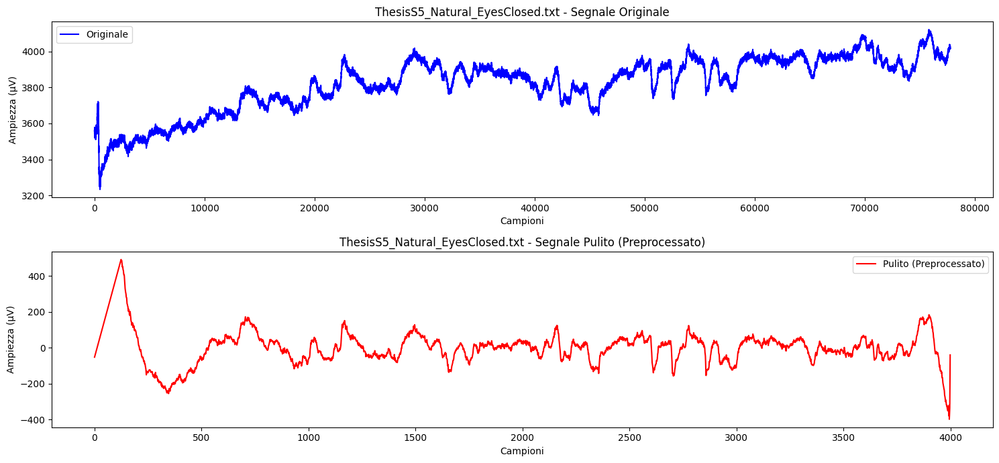

Processando il file: ThesisS16_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3816.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS16_Natural_Math.txt


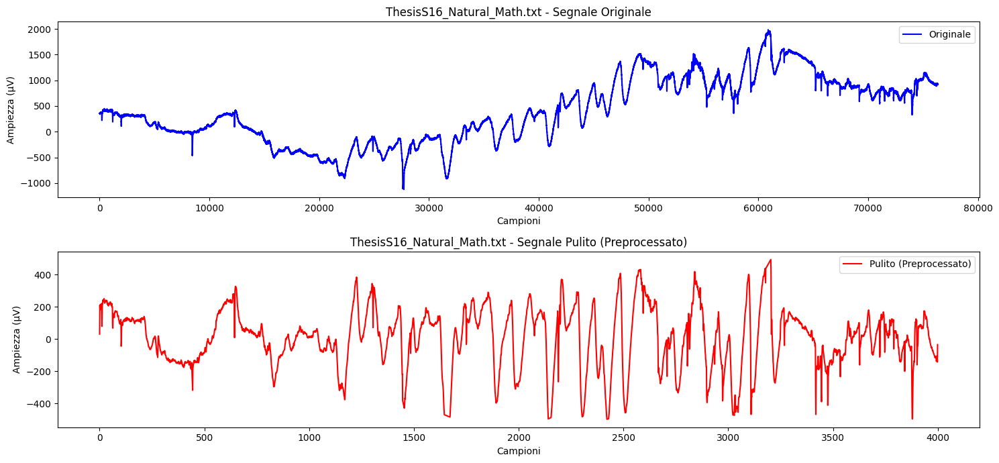

Processando il file: ThesisS19_Natural_Math.txt
Frequenza di campionamento originale calcolata: 4315.55 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS19_Natural_Math.txt


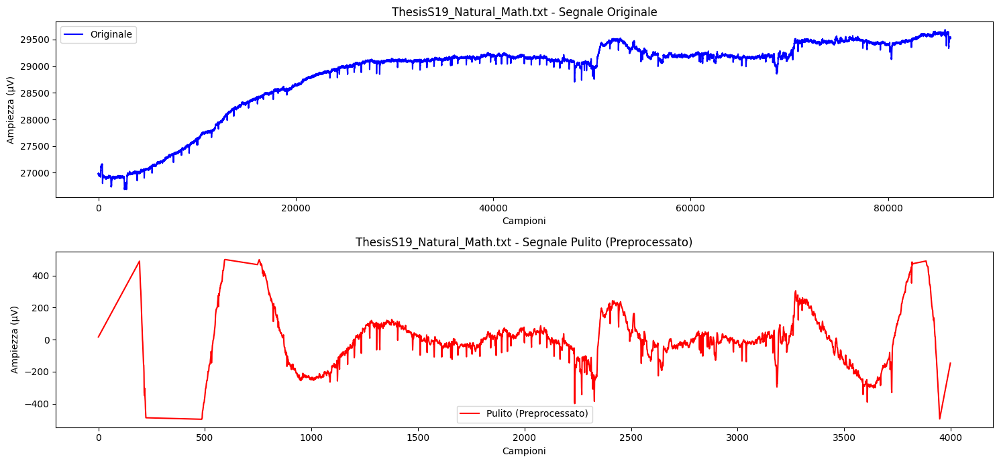

Processando il file: ThesisS7_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4103.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS7_Lab_EyesClosed.txt


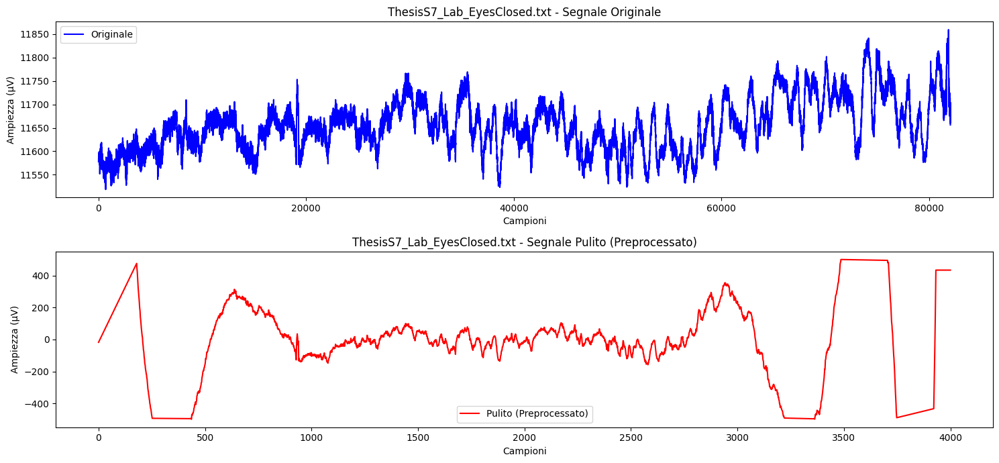

Processando il file: ThesisS10_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3802.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS10_Lab_EyesOpen.txt


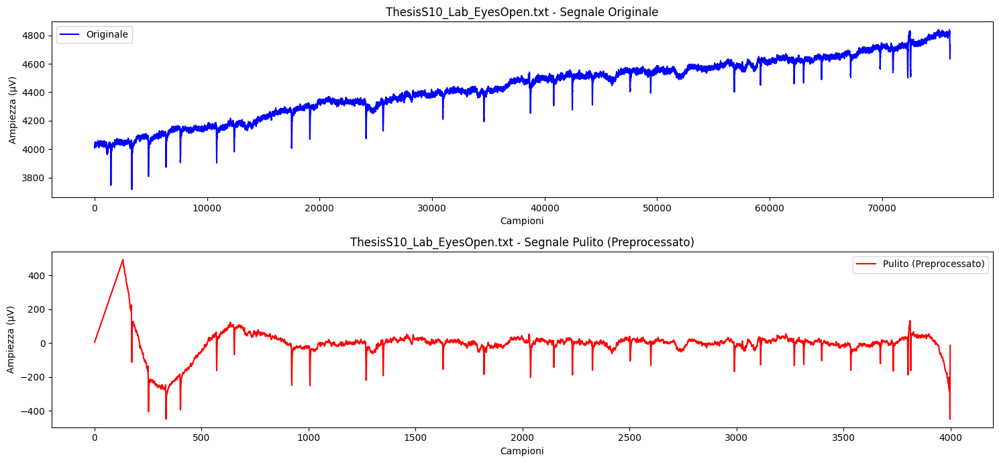

Processando il file: ThesisS7_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3846.6 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS7_Natural_Math.txt


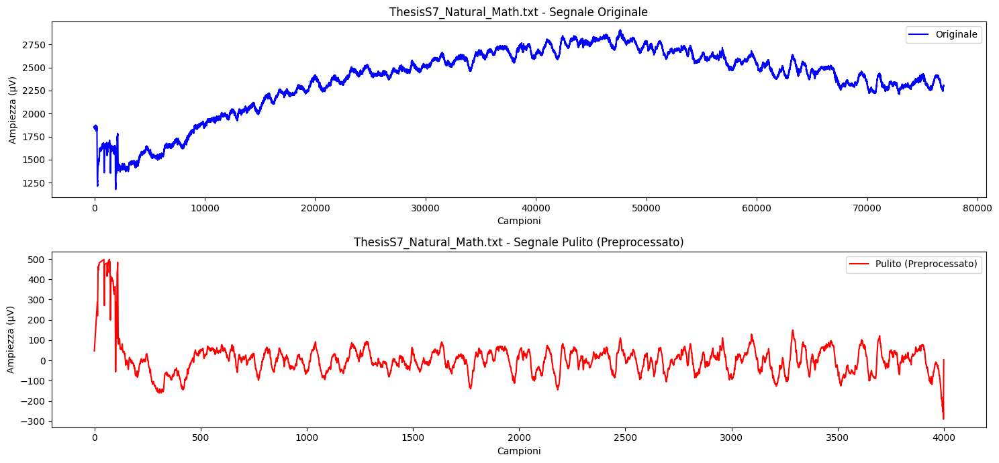

Processando il file: ThesisS20_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3758.8 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS20_Lab_EyesClosed.txt


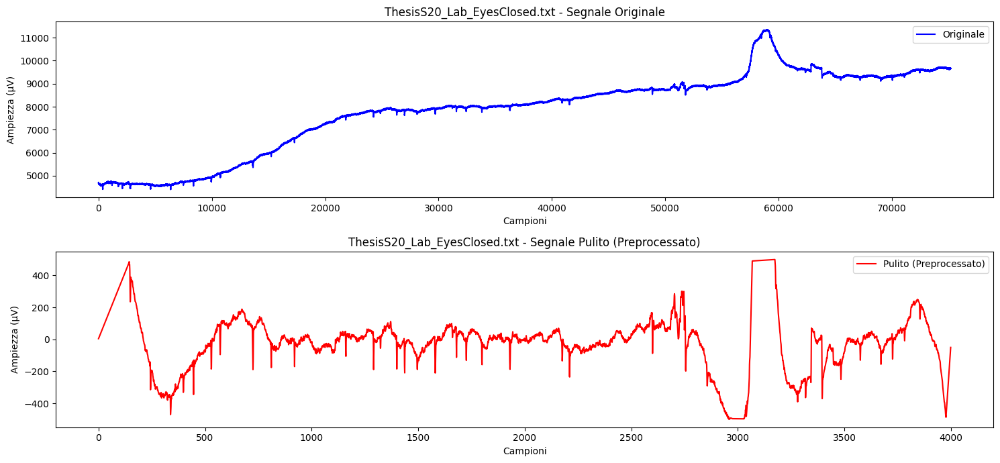

Processando il file: ThesisS3_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3860.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS3_Natural_EyesOpen.txt


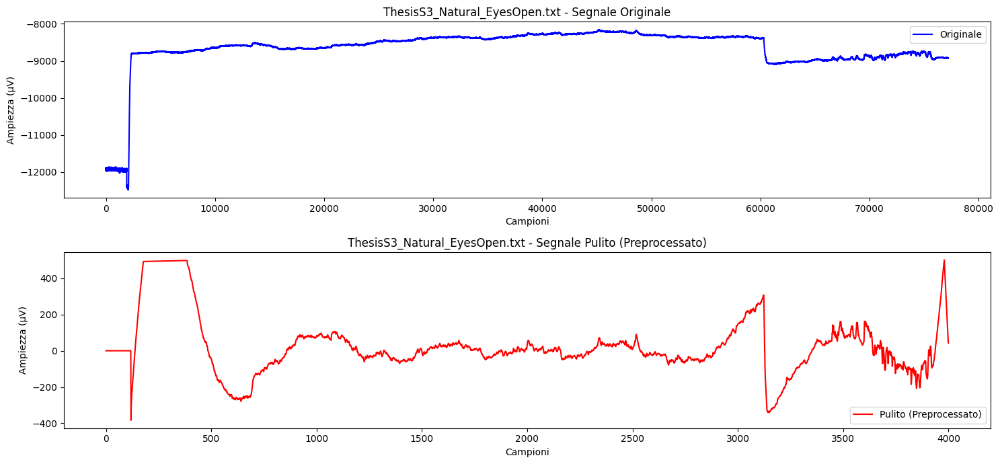

Processando il file: ThesisS3_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3974.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS3_Lab_EyesOpen.txt


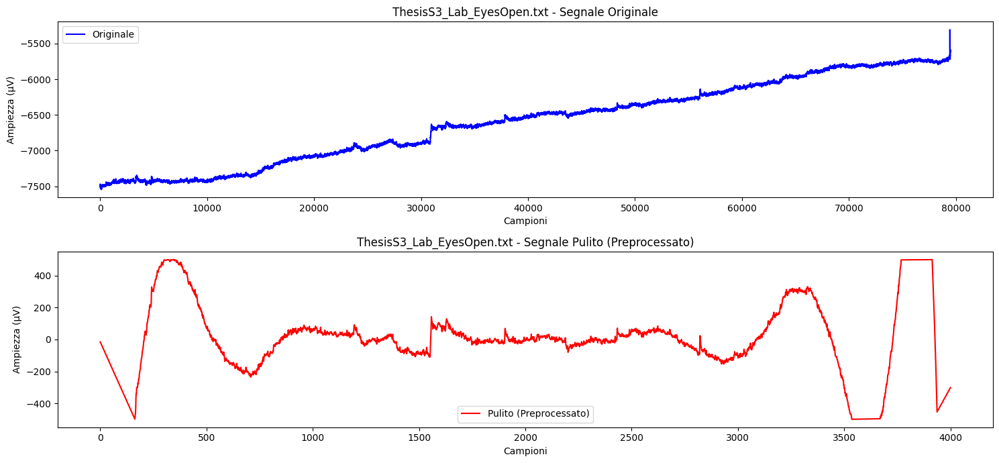

Processando il file: ThesisS14_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3845.95 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS14_Lab_EyesClosed.txt


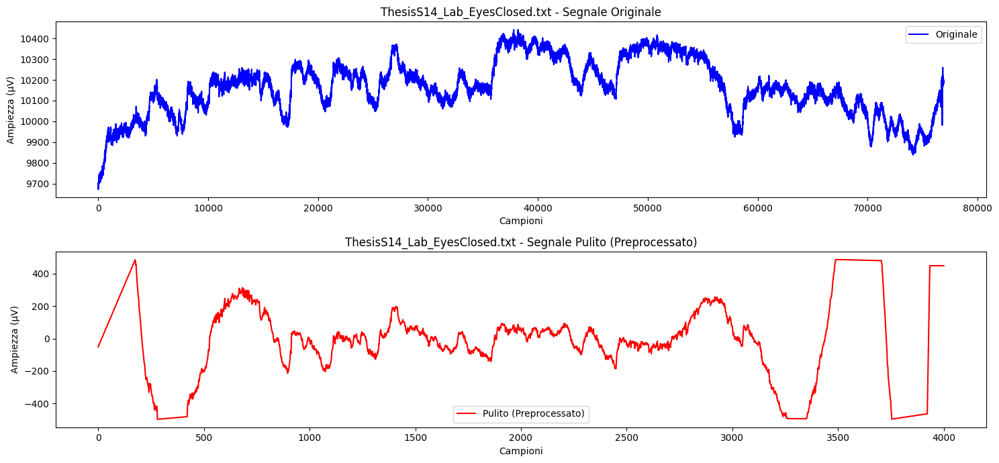

Processando il file: ThesisS23_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4003.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS23_Lab_EyesOpen.txt


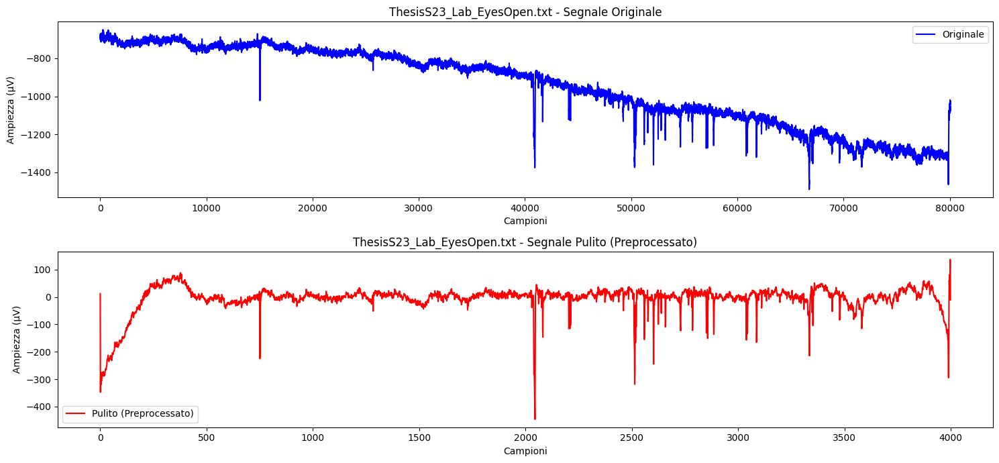

Processando il file: ThesisS24_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4103.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS24_Lab_EyesClosed.txt


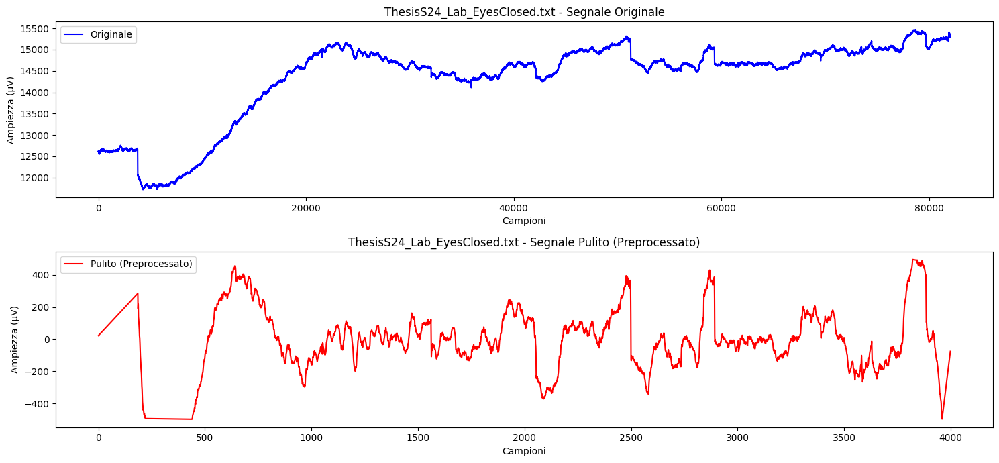

Processando il file: ThesisS3_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4003.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS3_Natural_EyesClosed.txt


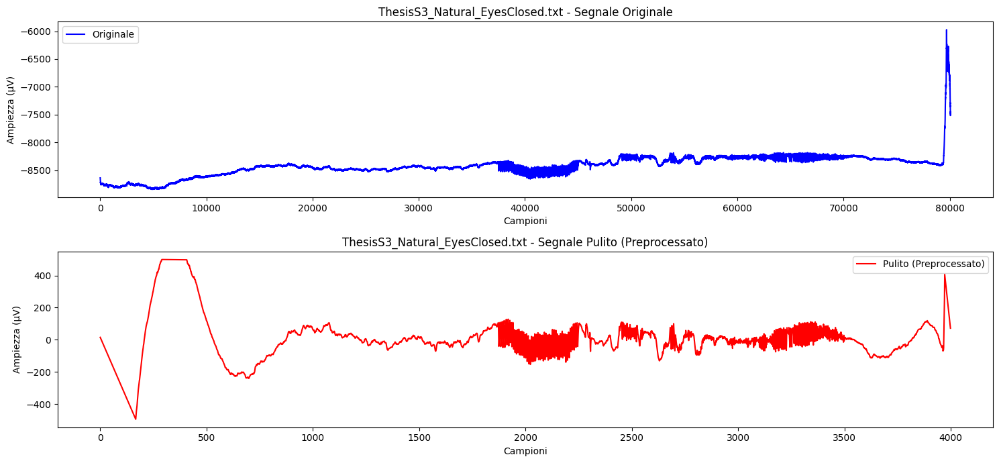

Processando il file: ThesisS8_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4060.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS8_Lab_EyesClosed.txt


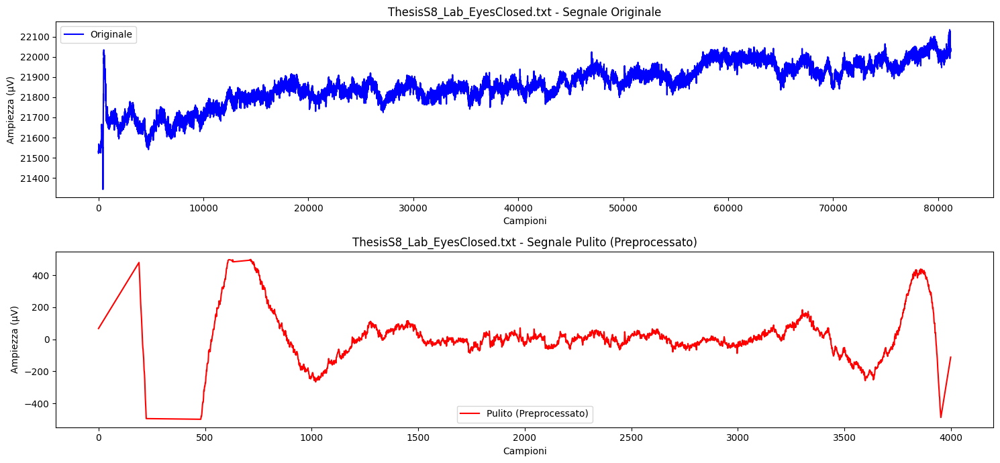

Processando il file: ThesisS9_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3989.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS9_Lab_EyesOpen.txt


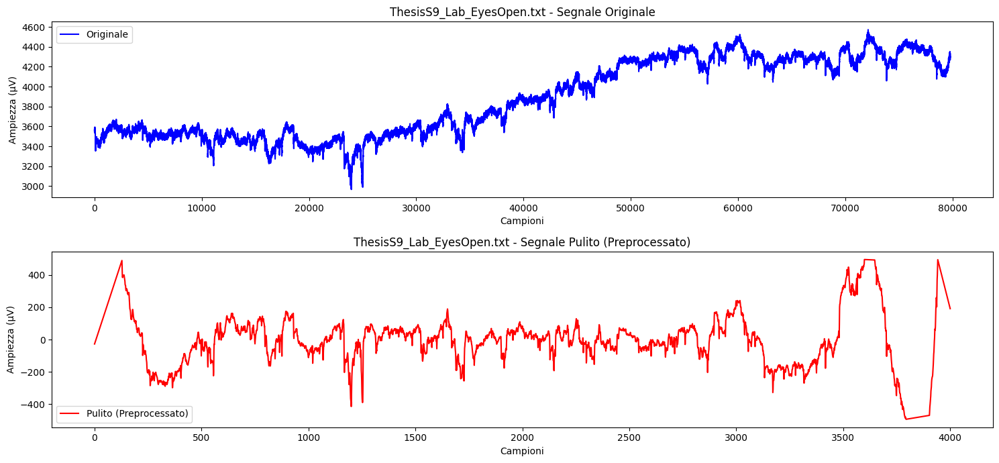

Processando il file: ThesisS17_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS17_Lab_Math.txt


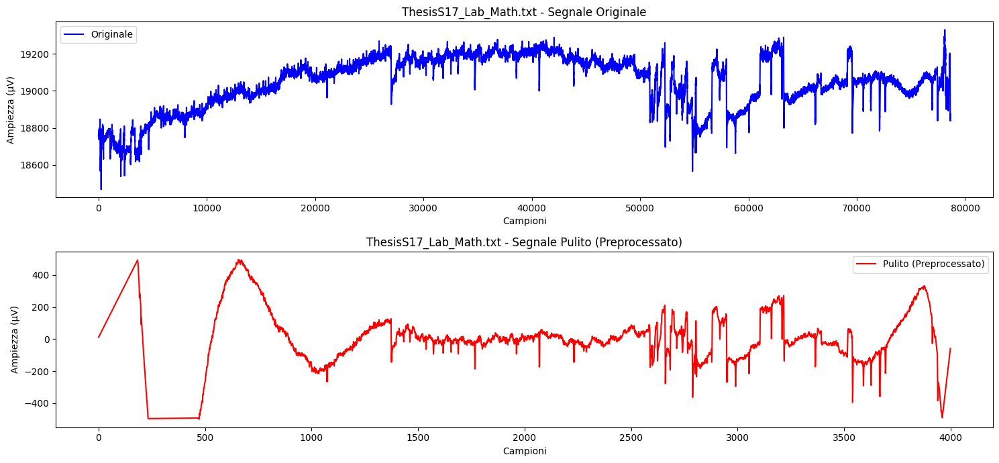

Processando il file: ThesisS9_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3917.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS9_Natural_EyesOpen.txt


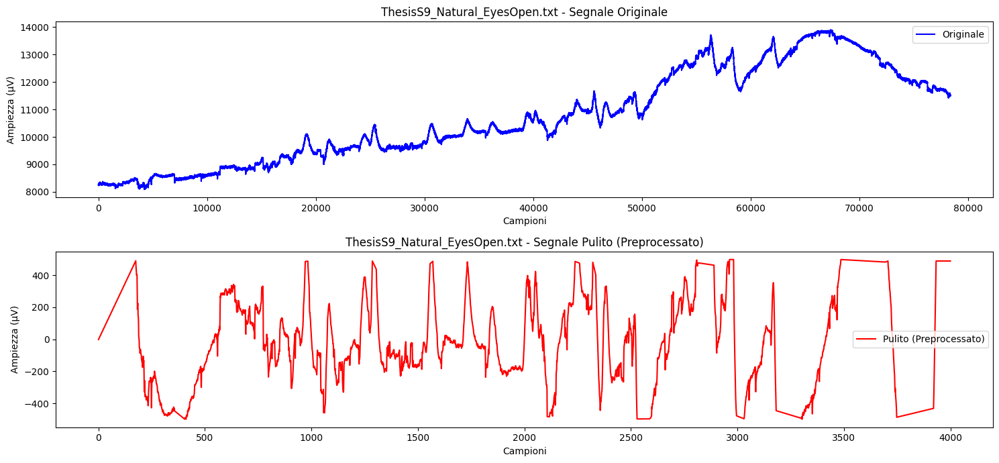

Processando il file: ThesisS16_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4201.4 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS16_Lab_EyesClosed.txt


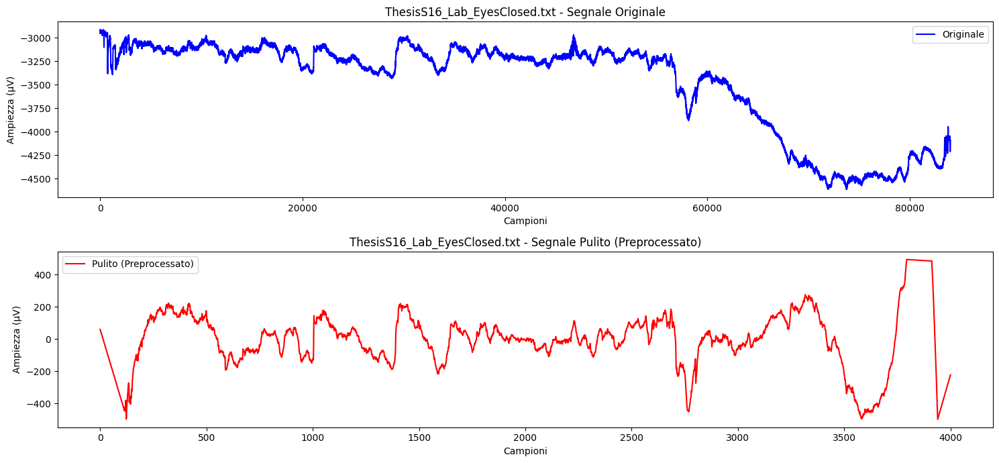

Processando il file: ThesisS7_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4428.75 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS7_Natural_EyesClosed.txt


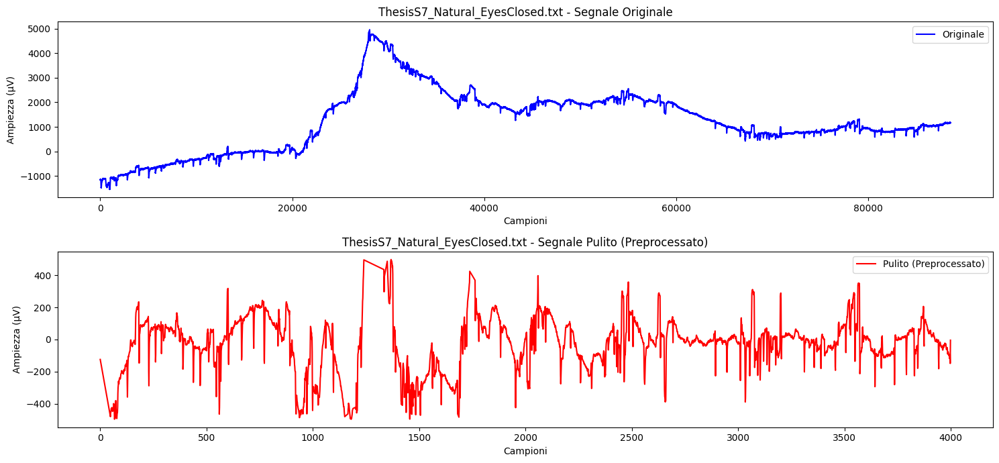

Processando il file: ThesisS22_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3816.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS22_Natural_Math.txt


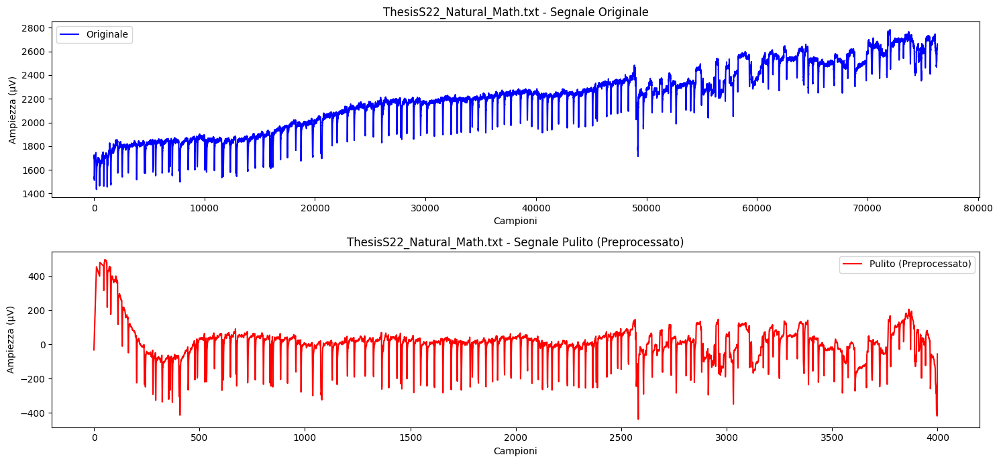

Processando il file: ThesisS18_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3903.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS18_Lab_EyesOpen.txt


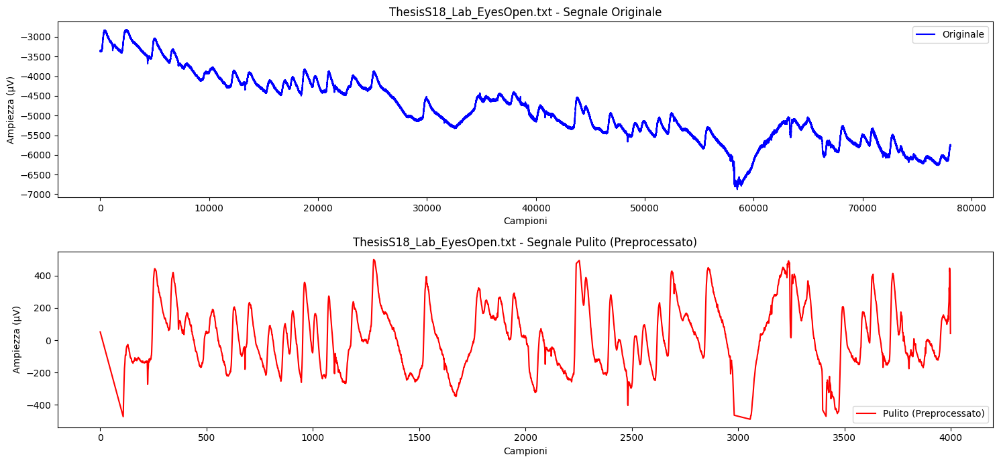

Processando il file: ThesisS11_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS11_Lab_EyesOpen.txt


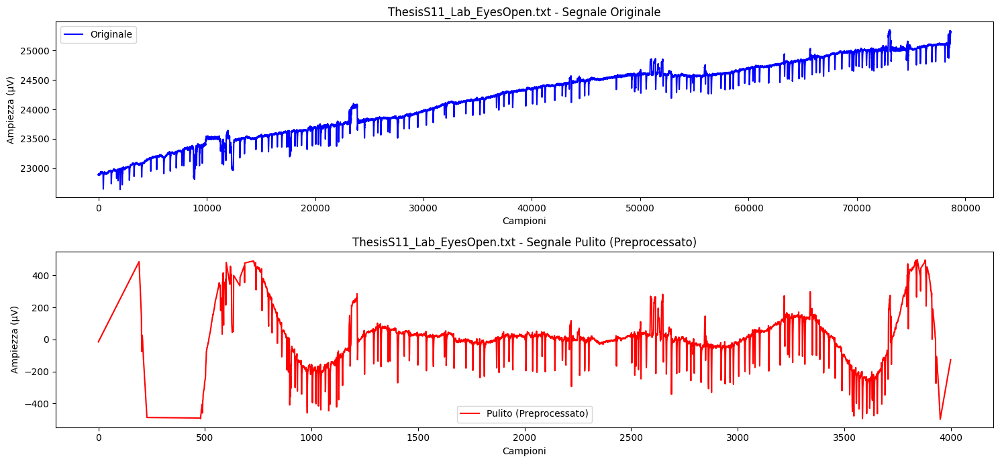

Processando il file: ThesisS21_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3759.3 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS21_Natural_Math.txt


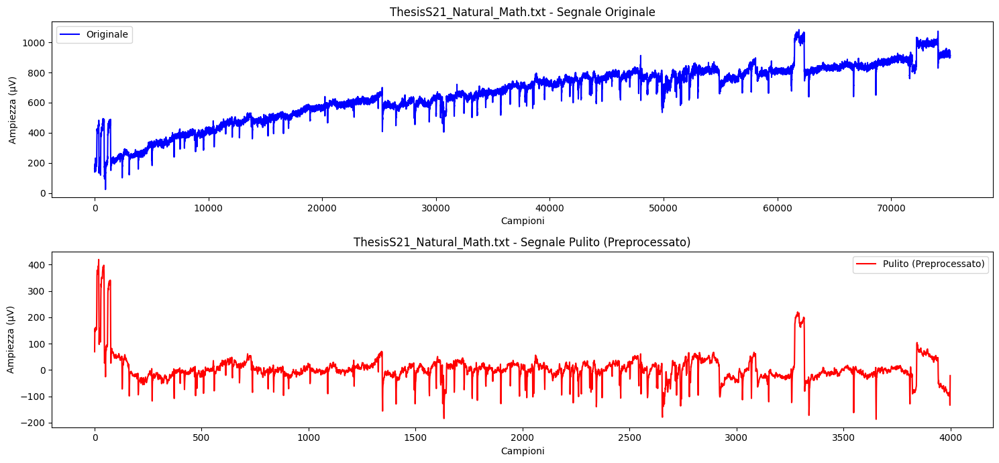

Processando il file: ThesisS26_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4157.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS26_Natural_EyesOpen.txt


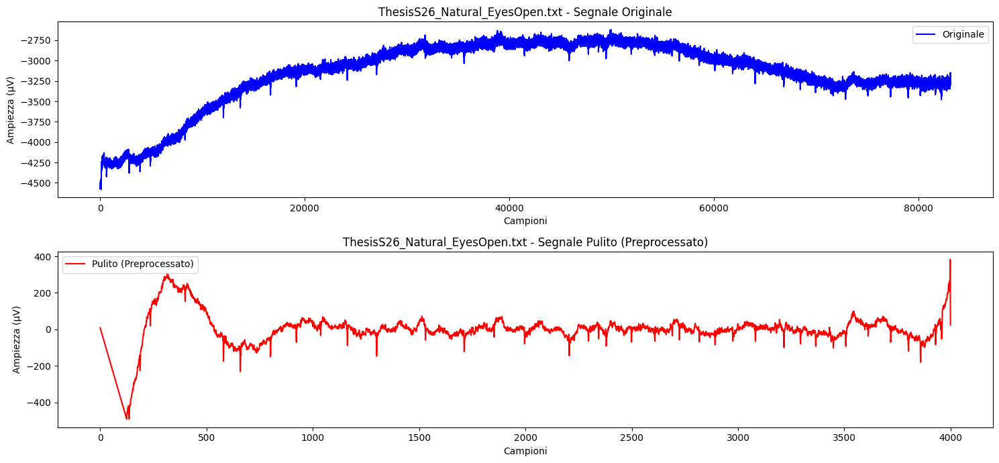

Processando il file: ThesisS18_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3902.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS18_Lab_Math.txt


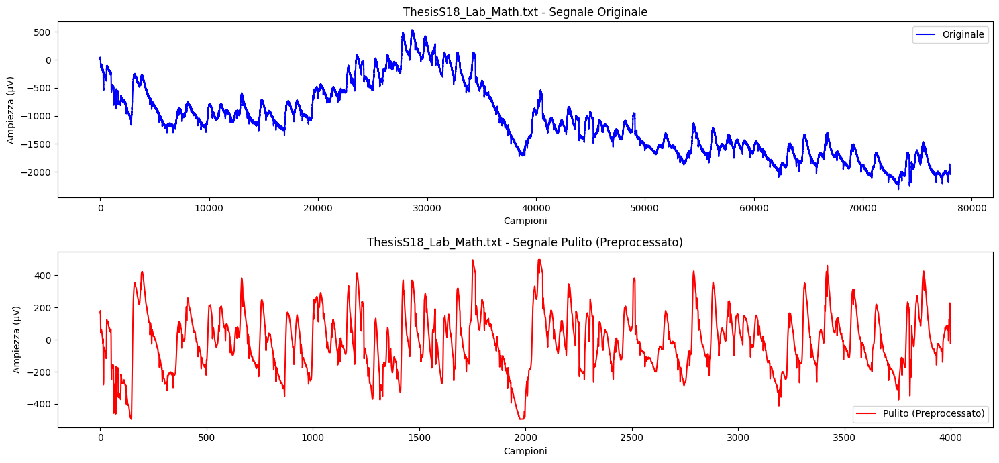

Processando il file: ThesisS5_Lab_Math.txt
Frequenza di campionamento originale calcolata: 4144.45 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS5_Lab_Math.txt


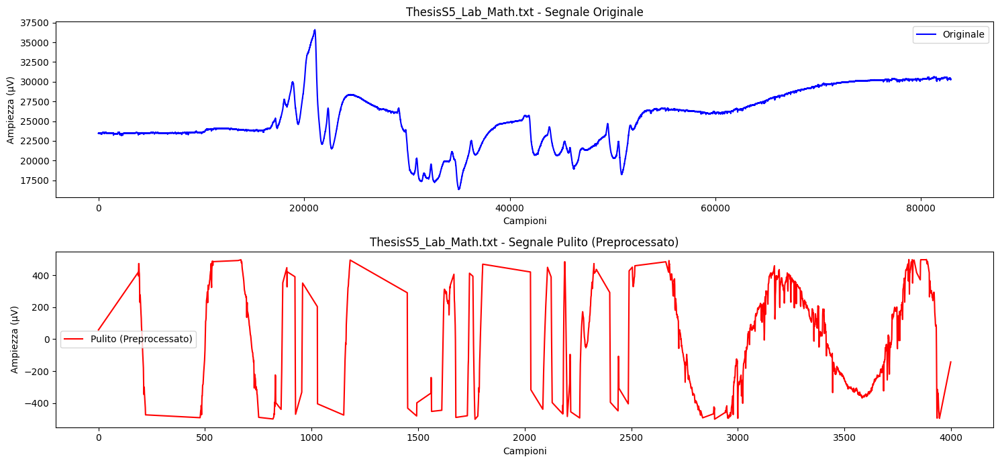

Processando il file: ThesisS12_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3917.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS12_Lab_EyesOpen.txt


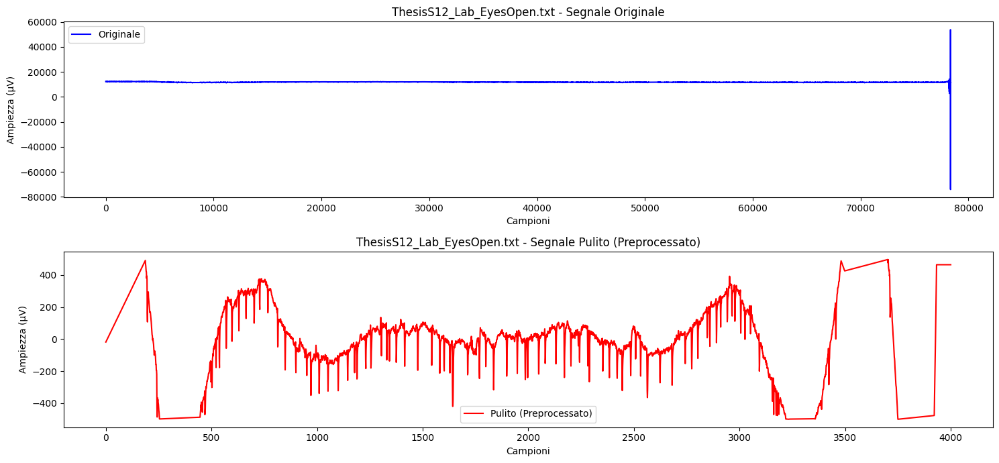

Processando il file: ThesisS14_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3817.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS14_Natural_EyesOpen.txt


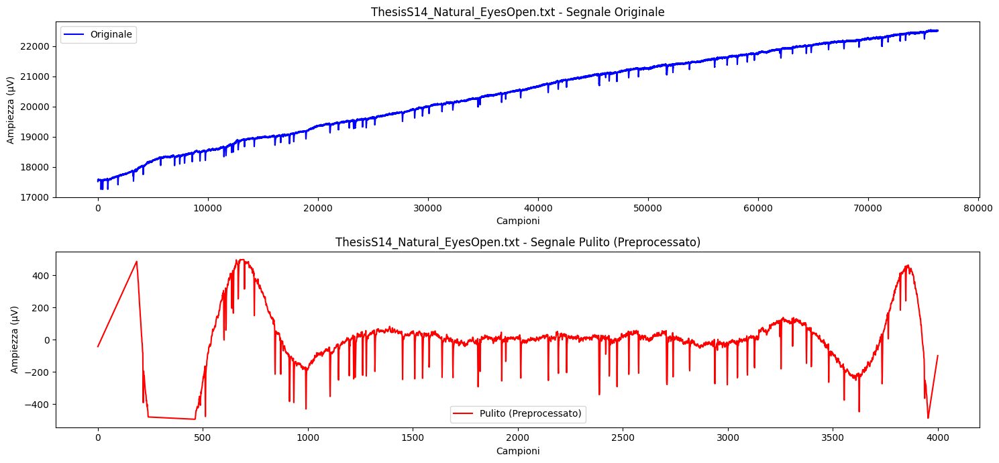

Processando il file: ThesisS18_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 1937.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS18_Lab_EyesClosed.txt


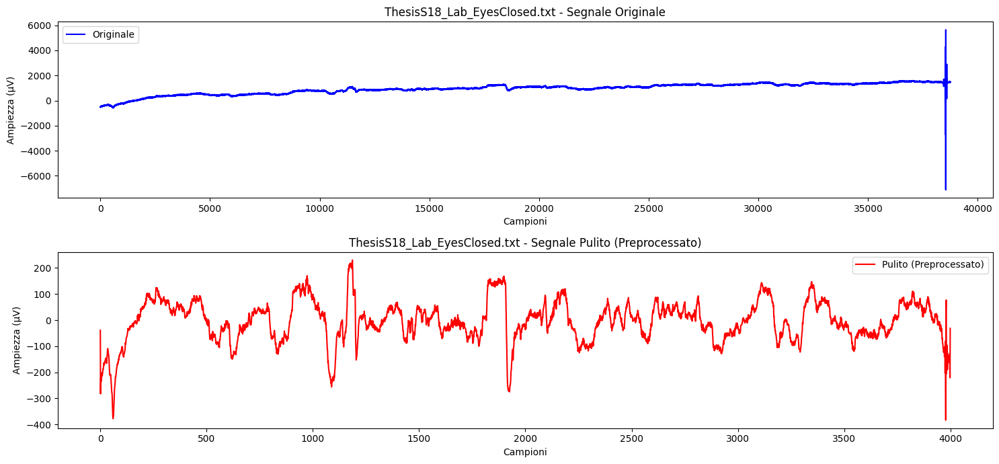

Processando il file: ThesisS24_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4230.65 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS24_Natural_EyesClosed.txt


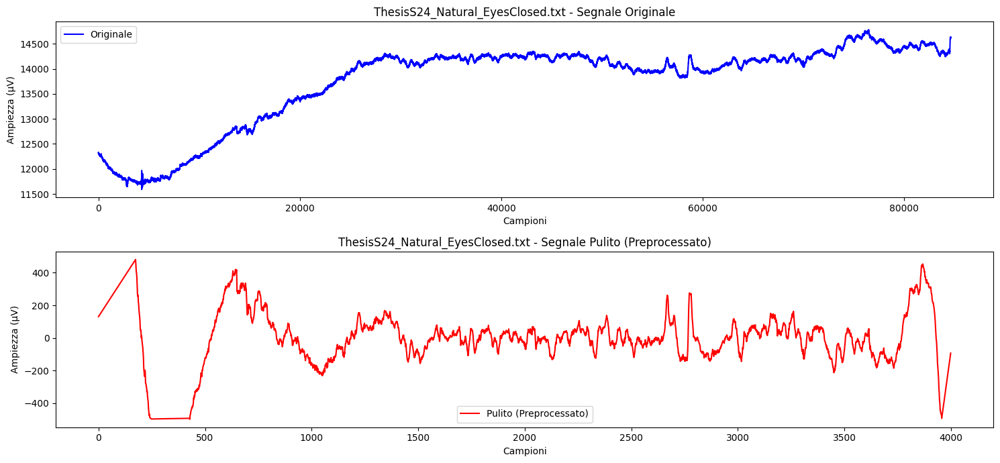

Processando il file: ThesisS9_Lab_Math.txt
Frequenza di campionamento originale calcolata: 4186.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS9_Lab_Math.txt


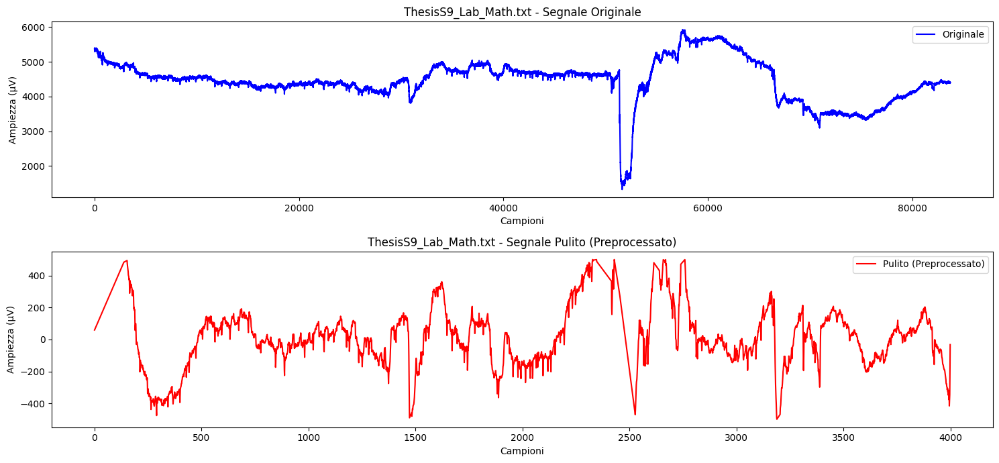

Processando il file: ThesisS16_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3974.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS16_Lab_EyesOpen.txt


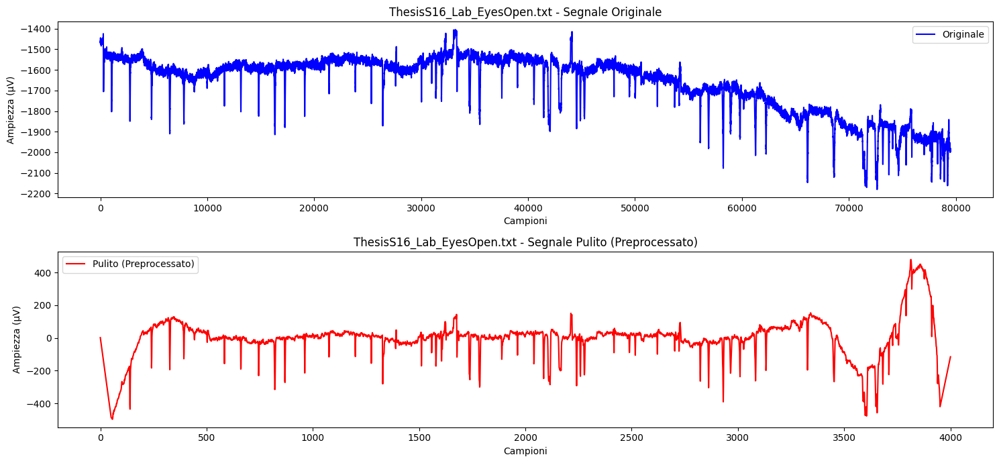

Processando il file: ThesisS8_Lab_Math.txt
Frequenza di campionamento originale calcolata: 5029.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS8_Lab_Math.txt


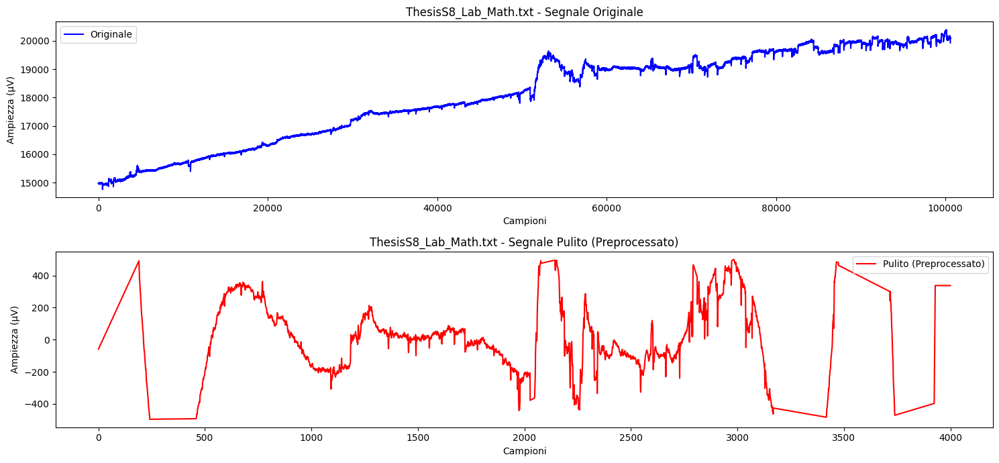

Processando il file: ThesisS18_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3803.45 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS18_Natural_EyesClosed.txt


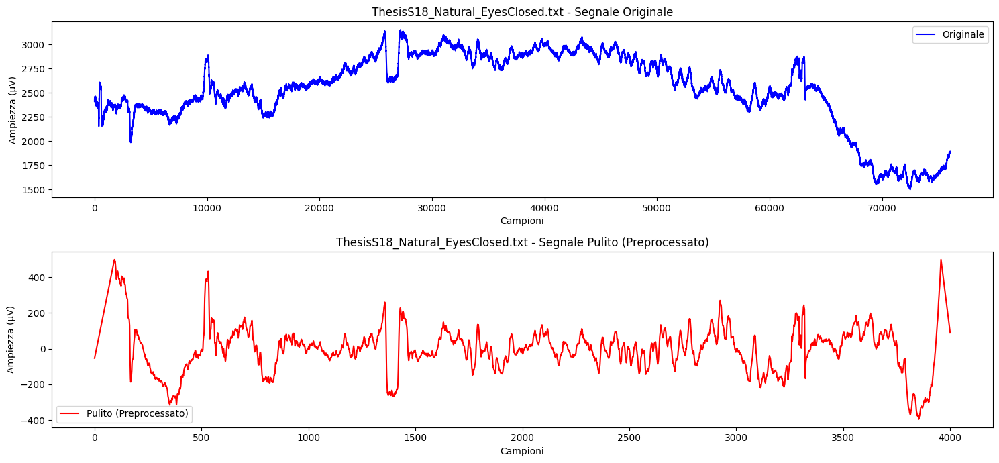

Processando il file: ThesisS21_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3832.05 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS21_Natural_EyesOpen.txt


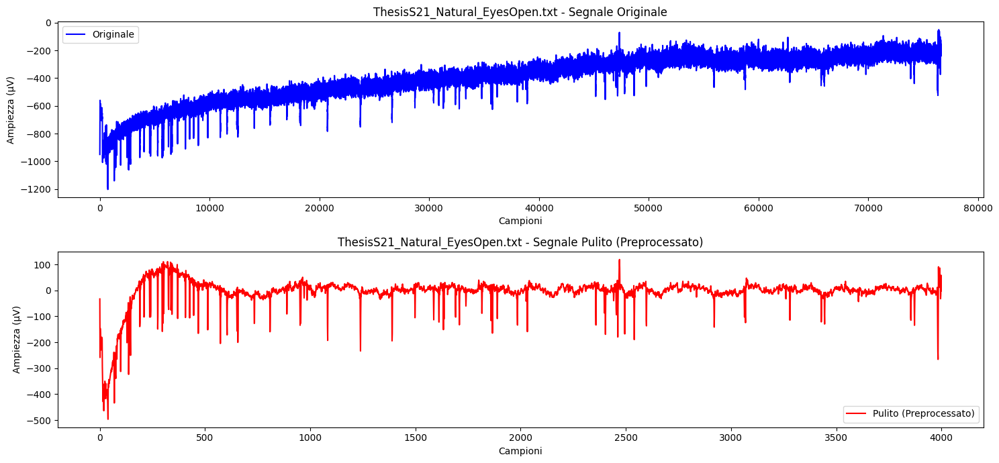

Processando il file: ThesisS23_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3887.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS23_Natural_EyesOpen.txt


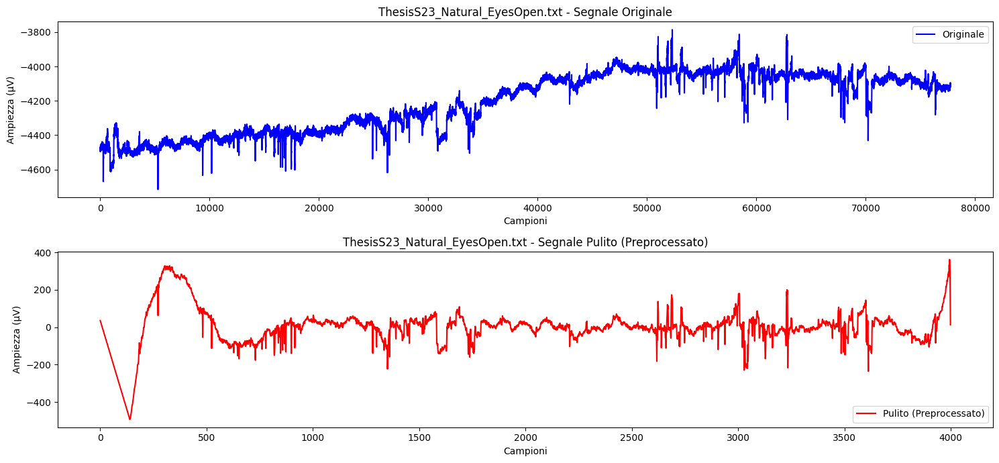

Processando il file: ThesisS21_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4117.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS21_Natural_EyesClosed.txt


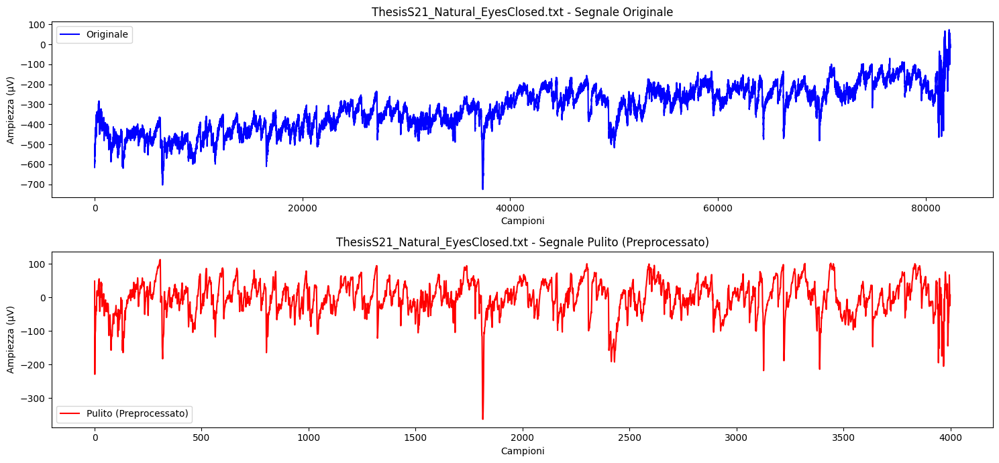

Processando il file: ThesisS20_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3874.95 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS20_Natural_EyesClosed.txt


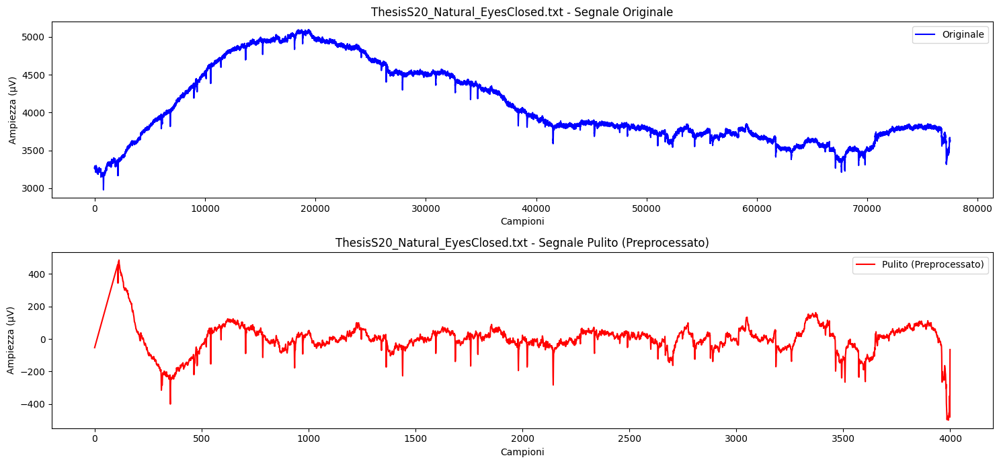

Processando il file: ThesisS21_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 1722.05 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS21_Lab_EyesClosed.txt


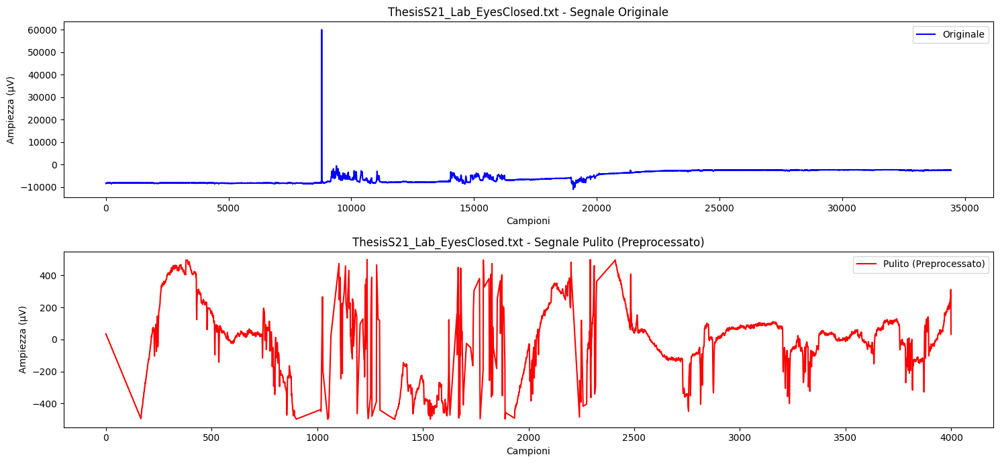

Processando il file: ThesisS22_Lab_Math.txt
Frequenza di campionamento originale calcolata: 715.75 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS22_Lab_Math.txt


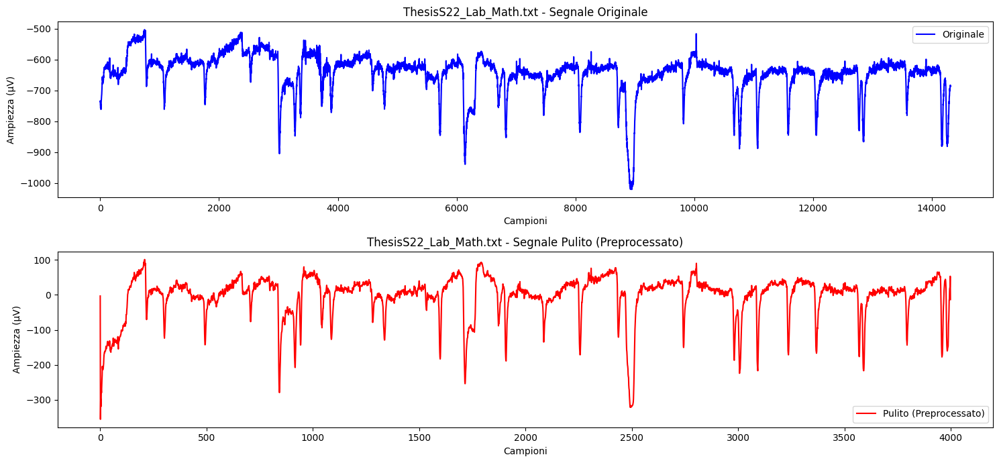

Processando il file: ThesisS11_Natural_Math.txt
Frequenza di campionamento originale calcolata: 2963.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS11_Natural_Math.txt


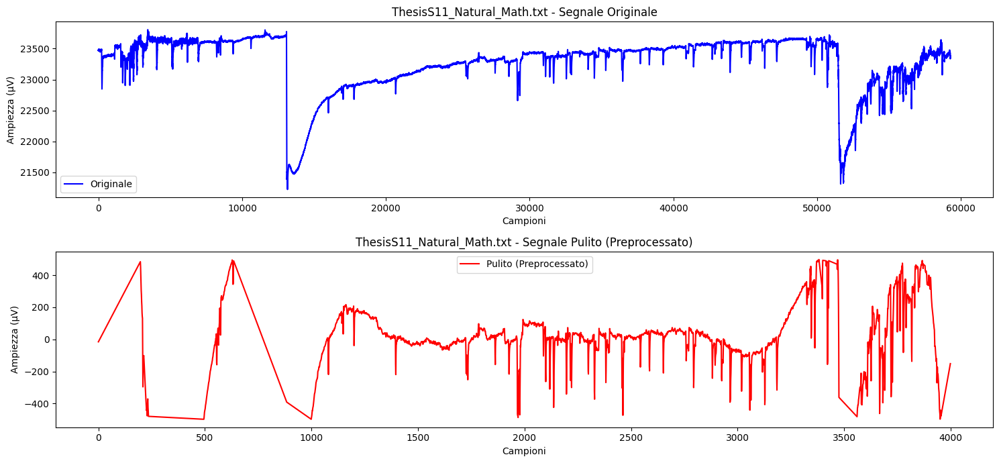

Processando il file: ThesisS11_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3886.9 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS11_Natural_EyesOpen.txt


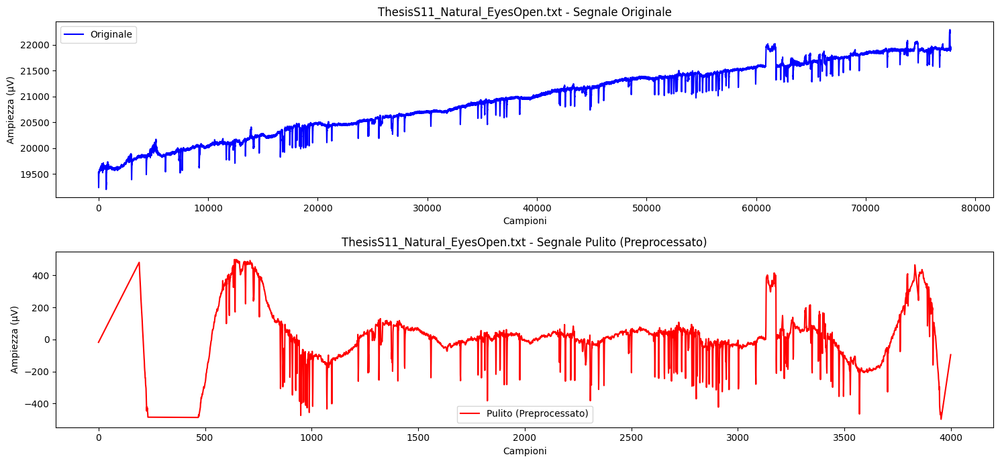

Processando il file: ThesisS8_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4259.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS8_Lab_EyesOpen.txt


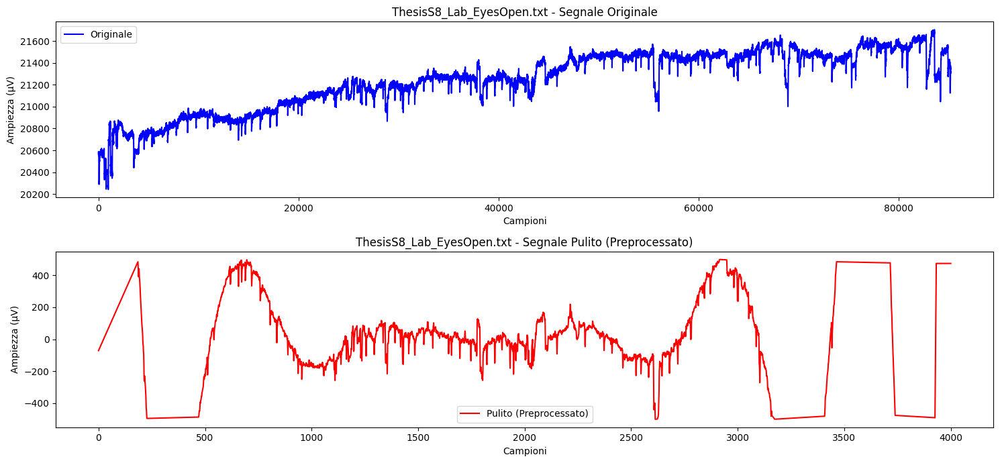

Processando il file: ThesisS19_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3917.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS19_Lab_EyesOpen.txt


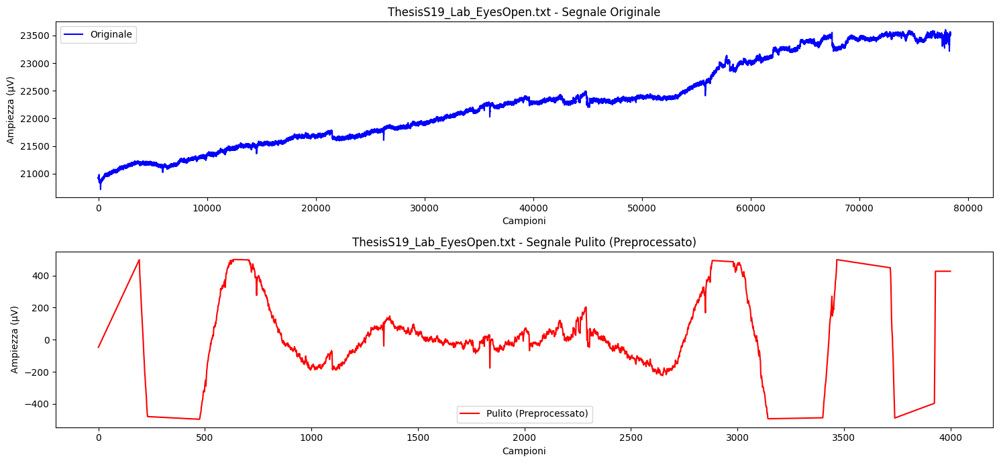

Processando il file: ThesisS14_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3788.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS14_Lab_Math.txt


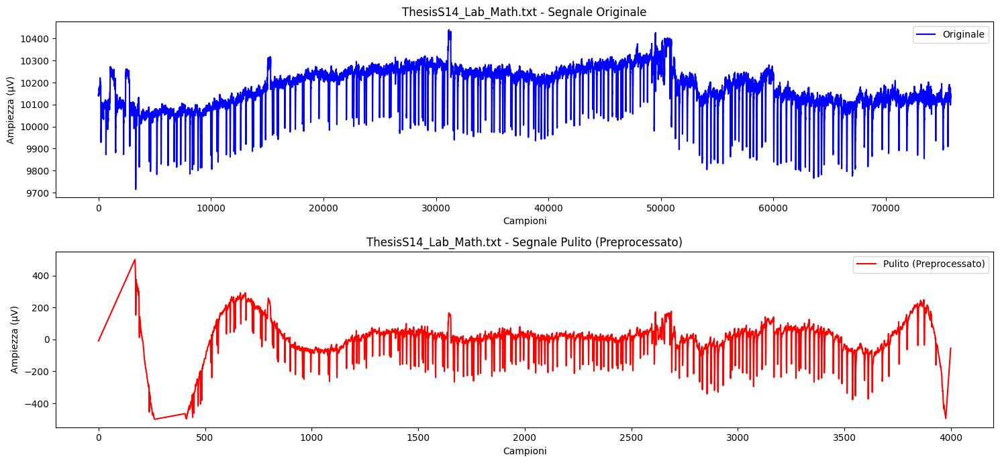

Processando il file: ThesisS24_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3845.7 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS24_Natural_Math.txt


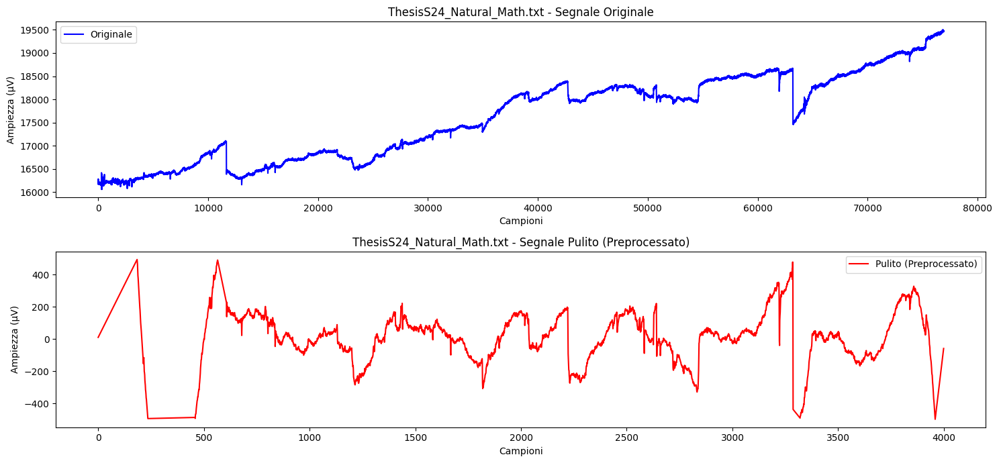

Processando il file: ThesisS13_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4074.6 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS13_Natural_EyesClosed.txt


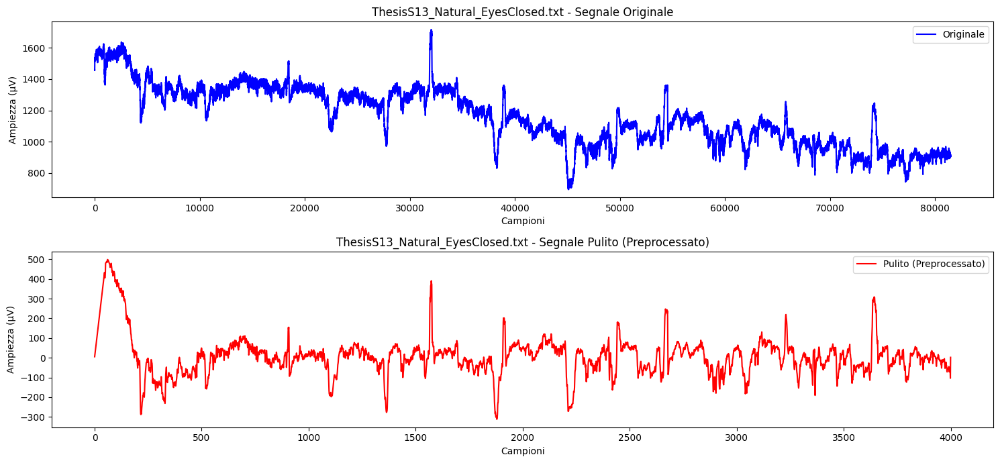

Processando il file: ThesisS6_Lab_Math.txt
Frequenza di campionamento originale calcolata: 4103.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS6_Lab_Math.txt


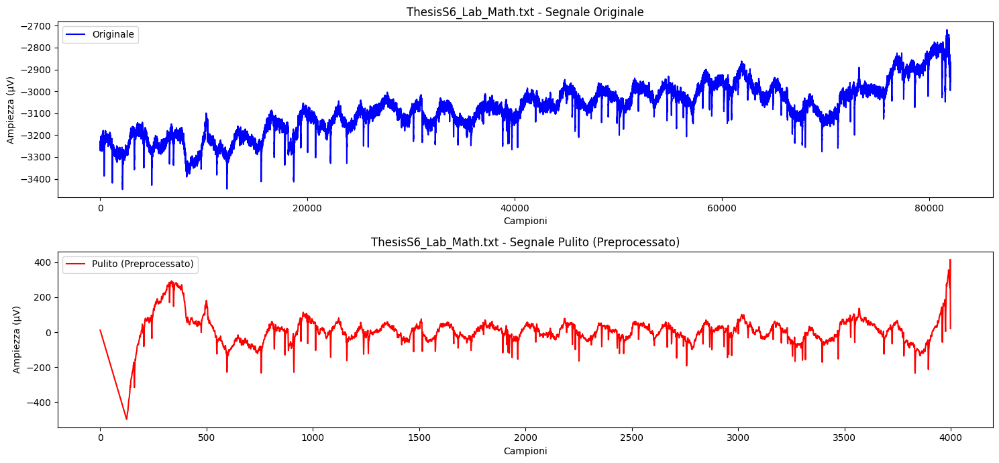

Processando il file: ThesisS7_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS7_Lab_Math.txt


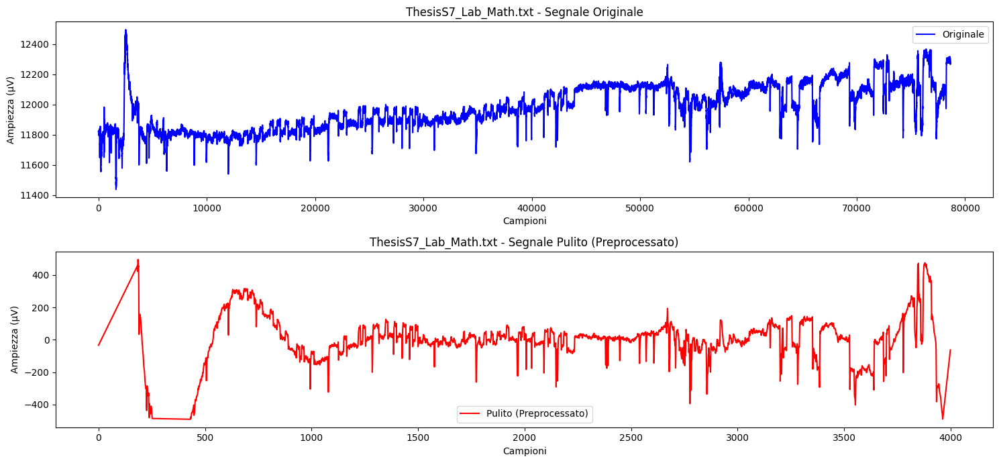

Processando il file: ThesisS22_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS22_Lab_EyesClosed.txt


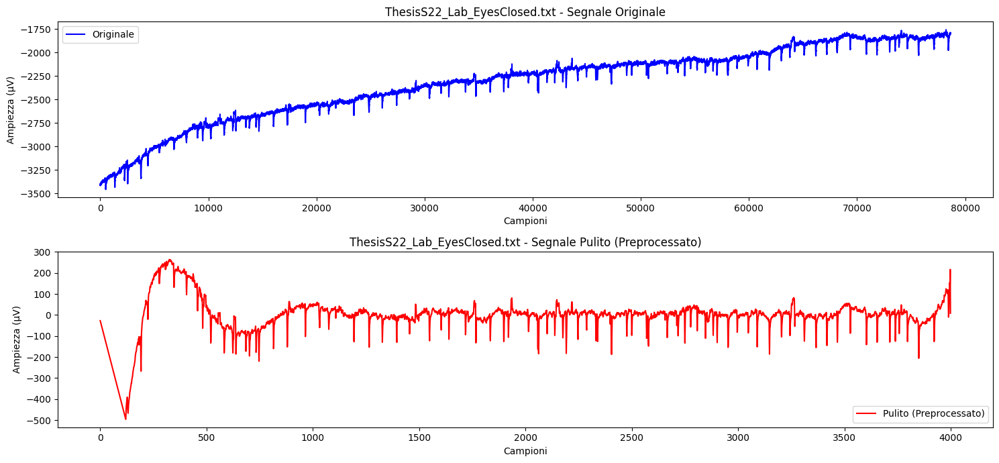

Processando il file: ThesisS20_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3745.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS20_Natural_Math.txt


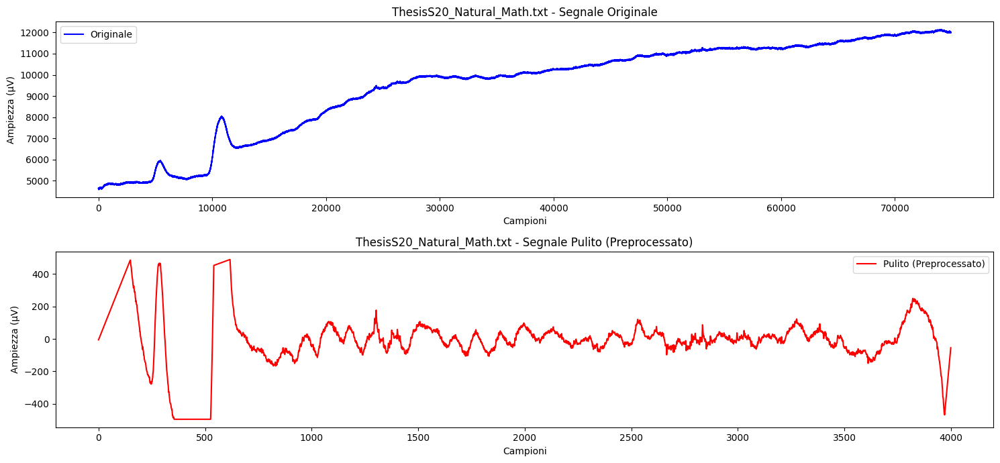

Processando il file: ThesisS6_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3946.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS6_Natural_EyesClosed.txt


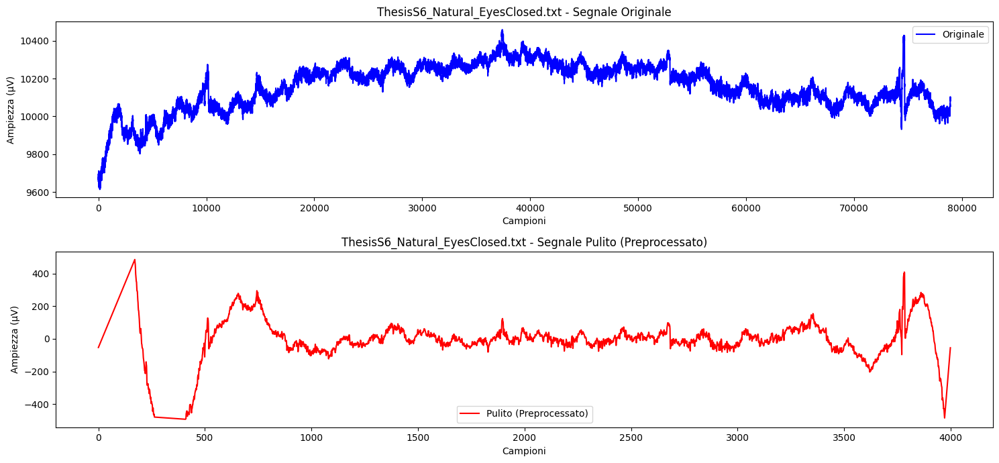

Processando il file: ThesisS26_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3831.7 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS26_Natural_EyesClosed.txt


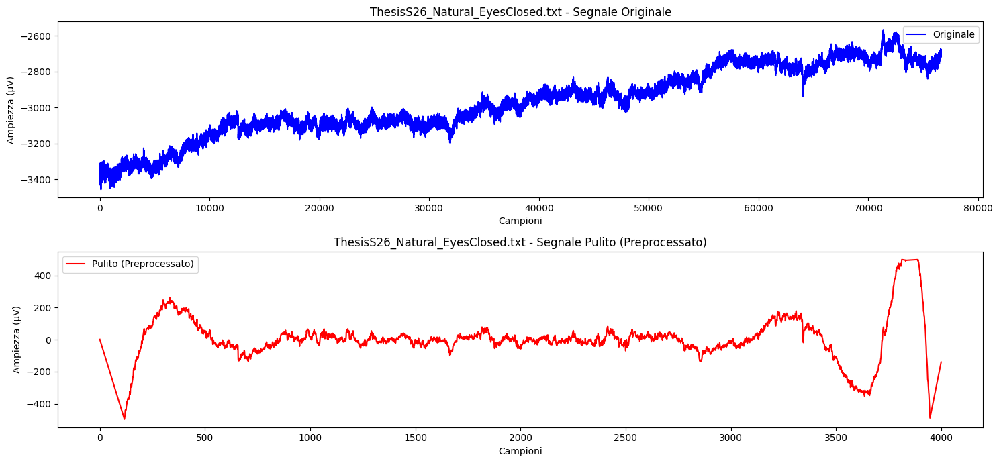

Processando il file: ThesisS23_Lab_Math.txt
Frequenza di campionamento originale calcolata: 4003.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS23_Lab_Math.txt


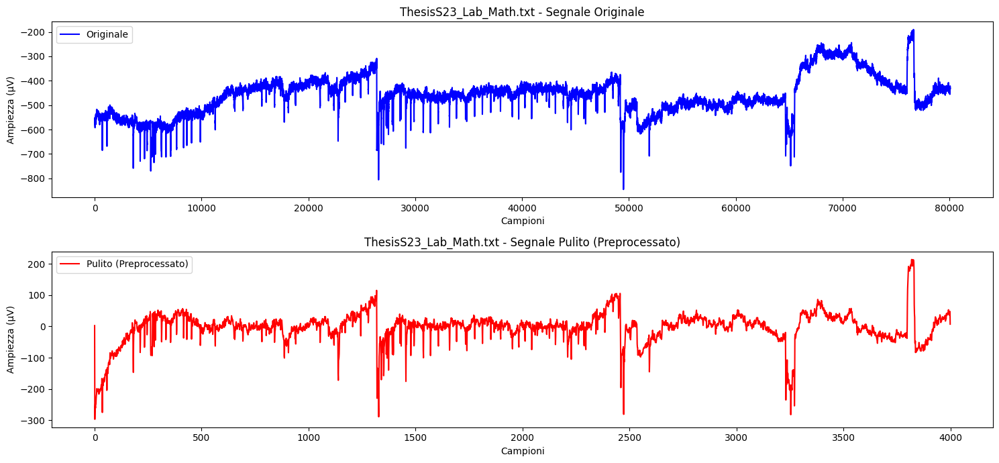

Processando il file: ThesisS13_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS13_Natural_Math.txt


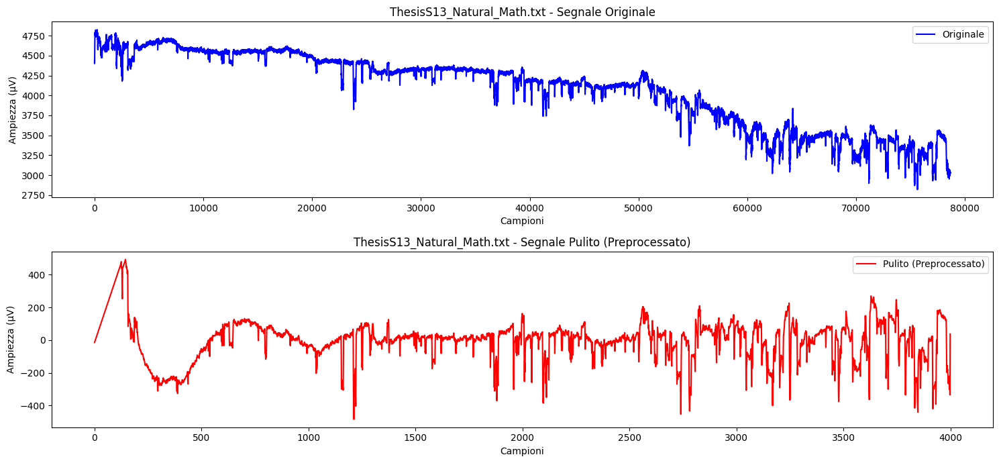

Processando il file: ThesisS13_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3888.4 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS13_Lab_EyesOpen.txt


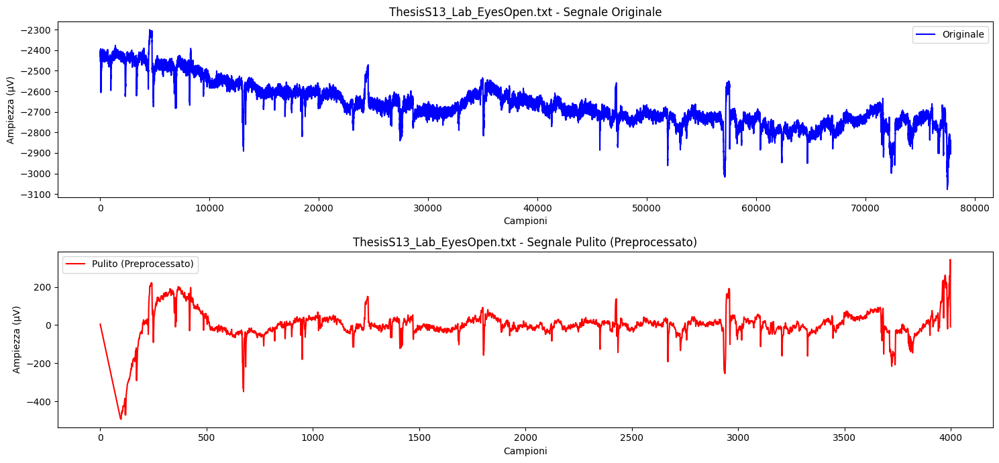

Processando il file: ThesisS17_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3888.95 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS17_Lab_EyesClosed.txt


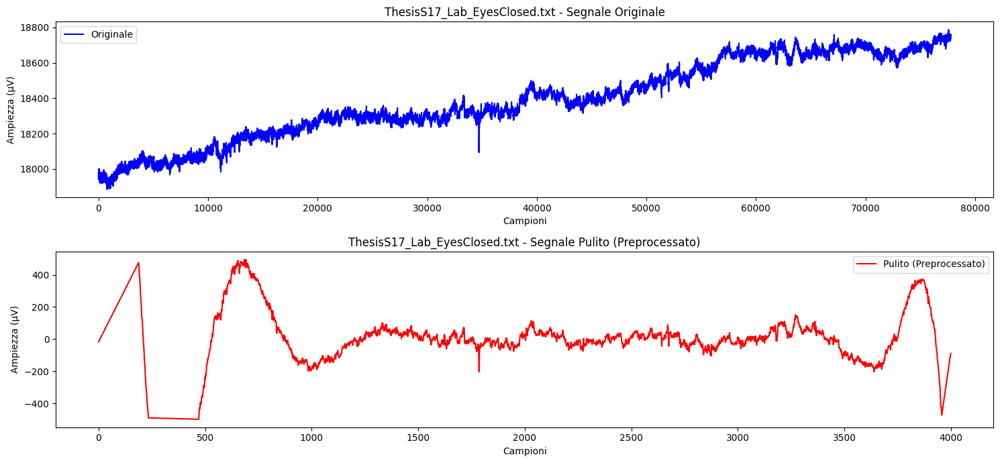

Processando il file: ThesisS17_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3205.55 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS17_Natural_EyesClosed.txt


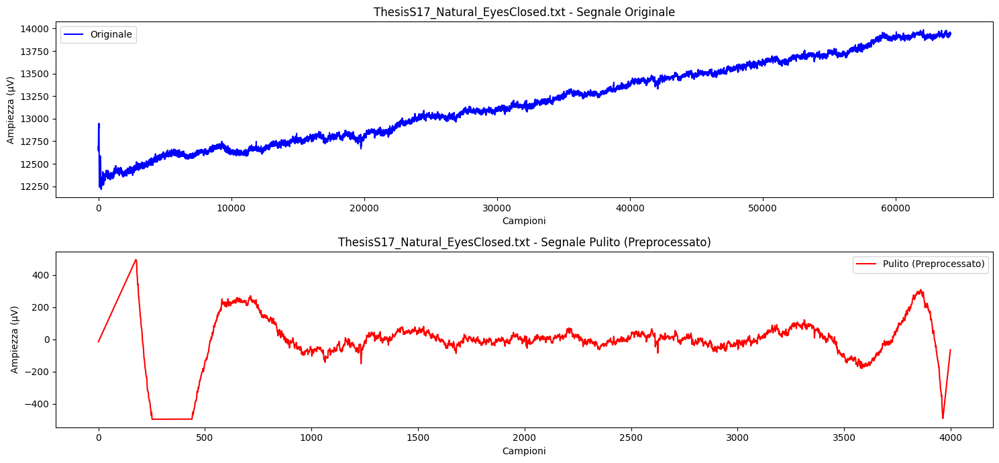

Processando il file: ThesisS6_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3718.4 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS6_Lab_EyesClosed.txt


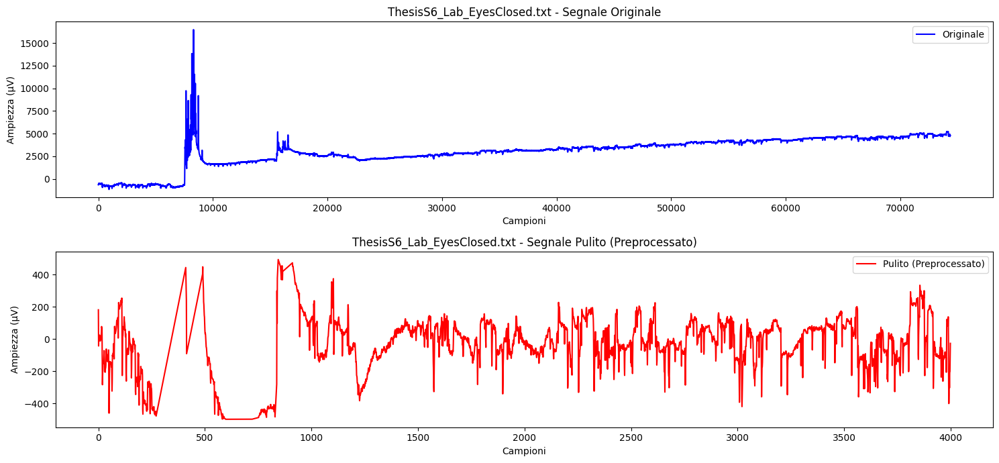

Processando il file: ThesisS23_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 4272.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS23_Natural_EyesClosed.txt


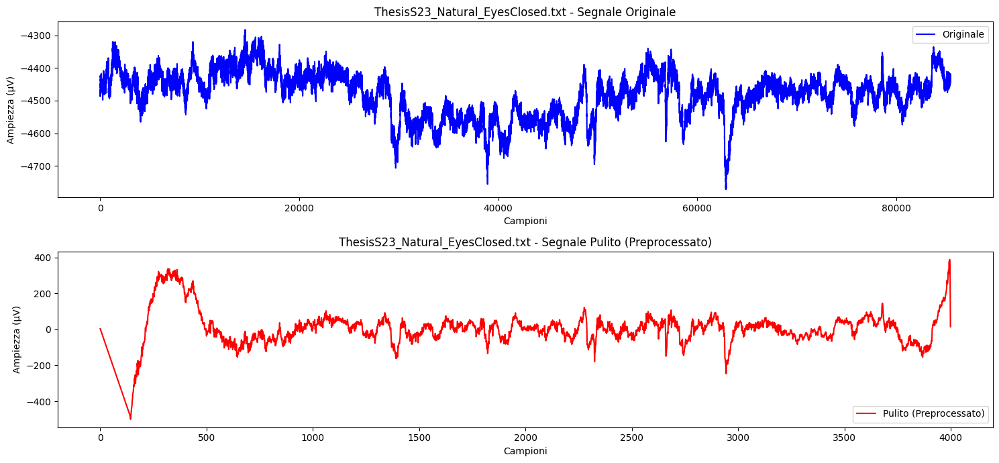

Processando il file: ThesisS23_Natural_Math.txt
Frequenza di campionamento originale calcolata: 2521.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS23_Natural_Math.txt


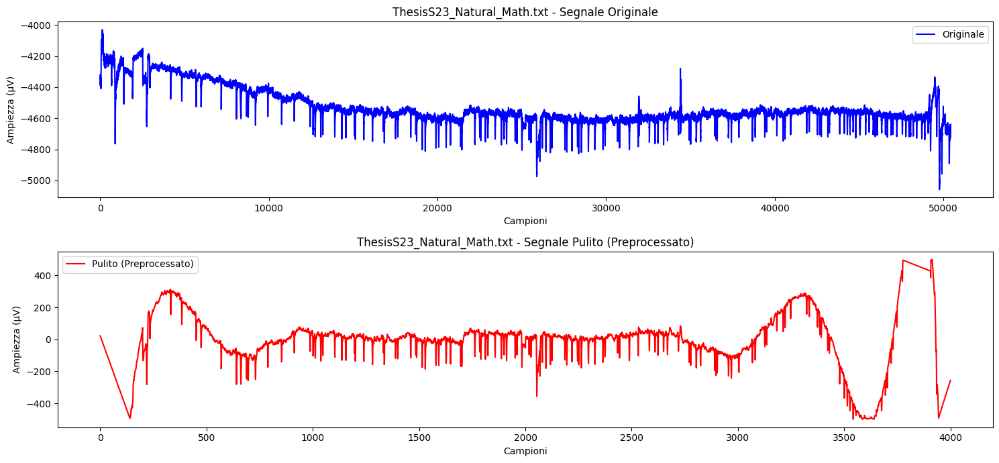

Processando il file: ThesisS3_Lab_Math.txt
Frequenza di campionamento originale calcolata: 2947.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS3_Lab_Math.txt


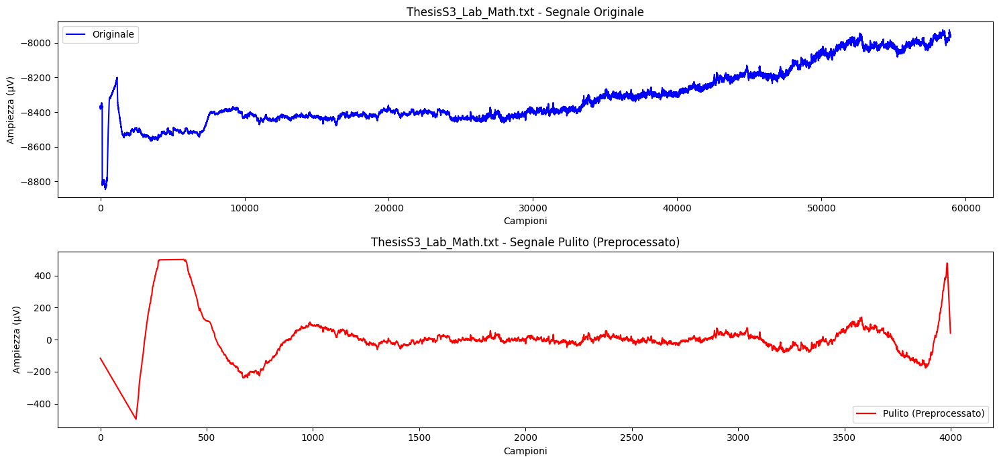

Processando il file: ThesisS20_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3873.65 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS20_Lab_Math.txt


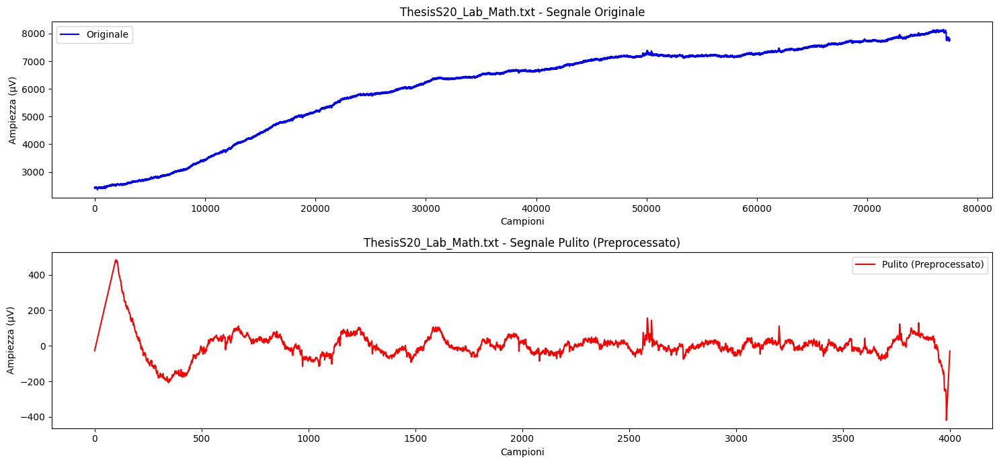

Processando il file: ThesisS5_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3874.15 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS5_Lab_EyesOpen.txt


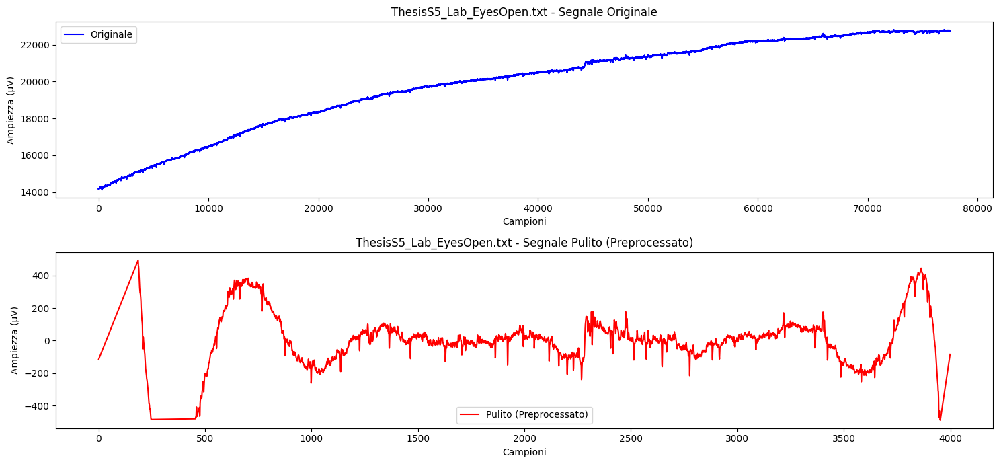

Processando il file: ThesisS3_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3541.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS3_Natural_Math.txt


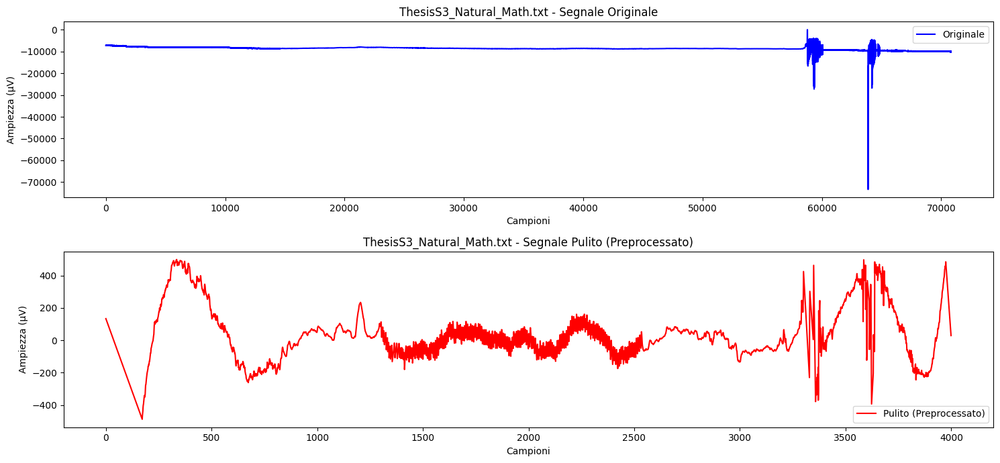

Processando il file: ThesisS7_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3845.4 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS7_Lab_EyesOpen.txt


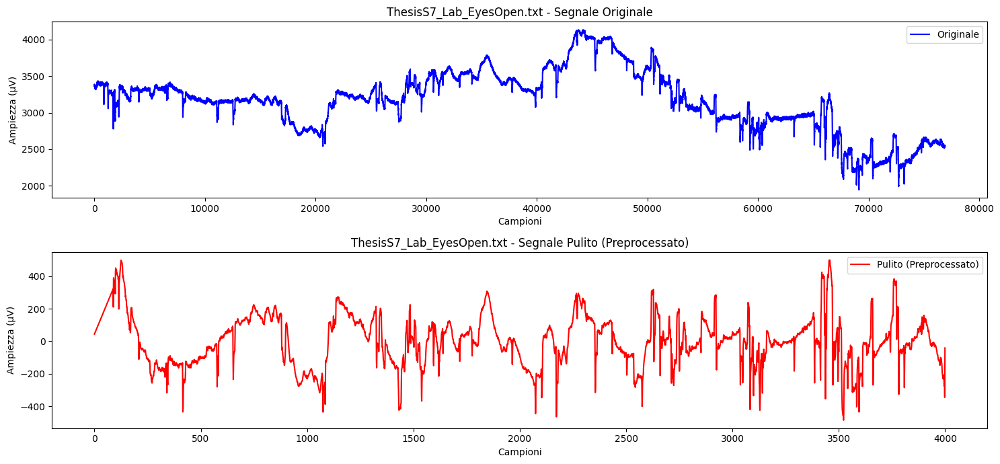

Processando il file: ThesisS8_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 2222.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS8_Natural_EyesClosed.txt


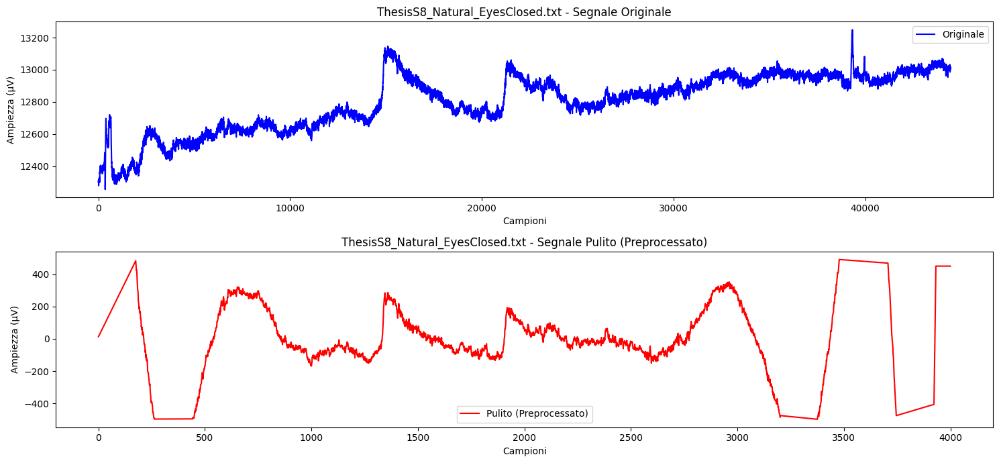

Processando il file: ThesisS13_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3787.8 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS13_Natural_EyesOpen.txt


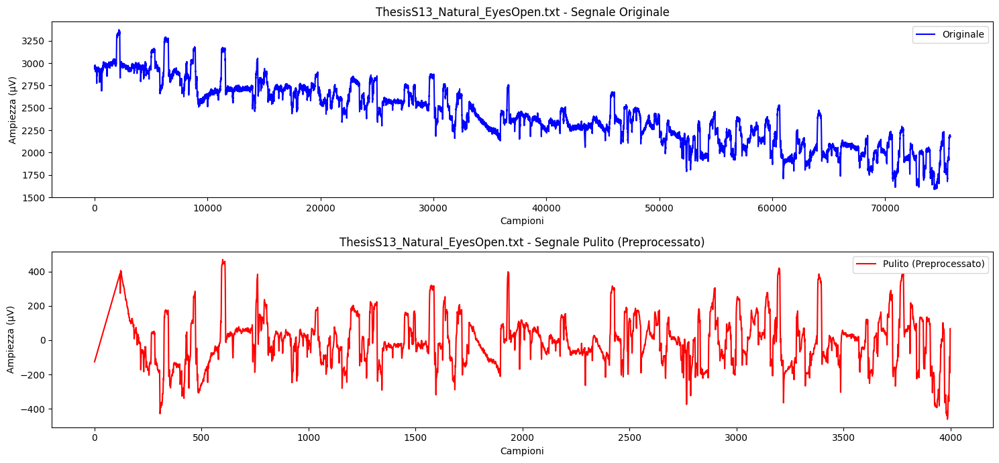

Processando il file: ThesisS5_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3902.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS5_Lab_EyesClosed.txt


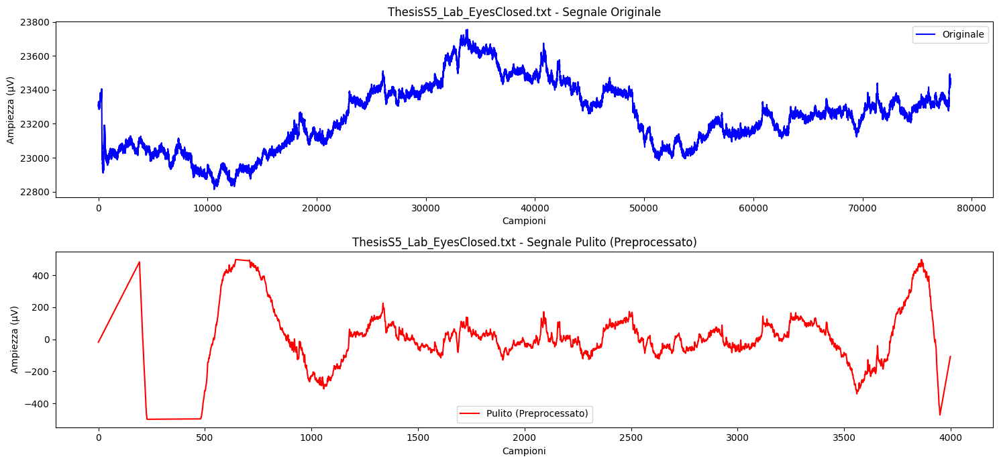

Processando il file: ThesisS26_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3872.9 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS26_Lab_Math.txt


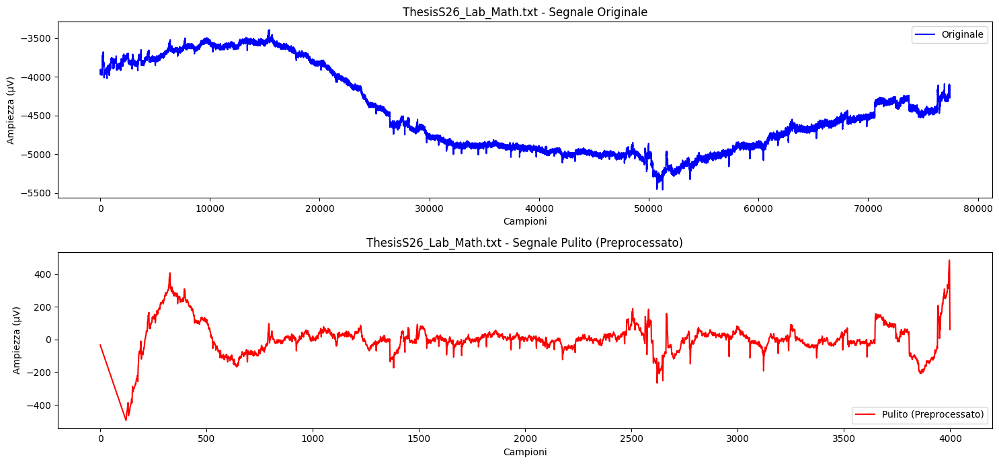

Processando il file: ThesisS12_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4074.6 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS12_Natural_EyesOpen.txt


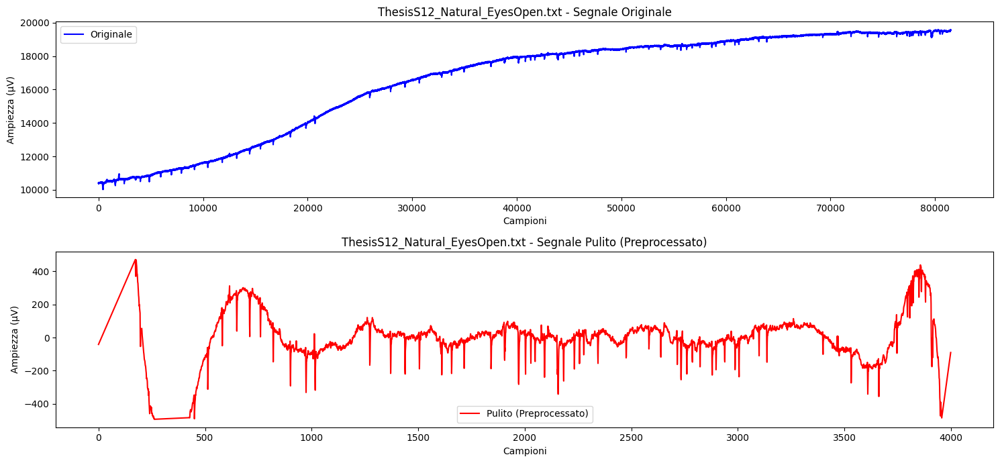

Processando il file: ThesisS6_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4387.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS6_Natural_EyesOpen.txt


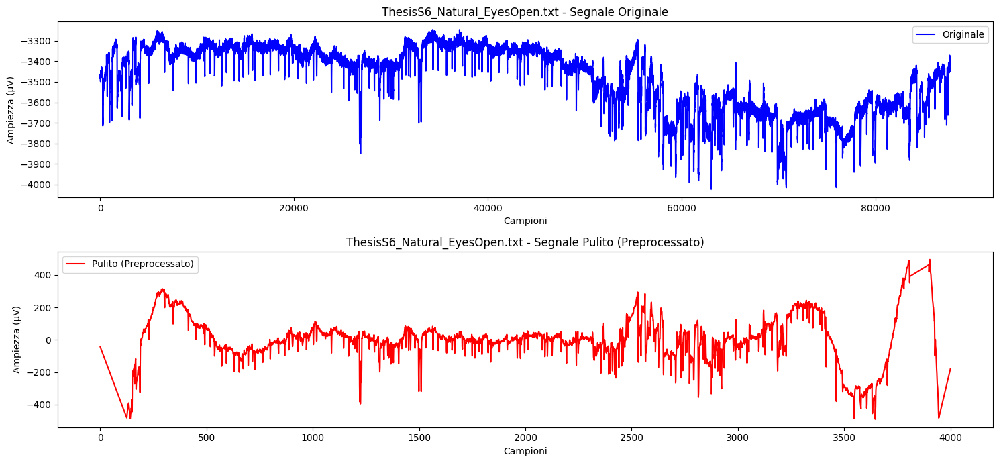

Processando il file: ThesisS12_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 2506.4 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS12_Natural_EyesClosed.txt


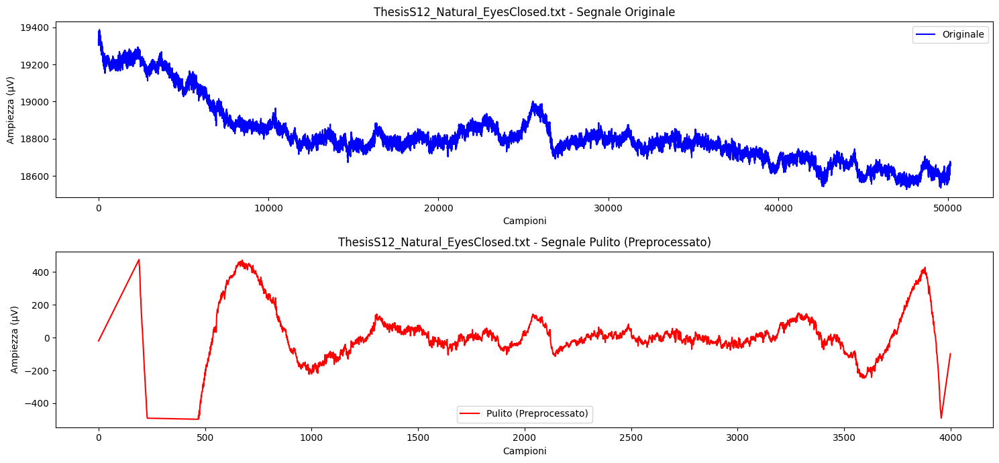

Processando il file: ThesisS26_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3932.3 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS26_Natural_Math.txt


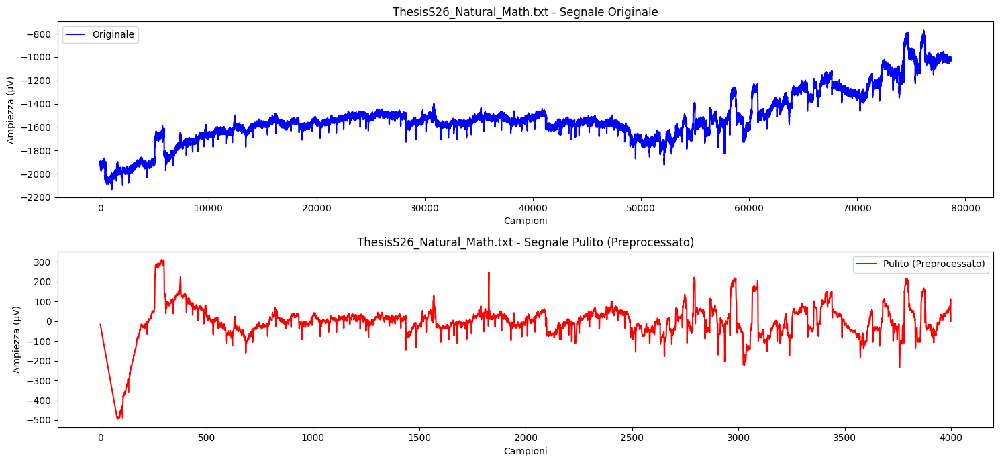

Processando il file: ThesisS18_Natural_Math.txt
Frequenza di campionamento originale calcolata: 4017.6 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS18_Natural_Math.txt


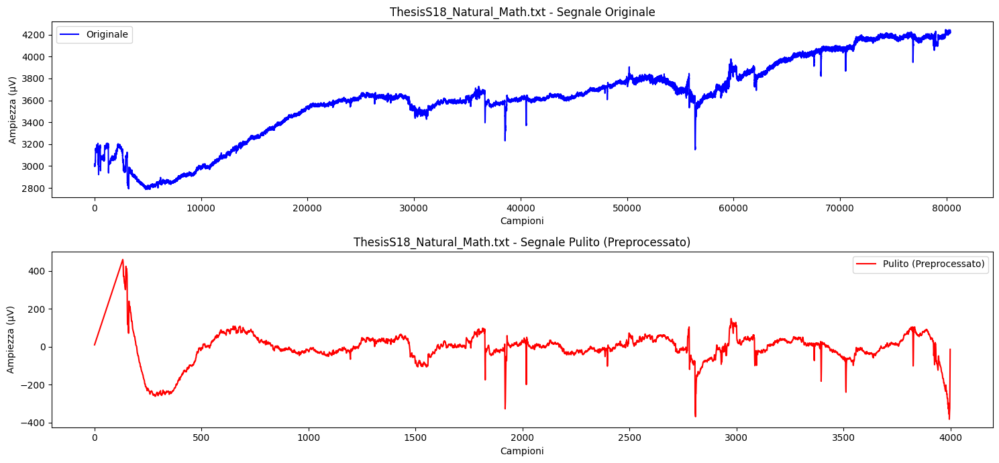

Processando il file: ThesisS23_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3946.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS23_Lab_EyesClosed.txt


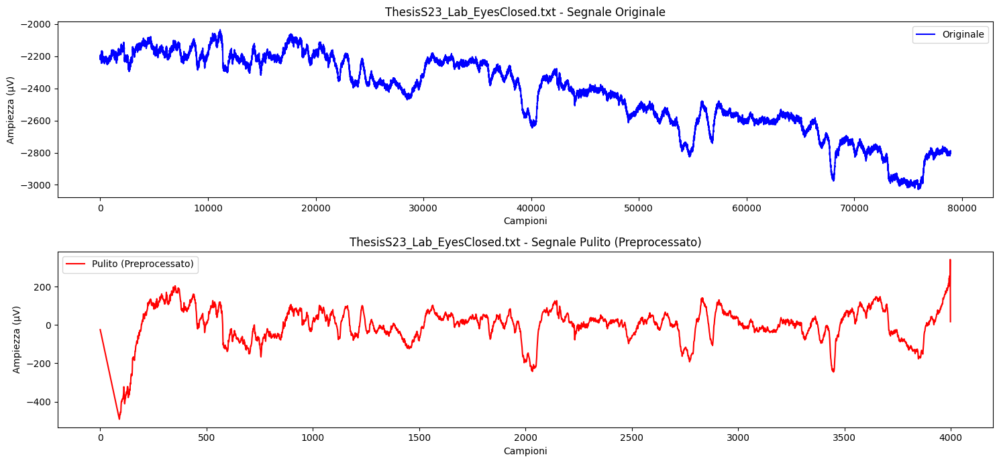

Processando il file: ThesisS21_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3862.65 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS21_Lab_Math.txt


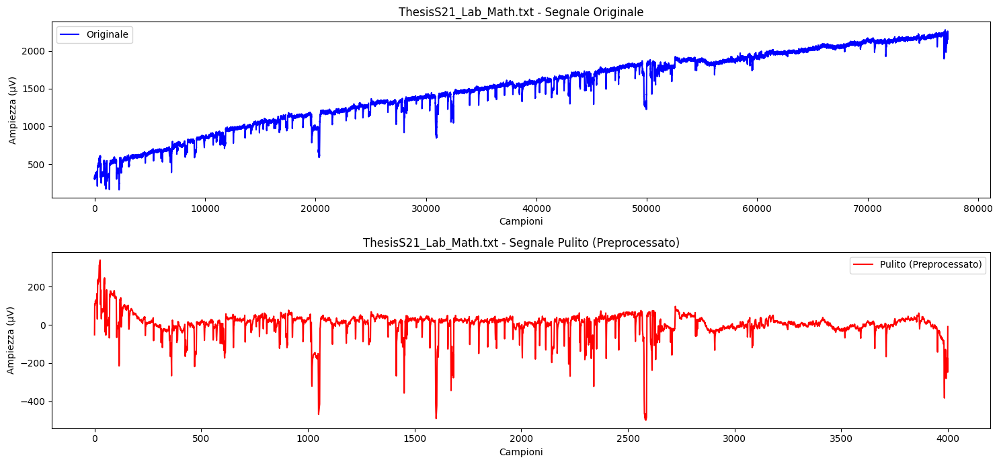

Processando il file: ThesisS11_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3845.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS11_Natural_EyesClosed.txt


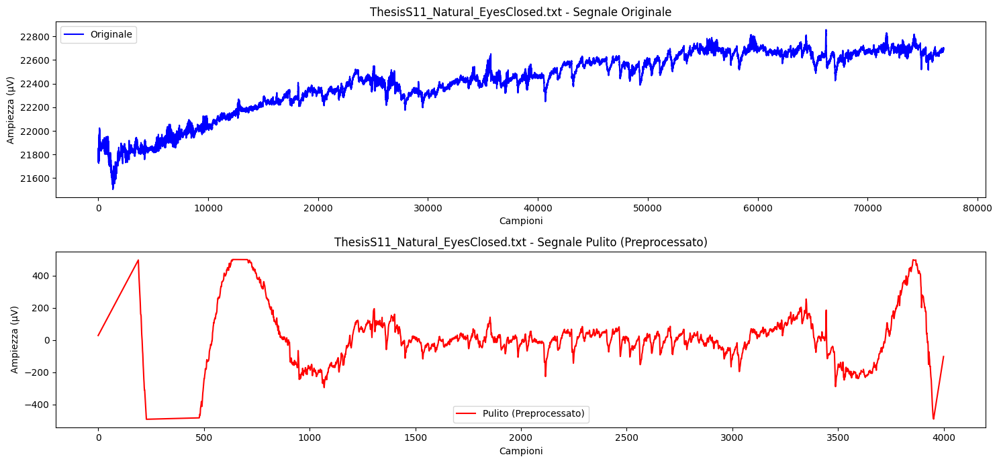

Processando il file: ThesisS12_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3974.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS12_Lab_EyesClosed.txt


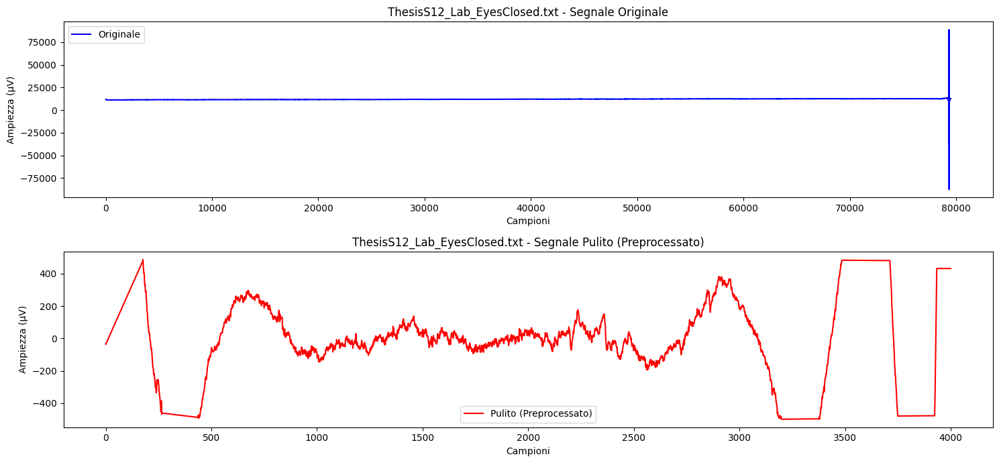

Processando il file: ThesisS12_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3817.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS12_Natural_Math.txt


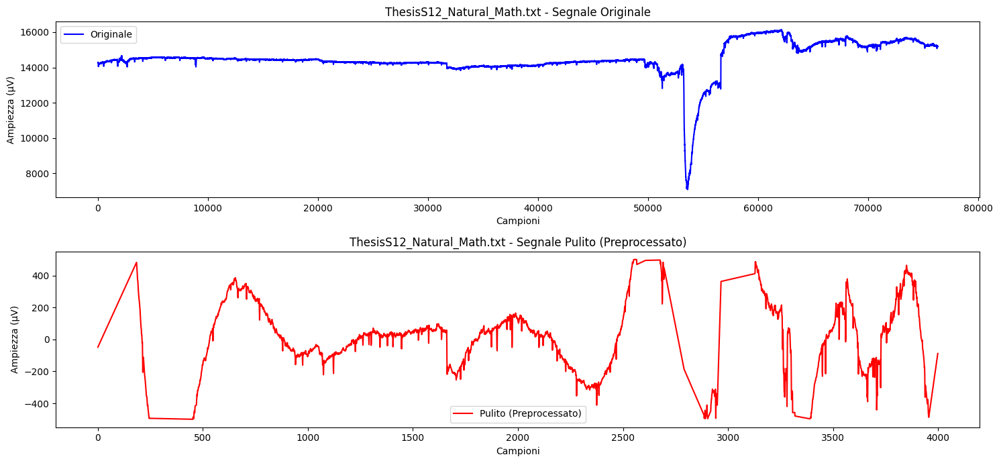

Processando il file: ThesisS19_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3616.9 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS19_Natural_EyesClosed.txt


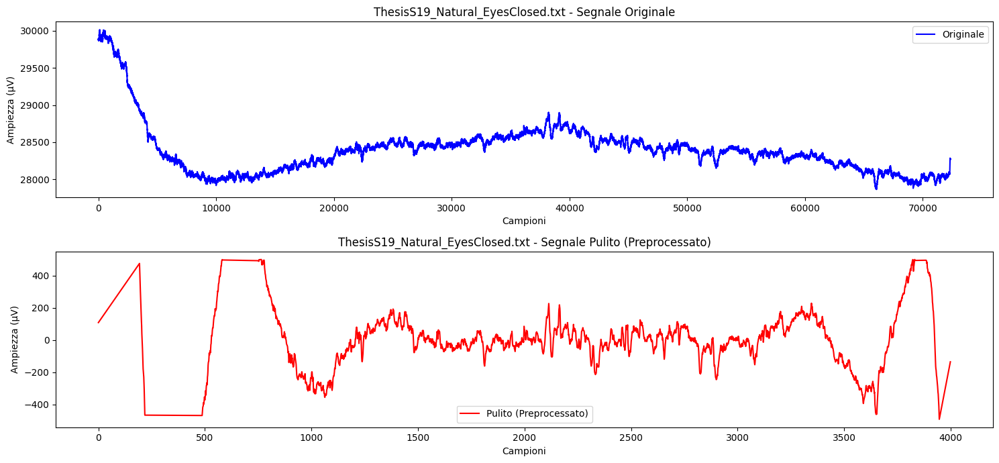

Processando il file: ThesisS17_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3946.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS17_Lab_EyesOpen.txt


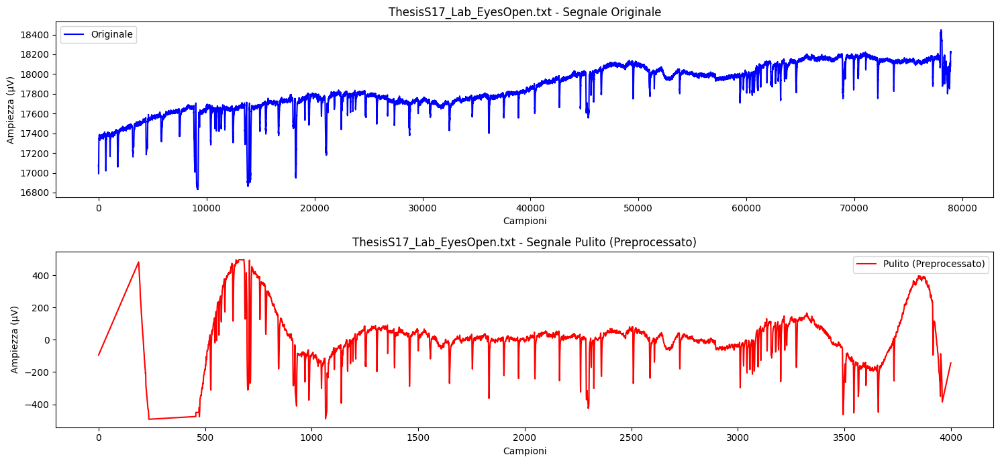

Processando il file: ThesisS16_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3831.55 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS16_Natural_EyesClosed.txt


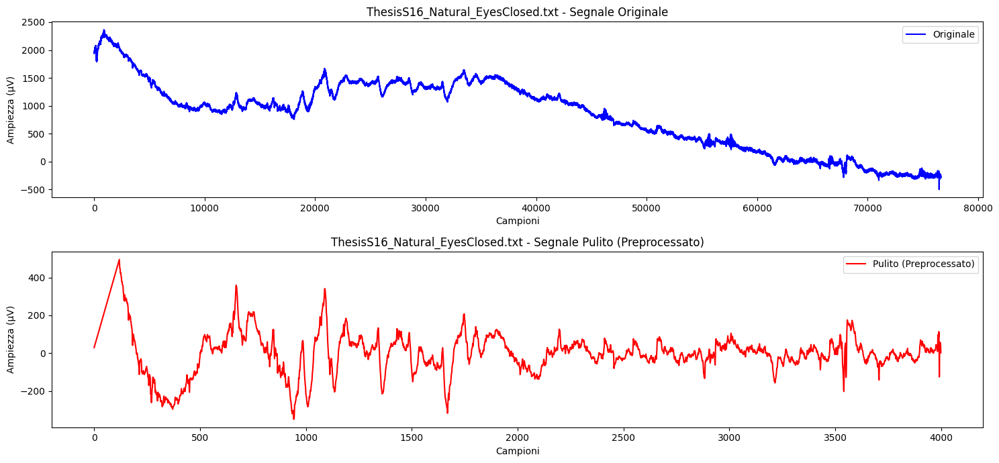

Processando il file: ThesisS10_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3787.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS10_Natural_EyesClosed.txt


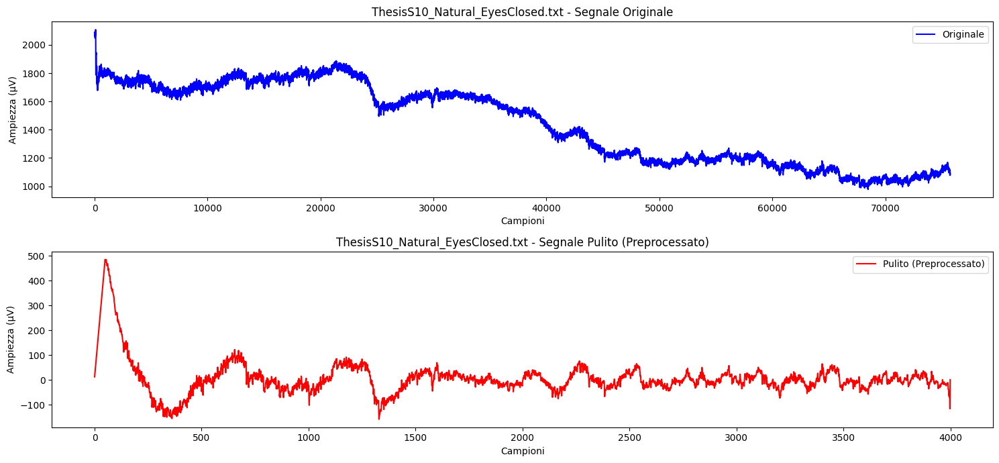

Processando il file: ThesisS7_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3789.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS7_Natural_EyesOpen.txt


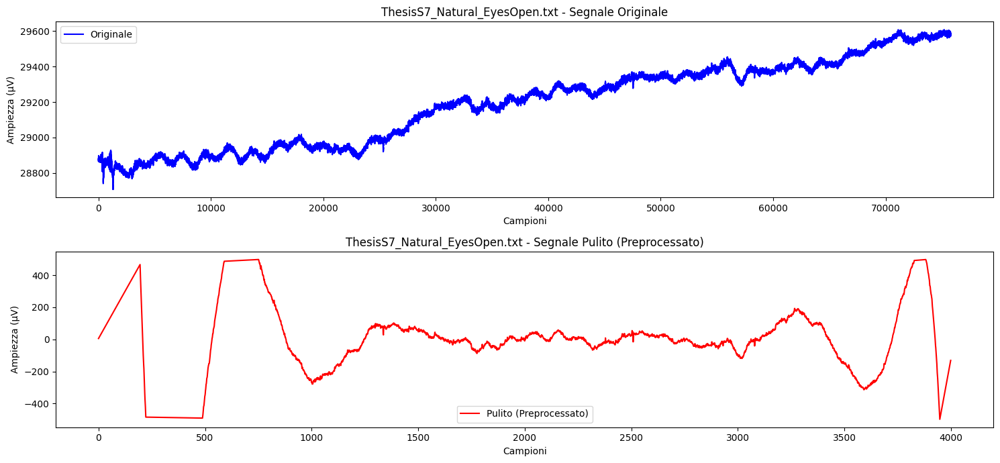

Processando il file: ThesisS16_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3844.75 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS16_Lab_Math.txt


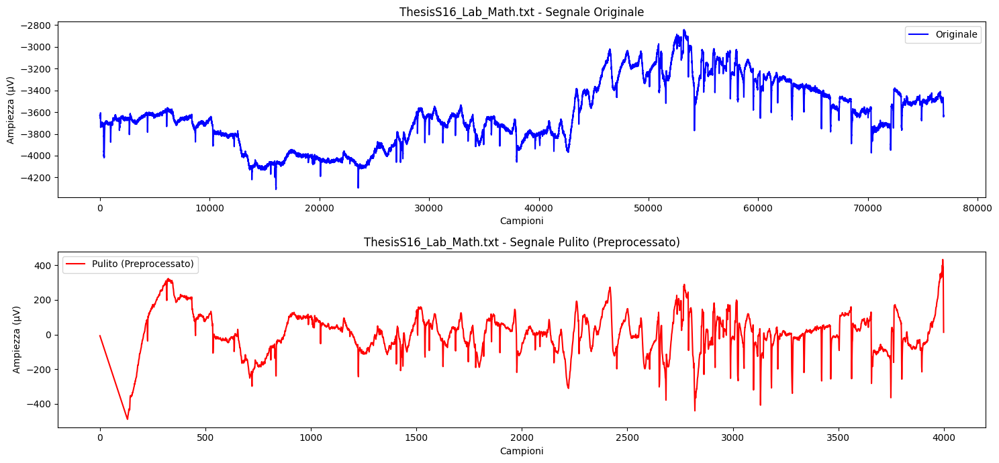

Processando il file: ThesisS10_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3873.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS10_Lab_Math.txt


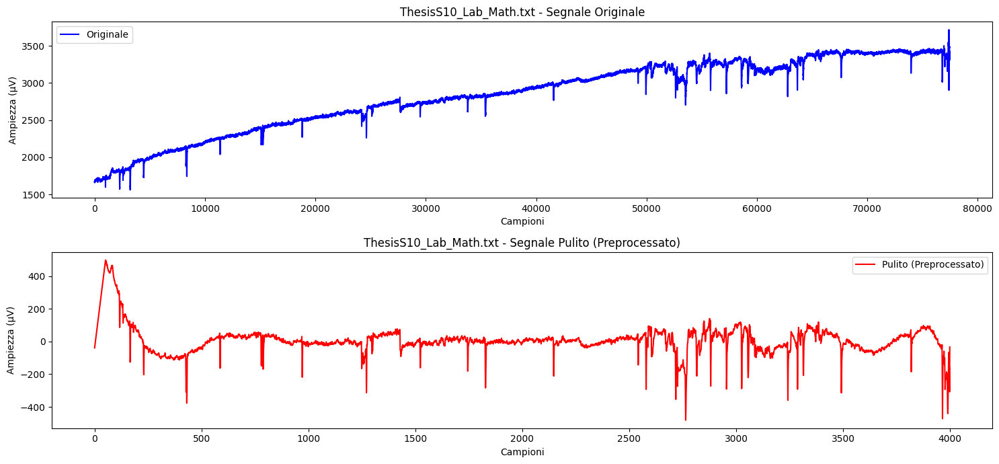

Processando il file: ThesisS20_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3817.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS20_Lab_EyesOpen.txt


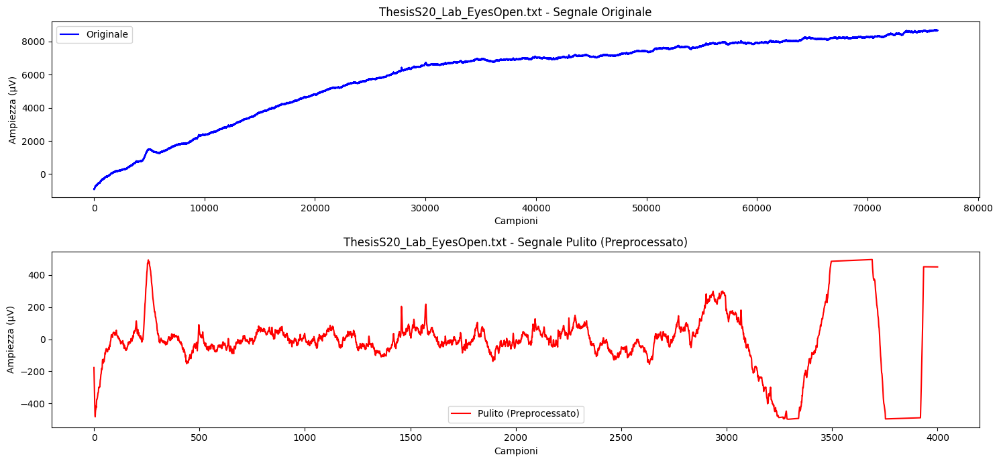

Processando il file: ThesisS14_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3788.65 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS14_Natural_Math.txt


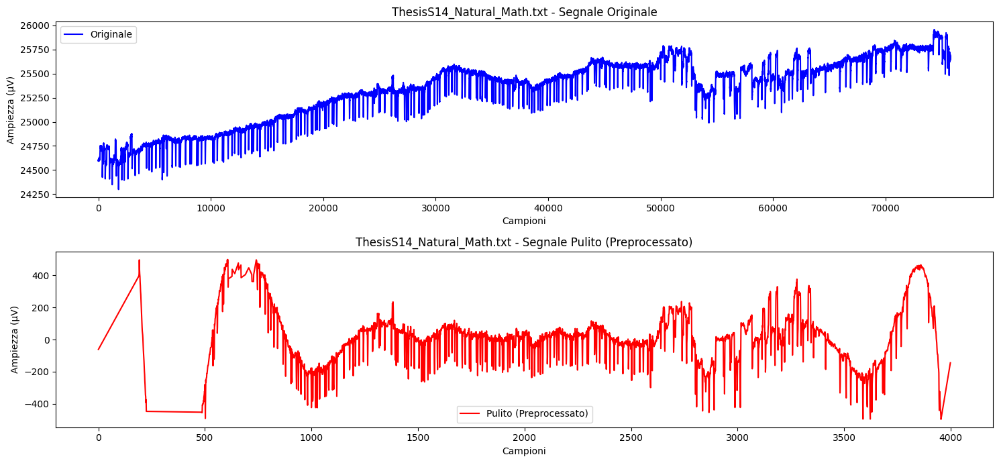

Processando il file: ThesisS19_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3888.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS19_Lab_EyesClosed.txt


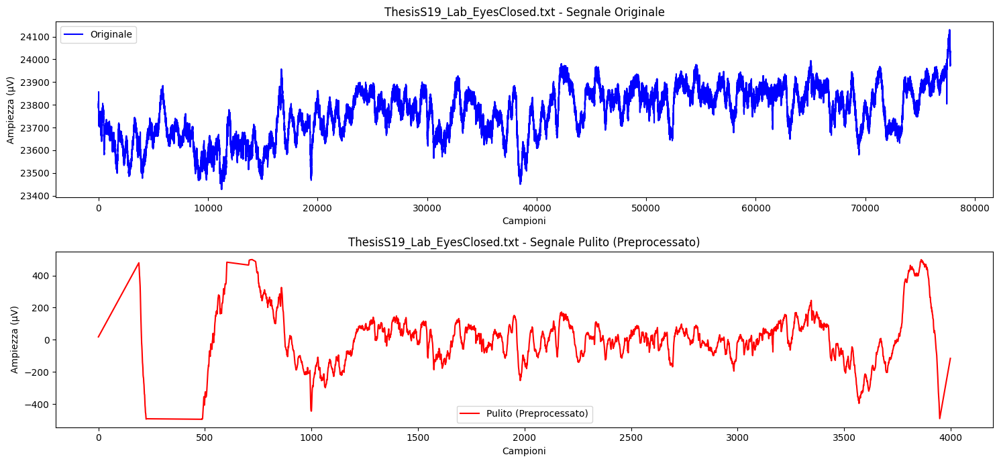

Processando il file: ThesisS10_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3946.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS10_Natural_Math.txt


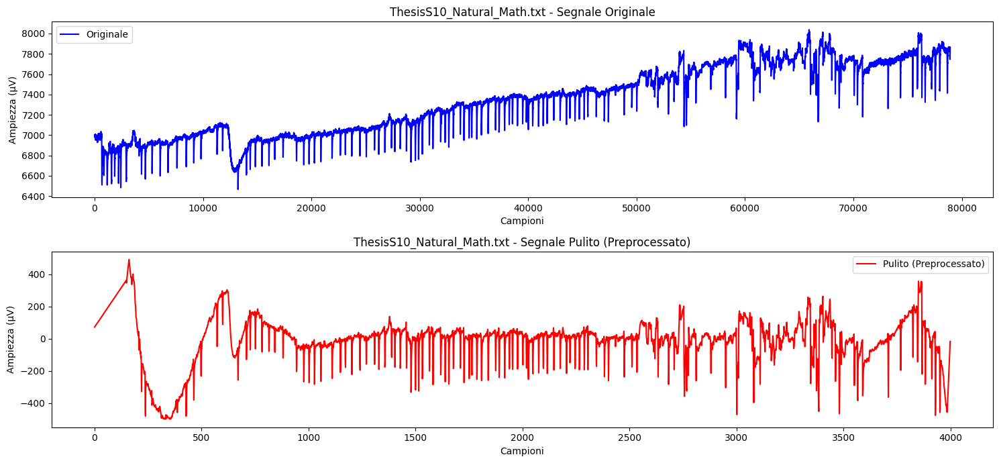

Processando il file: ThesisS14_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3903.3 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS14_Lab_EyesOpen.txt


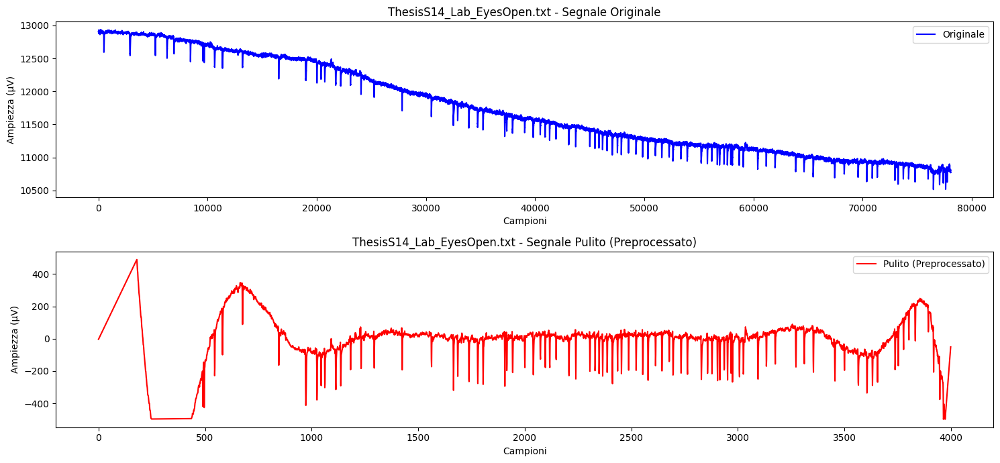

Processando il file: ThesisS9_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3887.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS9_Lab_EyesClosed.txt


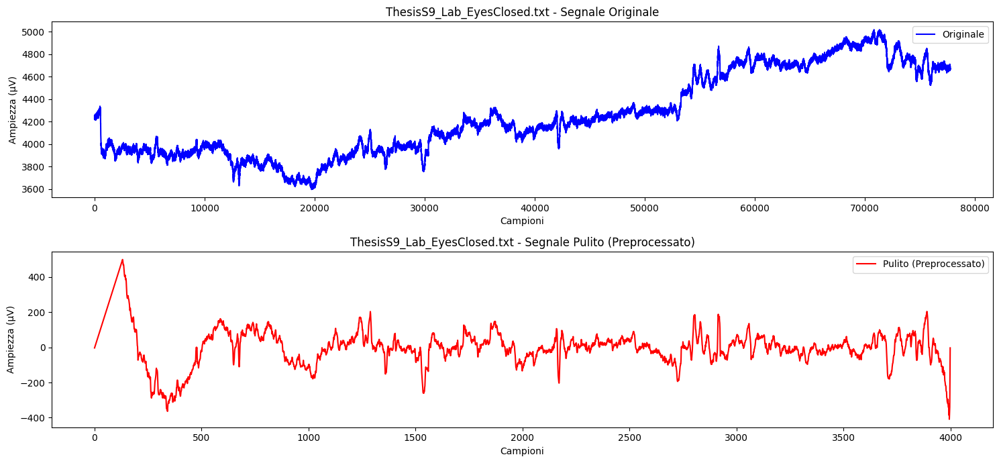

Processando il file: ThesisS13_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3859.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS13_Lab_EyesClosed.txt


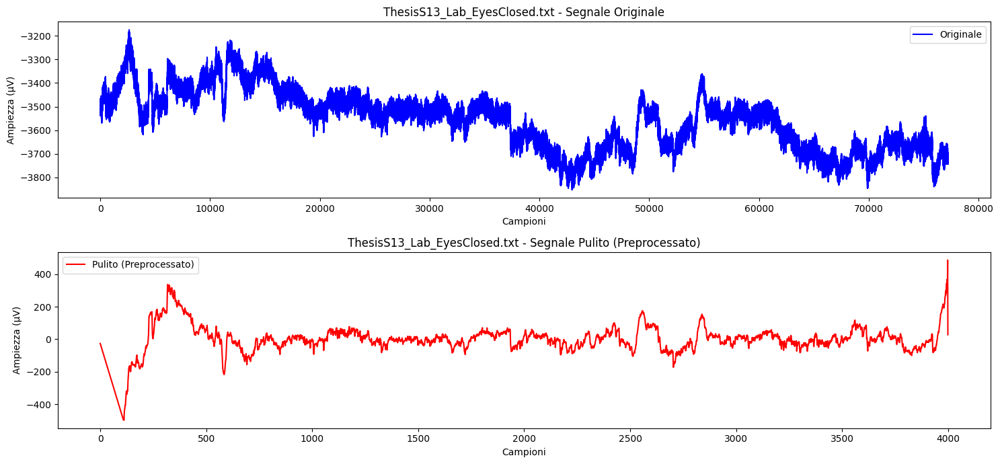

Processando il file: ThesisS22_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3903.55 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS22_Natural_EyesClosed.txt


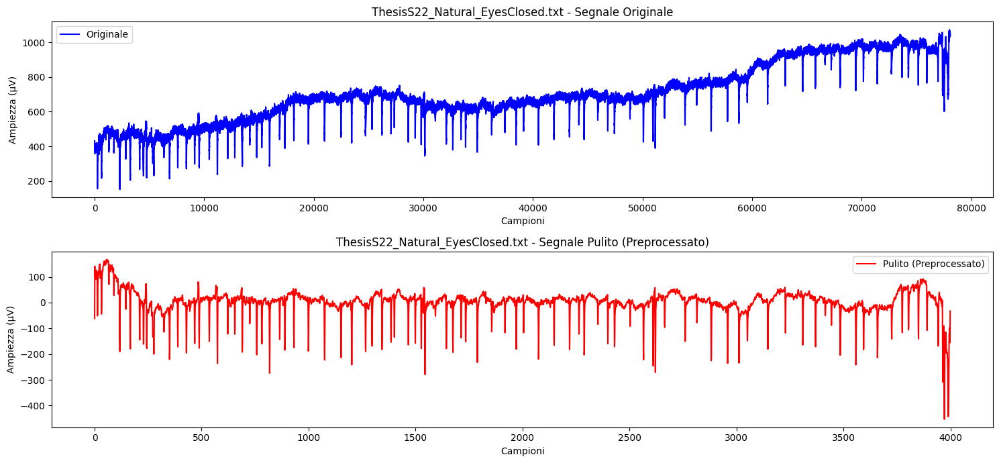

Processando il file: ThesisS21_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3902.7 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS21_Lab_EyesOpen.txt


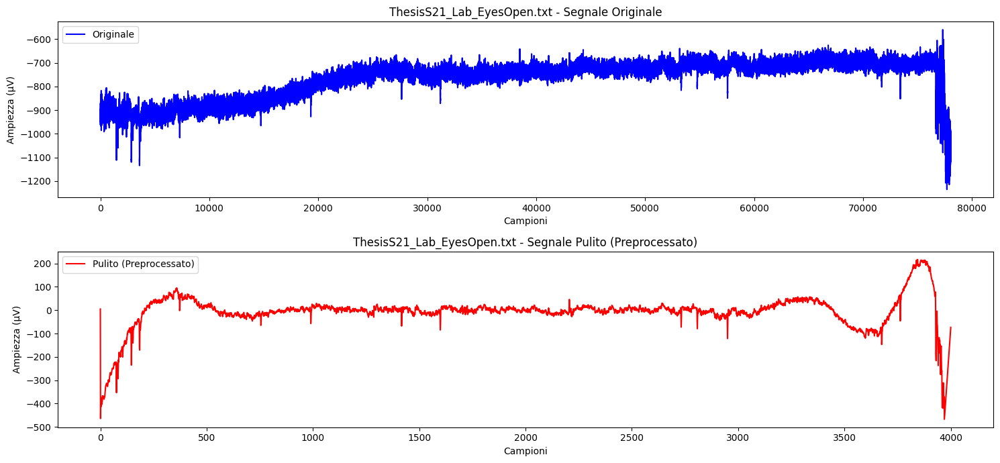

Processando il file: ThesisS12_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3831.9 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS12_Lab_Math.txt


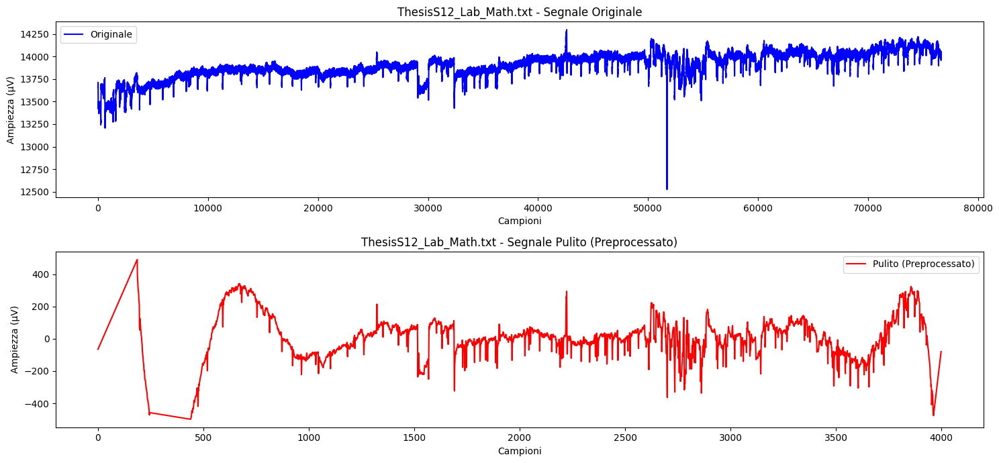

Processando il file: ThesisS8_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3815.8 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS8_Natural_Math.txt


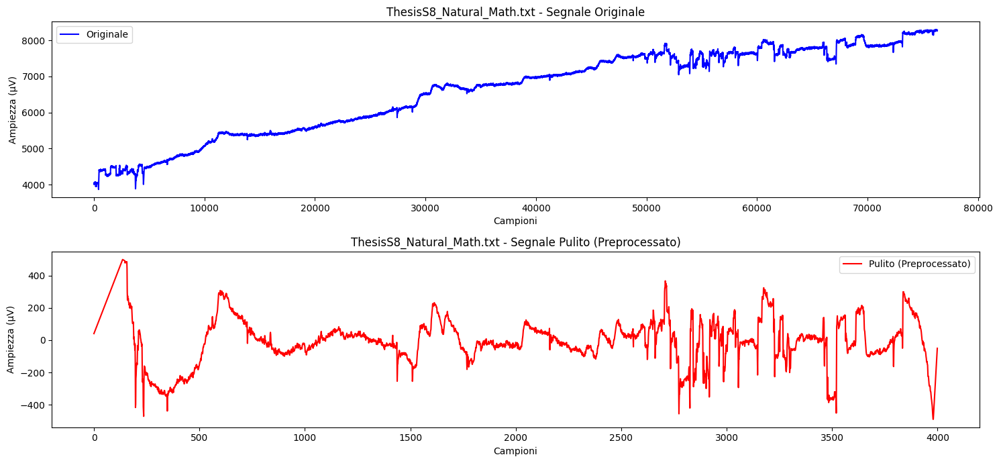

Processando il file: ThesisS5_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3405.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS5_Natural_Math.txt


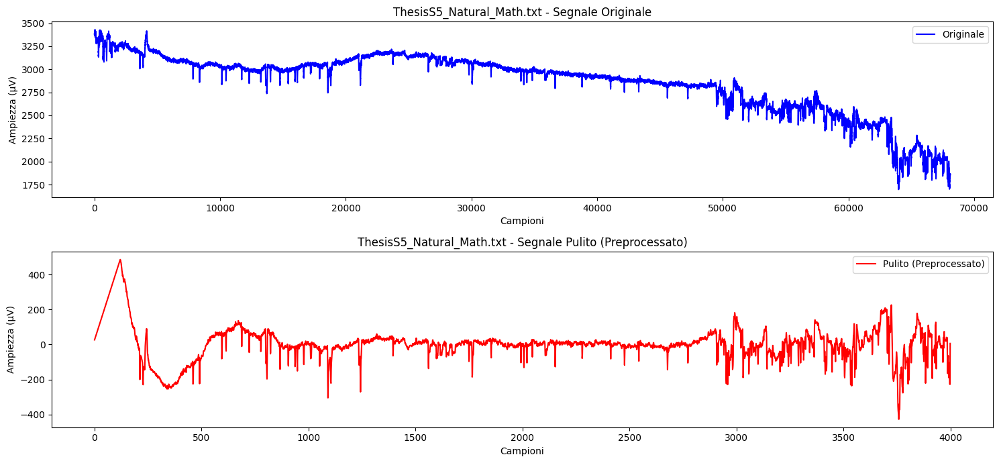

Processando il file: ThesisS14_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3860.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS14_Natural_EyesClosed.txt


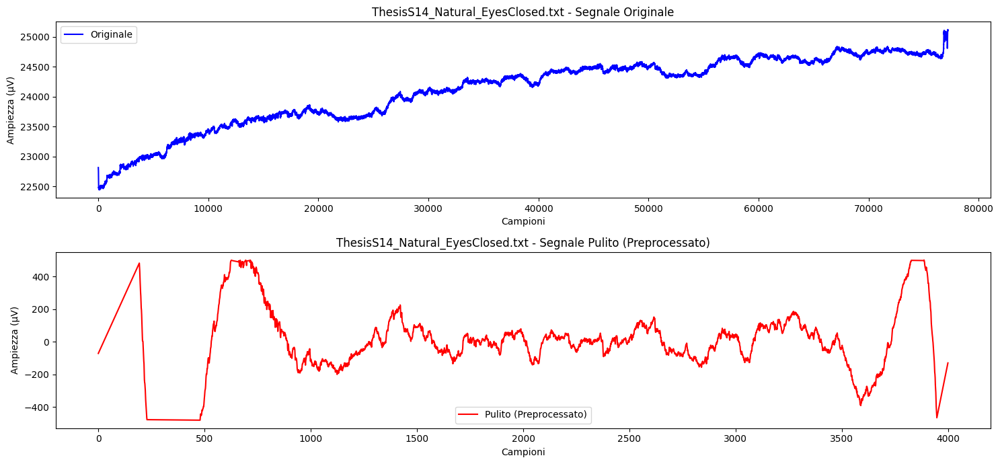

Processando il file: ThesisS17_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3788.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS17_Natural_EyesOpen.txt


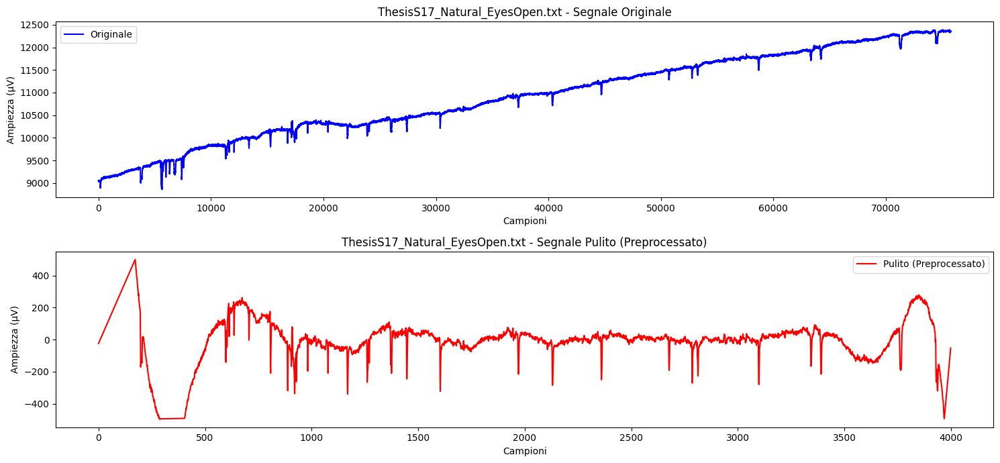

Processando il file: ThesisS26_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3844.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS26_Lab_EyesOpen.txt


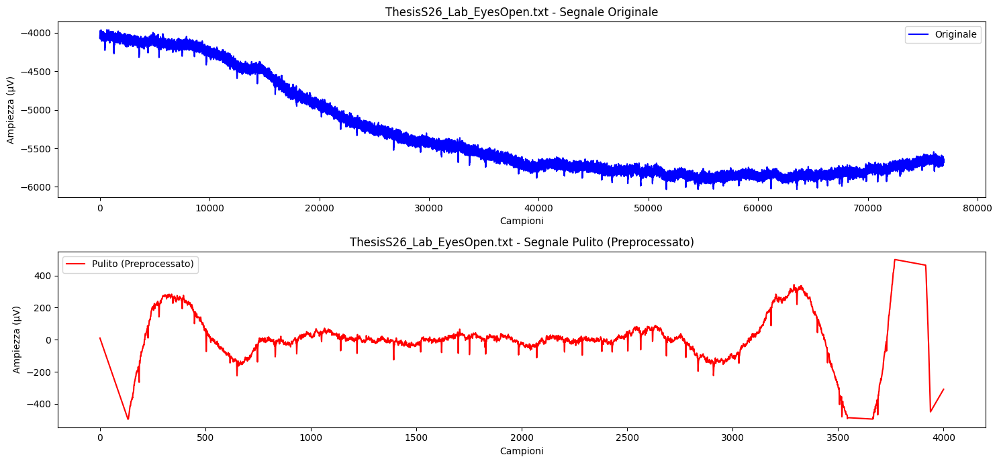

Processando il file: ThesisS9_Natural_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3974.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS9_Natural_EyesClosed.txt


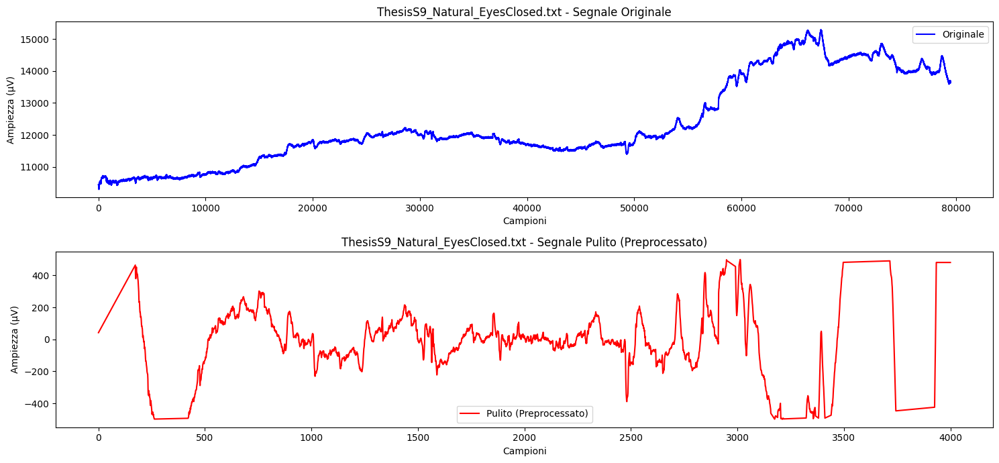

Processando il file: ThesisS10_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3859.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS10_Natural_EyesOpen.txt


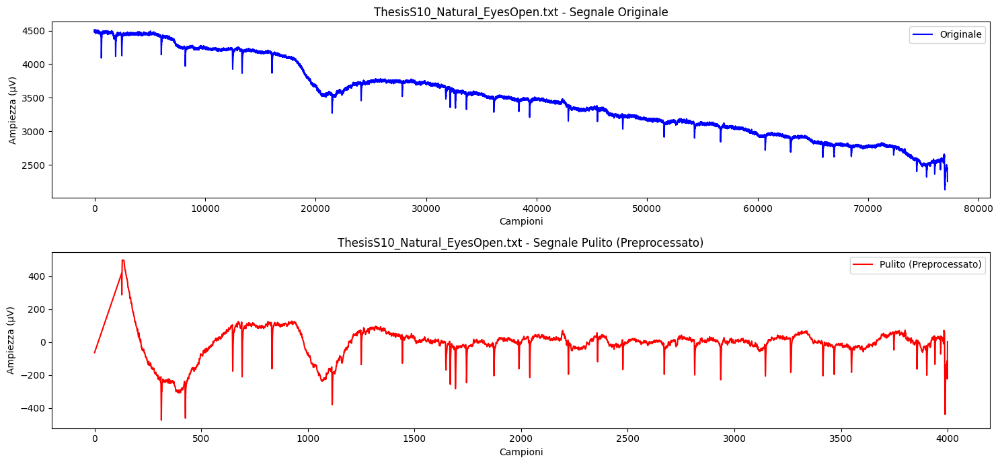

Processando il file: ThesisS13_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3917.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS13_Lab_Math.txt


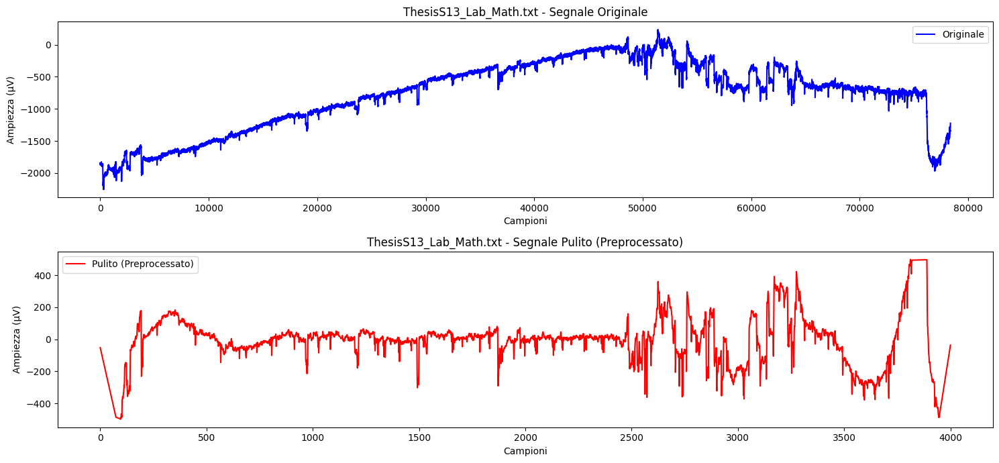

Processando il file: ThesisS24_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS24_Natural_EyesOpen.txt


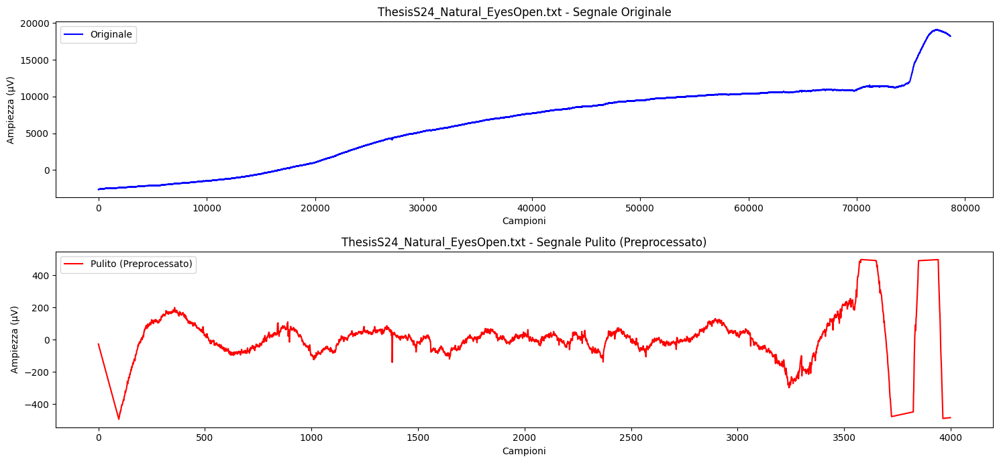

Processando il file: ThesisS17_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3816.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS17_Natural_Math.txt


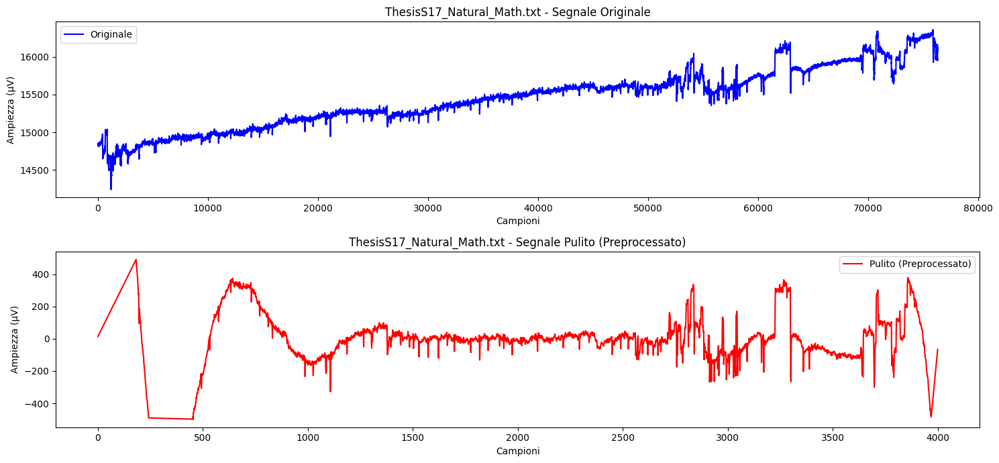

Processando il file: ThesisS8_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3917.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS8_Natural_EyesOpen.txt


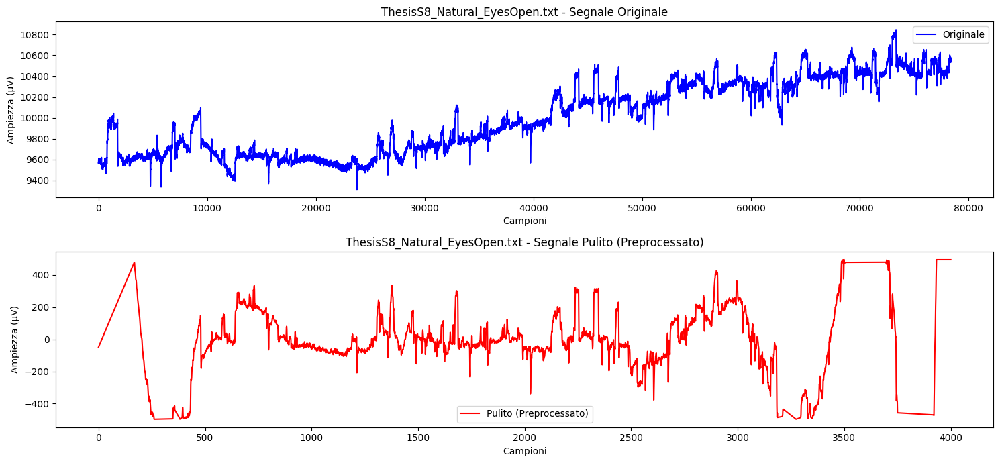

Processando il file: ThesisS24_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3860.8 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS24_Lab_Math.txt


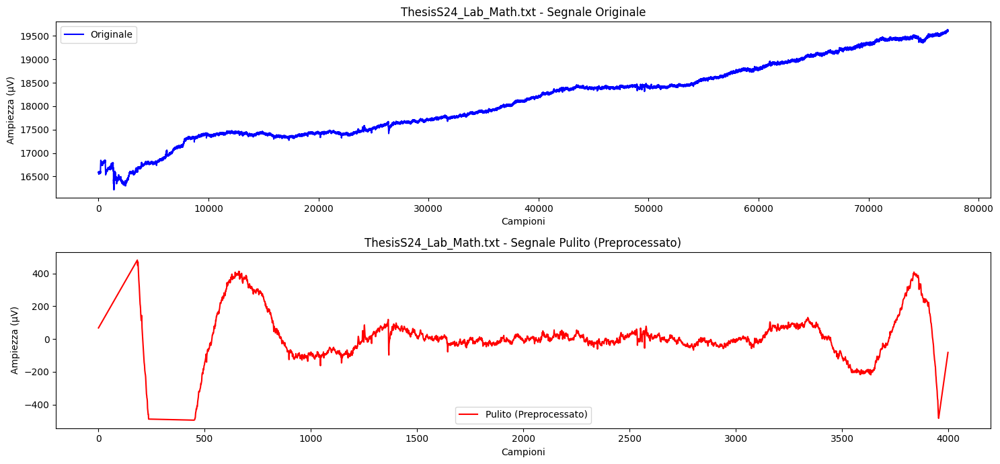

Processando il file: ThesisS18_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3844.35 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS18_Natural_EyesOpen.txt


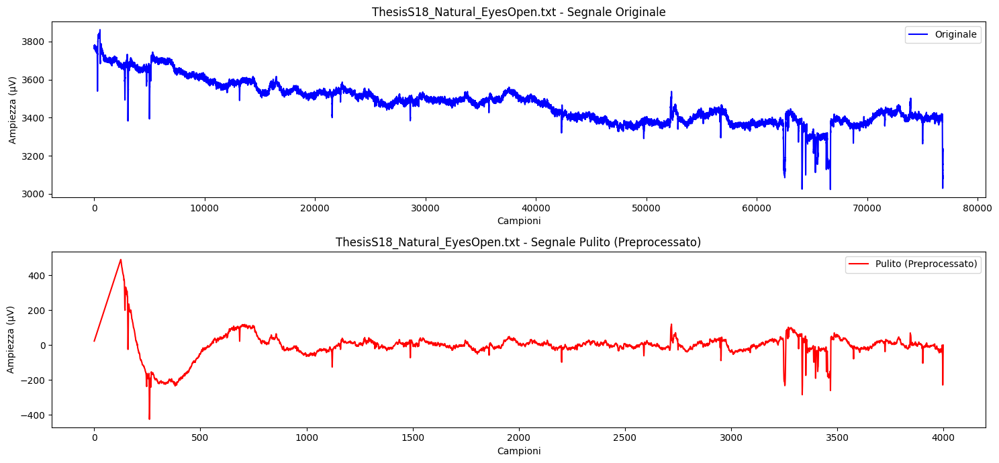

Processando il file: ThesisS9_Natural_Math.txt
Frequenza di campionamento originale calcolata: 4159.25 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS9_Natural_Math.txt


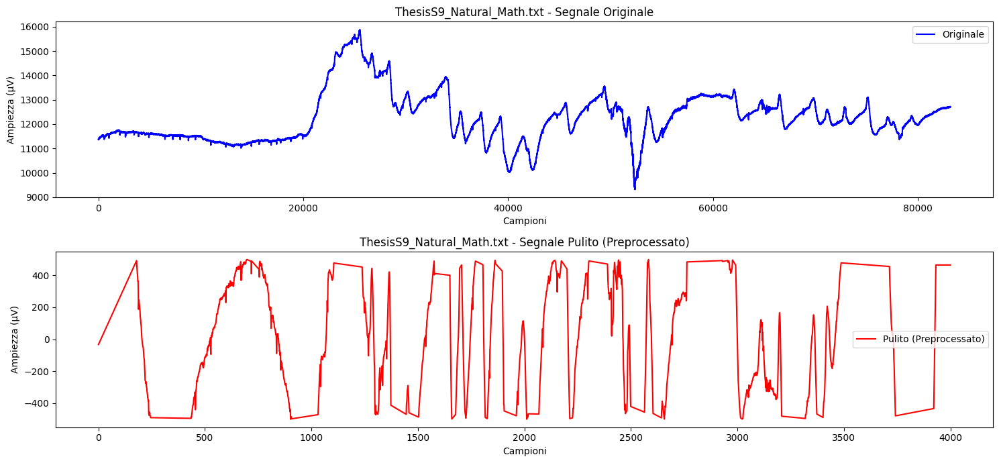

Processando il file: ThesisS22_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3803.2 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS22_Natural_EyesOpen.txt


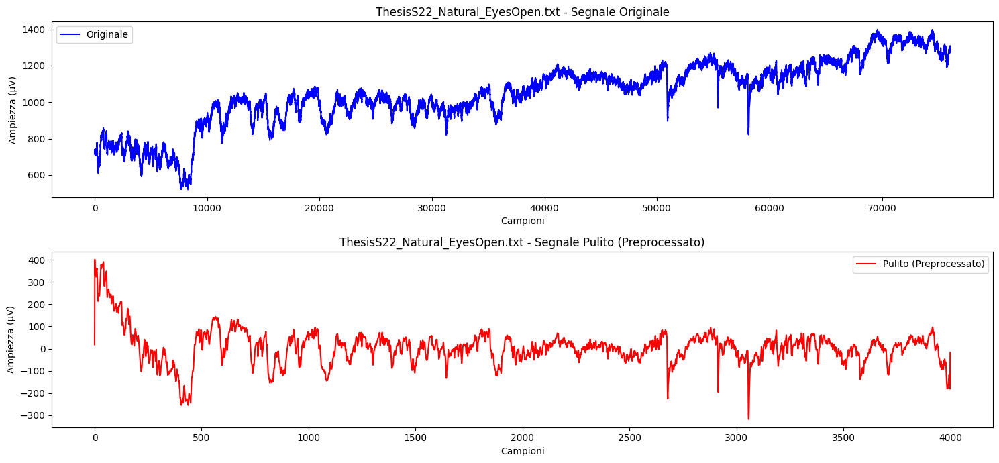

Processando il file: ThesisS24_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3901.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS24_Lab_EyesOpen.txt


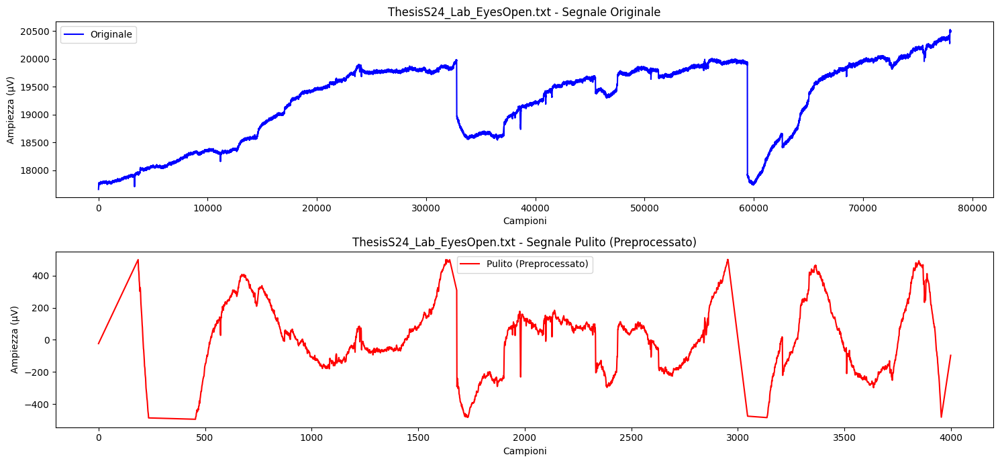

Processando il file: ThesisS16_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3830.0 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS16_Natural_EyesOpen.txt


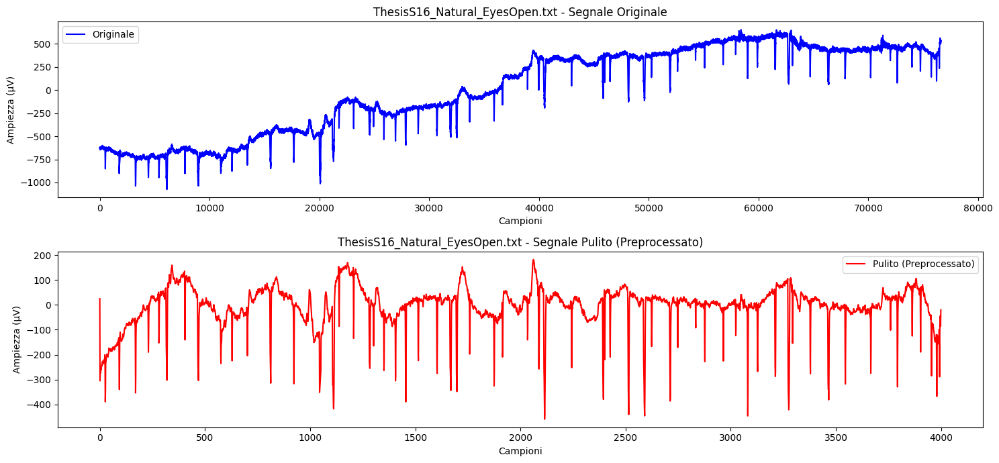

Processando il file: ThesisS22_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4046.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS22_Lab_EyesOpen.txt


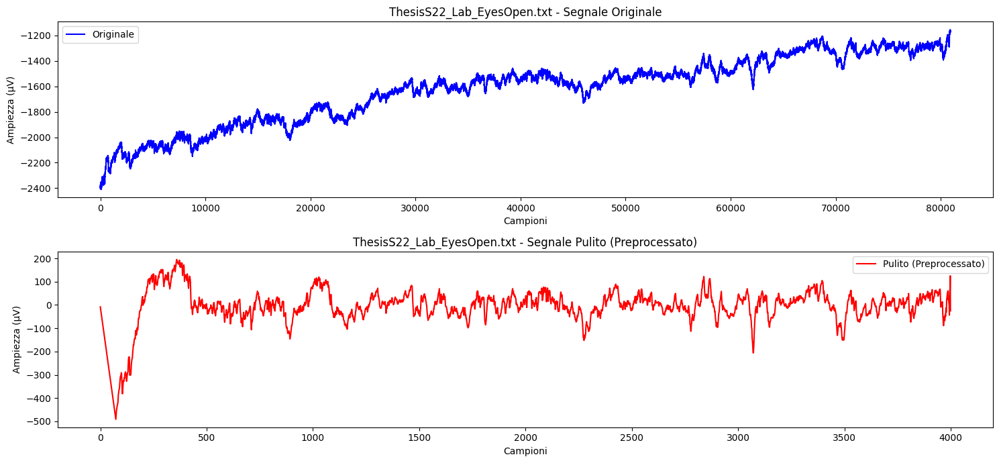

Processando il file: ThesisS11_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3917.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS11_Lab_EyesClosed.txt


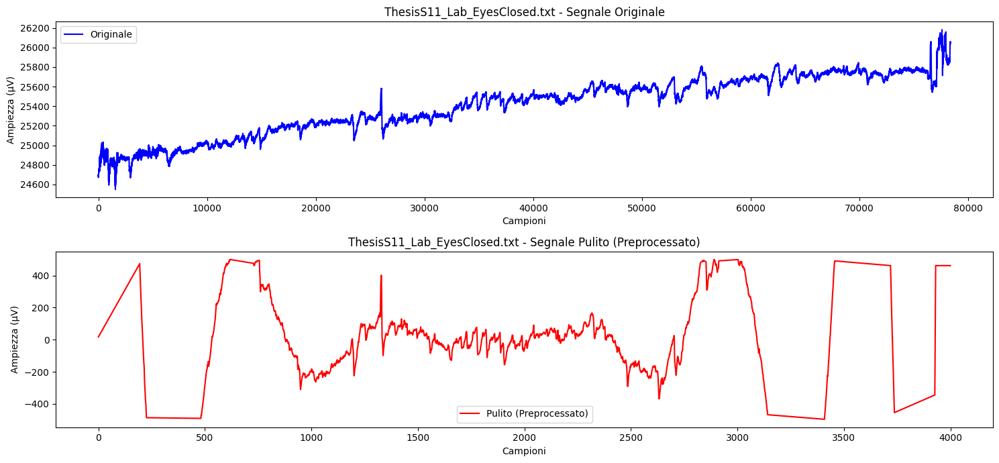

Processando il file: ThesisS11_Lab_Math.txt
Frequenza di campionamento originale calcolata: 4103.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS11_Lab_Math.txt


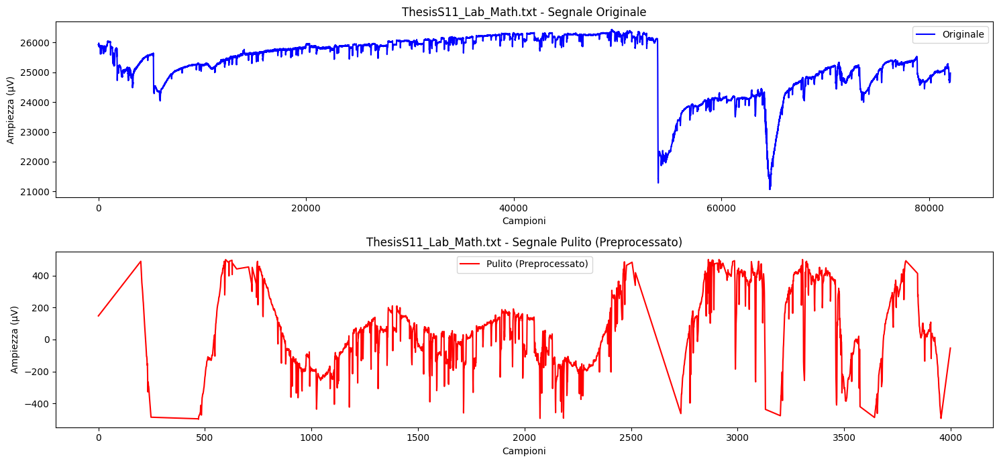

Processando il file: ThesisS5_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3860.8 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS5_Natural_EyesOpen.txt


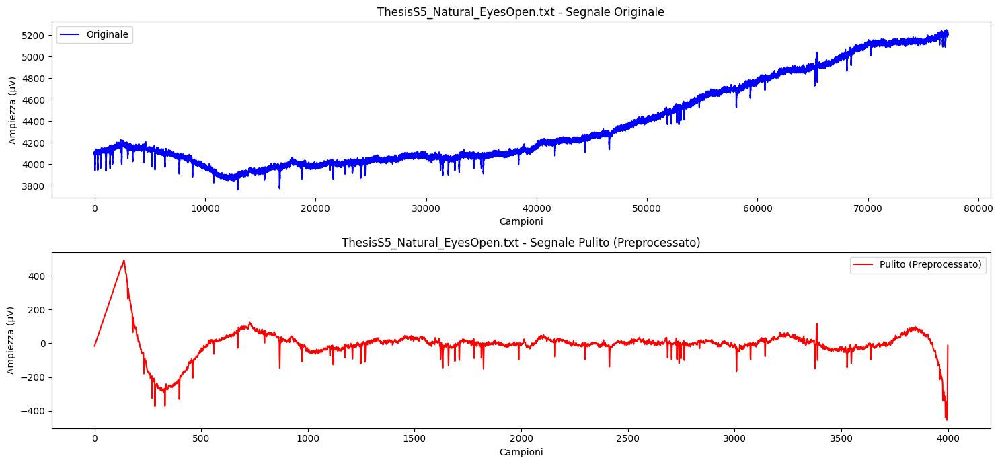

Processando il file: ThesisS6_Natural_Math.txt
Frequenza di campionamento originale calcolata: 3887.95 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS6_Natural_Math.txt


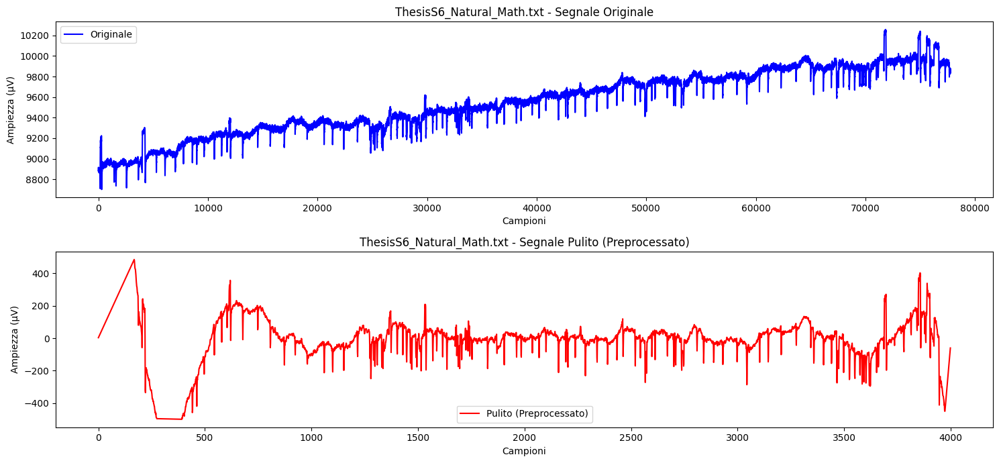

Processando il file: ThesisS19_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3932.1 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS19_Natural_EyesOpen.txt


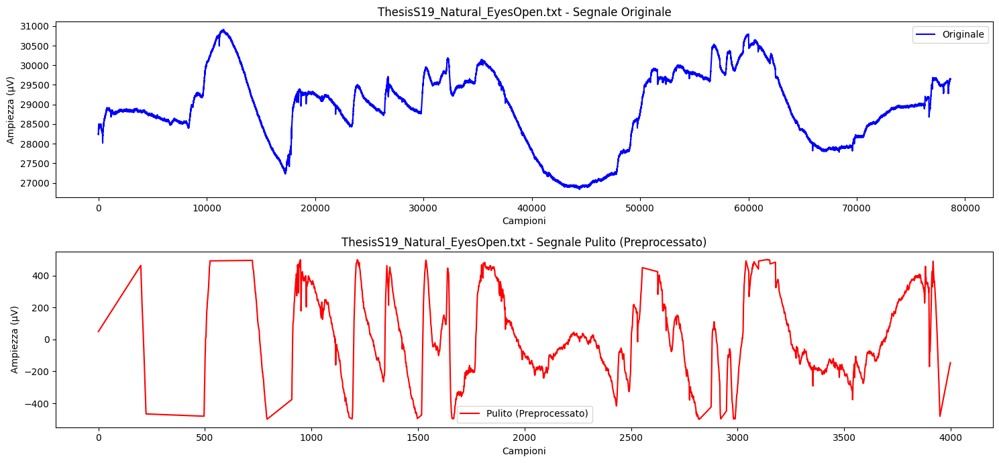

Processando il file: ThesisS20_Natural_EyesOpen.txt
Frequenza di campionamento originale calcolata: 3744.5 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS20_Natural_EyesOpen.txt


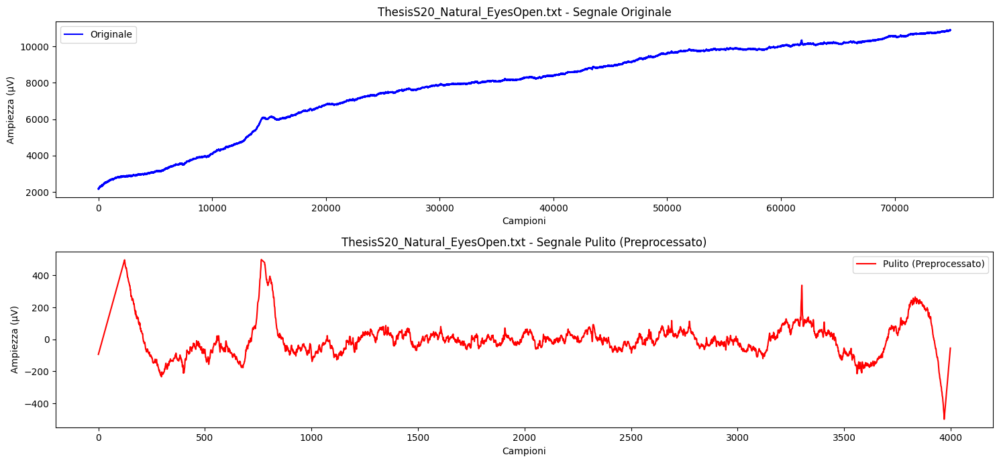

Processando il file: ThesisS3_Lab_EyesClosed.txt
Frequenza di campionamento originale calcolata: 3974.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS3_Lab_EyesClosed.txt


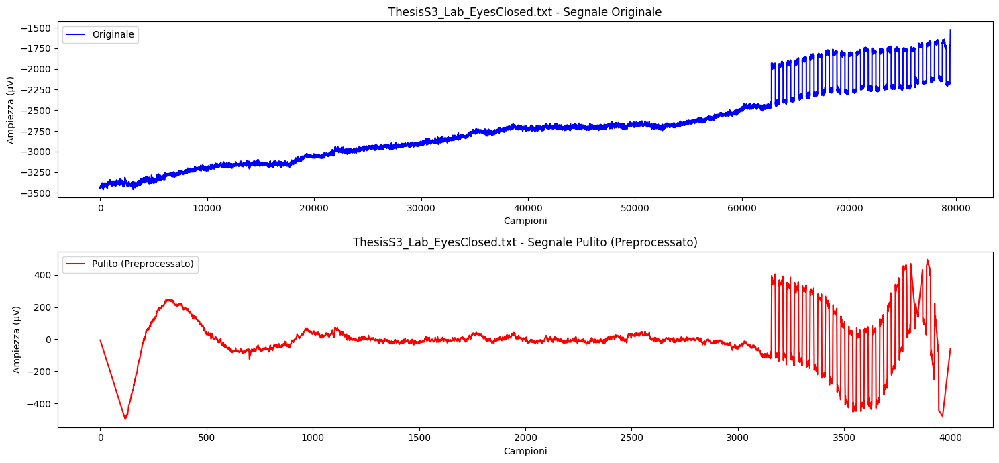

Processando il file: ThesisS6_Lab_EyesOpen.txt
Frequenza di campionamento originale calcolata: 4031.85 Hz
File con preprocessing salvato come: /kaggle/working/preprocessing/preprocessing_ThesisS6_Lab_EyesOpen.txt


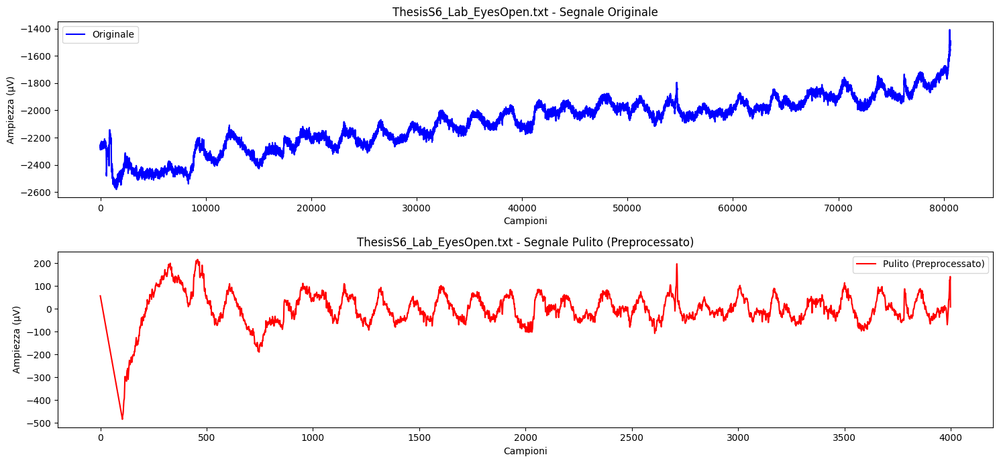

In [3]:

# Funzione per il filtro band-pass Butterworth
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Funzione per applicare il filtro ai dati
def butter_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order)
    return filtfilt(b, a, data)

# Funzione per il resampling usando librosa
def librosa_resample(data, original_fs, target_fs):
    # Controlla e gestisce NaN o inf nel segnale
    data = np.nan_to_num(data)  # Sostituisci NaN con 0 e inf con valori finiti
    return librosa.resample(data, orig_sr=original_fs, target_sr=target_fs, res_type='soxr_hq')

# Funzione per plottare solo il segnale originale e finale
def plot_signals_original_and_final(original_signal, cleaned_signal, title):
    plt.figure(figsize=(15, 7))

    # Plot segnale originale
    plt.subplot(2, 1, 1)
    plt.plot(original_signal, label='Originale', color='blue')
    plt.title(f"{title} - Segnale Originale")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza (µV)")
    plt.legend()

    # Plot segnale pulito
    plt.subplot(2, 1, 2)
    plt.plot(cleaned_signal, label='Pulito (Preprocessato)', color='red')
    plt.title(f"{title} - Segnale Pulito (Preprocessato)")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza (µV)")
    plt.legend()

    plt.tight_layout()
    plt.show()

# Percorso alla cartella contenente i file .txt
folder_path = '/kaggle/input/dataverse/dataverse_files'
folder1_path = '/kaggle/working/preprocessing'
os.makedirs(folder1_path, exist_ok=True)

#Lista di tutti i file .txt nella cartella
file_paths = glob.glob(os.path.join(folder_path, '*.txt'))

# Parametri di frequenza di campionamento target
target_fs = 200  # Frequenza di campionamento desiderata

# Parametri per il filtro Butterworth
lowcut = 0.3
highcut = 80.0

# Durata del segnale in secondi
signal_duration = 20 #preso dal paper, scelgono dataset con 20sec

for file_path in file_paths:
    # Estrai il nome del file per identificazione
    file_name = os.path.basename(file_path)
    print(f"Processando il file: {file_name}")
    
    # Carica il file .txt
    data = pd.read_csv(file_path, sep='\t', header=None)
    
    # Calcola la frequenza di campionamento originale
    num_samples = len(data)  # Numero totale di campioni
    original_fs = num_samples / signal_duration
    print(f"Frequenza di campionamento originale calcolata: {original_fs} Hz")
    
    cleaned_signals = []
    for channel_idx in range(data.shape[1]):  # Itera su tutti i canali
        original_signal = data.iloc[:, channel_idx].values  # Estrarre il segnale come array NumPy

        # Rimozione di eventuali valori non numerici prima del resampling
        original_signal = np.nan_to_num(original_signal) 

        # Resampling usando librosa
        resampled_signal = librosa_resample(original_signal, original_fs, target_fs)

        # Filtraggio
        filtered_signal = butter_filter(resampled_signal, lowcut, highcut, target_fs)

        # Rimozione valori ±500 µV
        cleaned_signal = filtered_signal.copy()
        cleaned_signal[np.abs(cleaned_signal) > 500] = np.nan  # Sostituisci con NaN
        cleaned_signal = pd.Series(cleaned_signal).interpolate().fillna(0).values  # Interpolazione per riempire i vuoti
        cleaned_signals.append(cleaned_signal)

    # Converte i canali preprocessati in un DataFrame
    cleaned_data = pd.DataFrame(cleaned_signals).T  # Trasponi per avere colonne come canali
    cleaned_data.columns = [f"{i}" for i in range(data.shape[1])]  # Rinominare le colonne

    # Salva i dati preprocessati
    output_path = os.path.join(folder1_path, f"preprocessing_{file_name}")
    cleaned_data.to_csv(output_path, index=False)
    print(f"File con preprocessing salvato come: {output_path}")

    # Plot del segnale originale e finale (solo il primo canale)
    plot_signals_original_and_final(
        data.iloc[:, 0].values,  # Segnale originale del primo canale
        cleaned_data.iloc[:, 0].values,  # Segnale pulito del primo canale
        title=file_name
    )


Processando il file: ThesisS19_Lab_Math.txt
Frequenza di campionamento originale calcolata: 3903.2 Hz


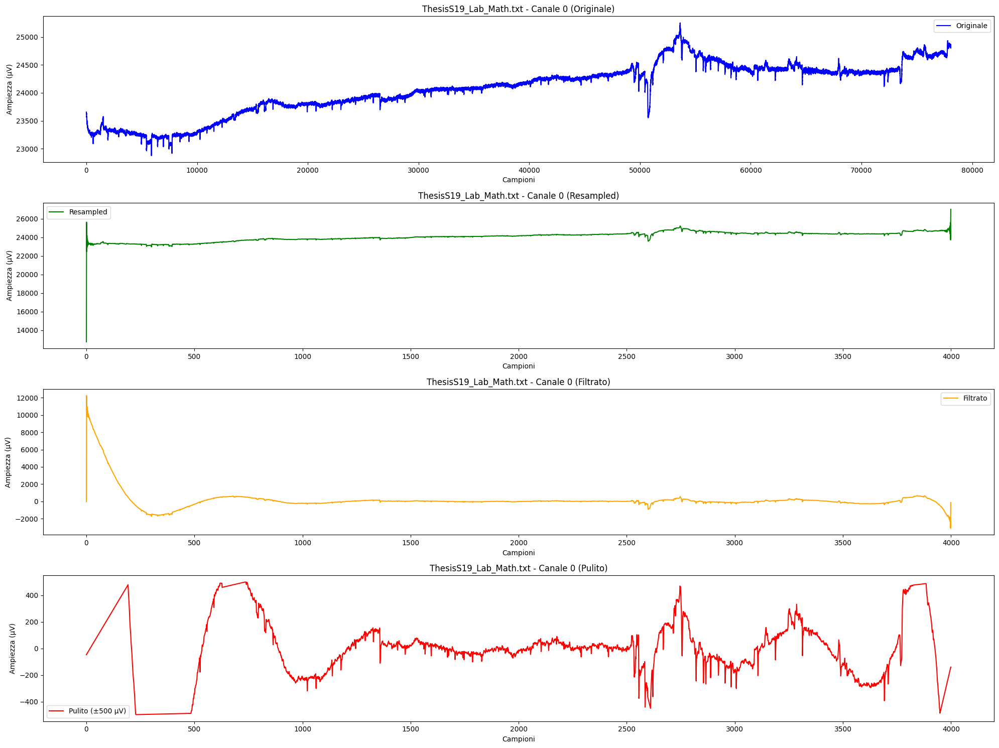

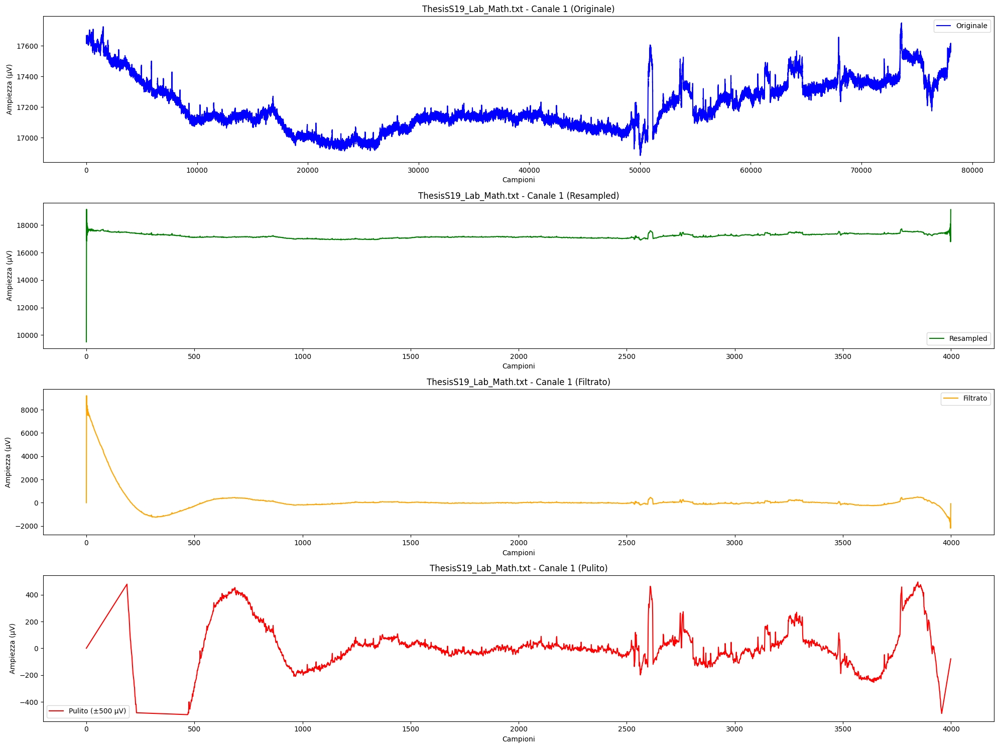

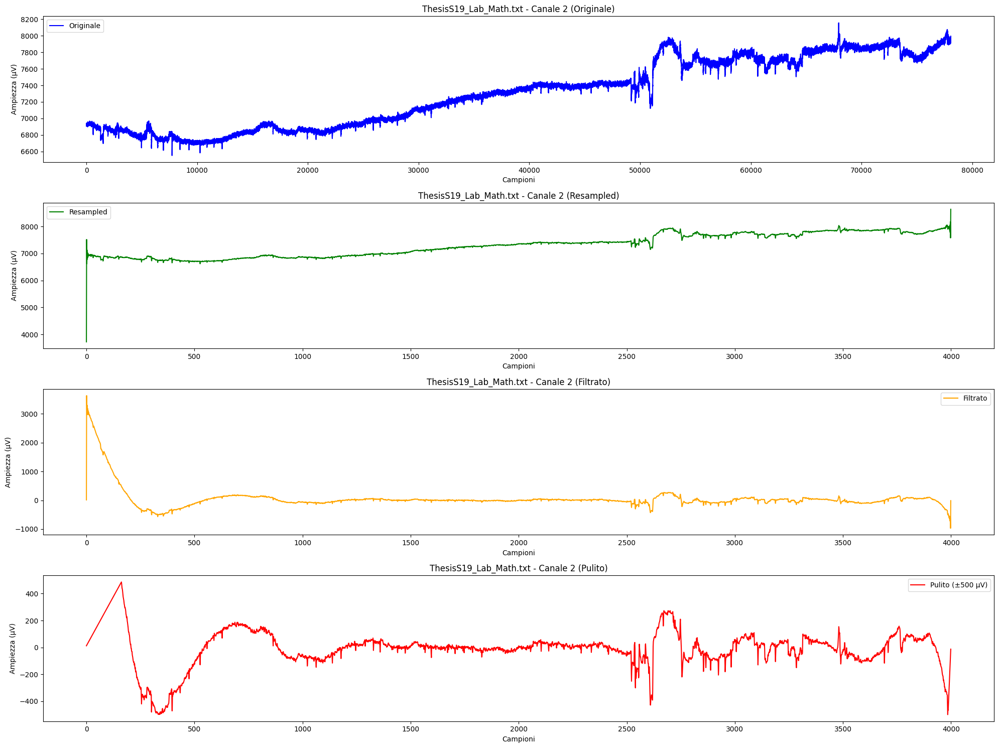

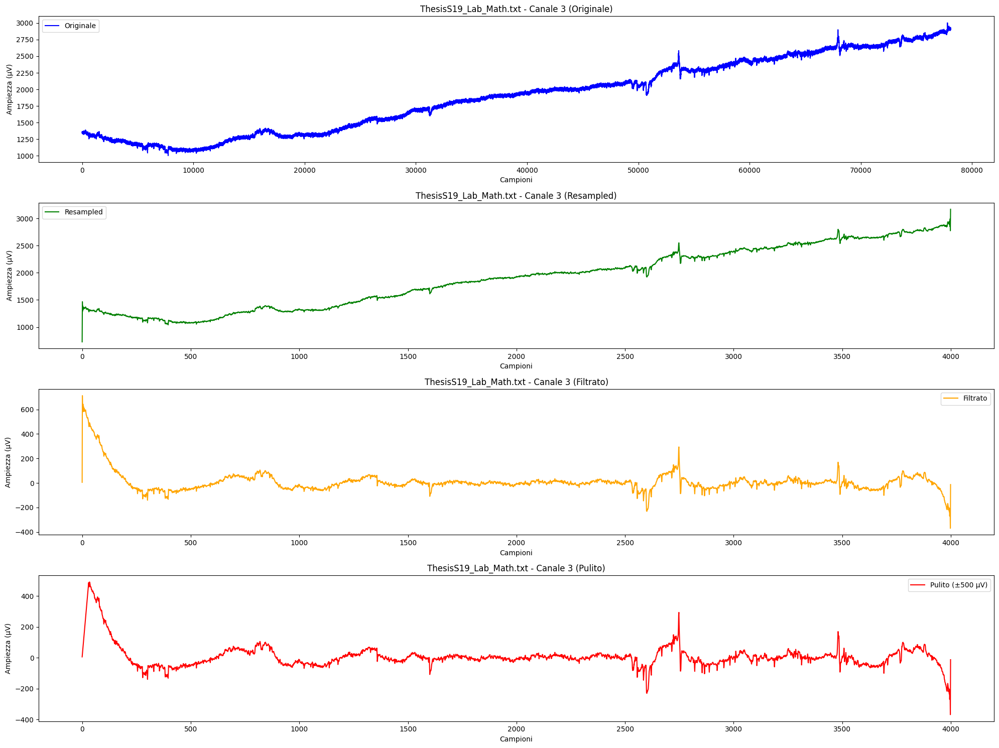

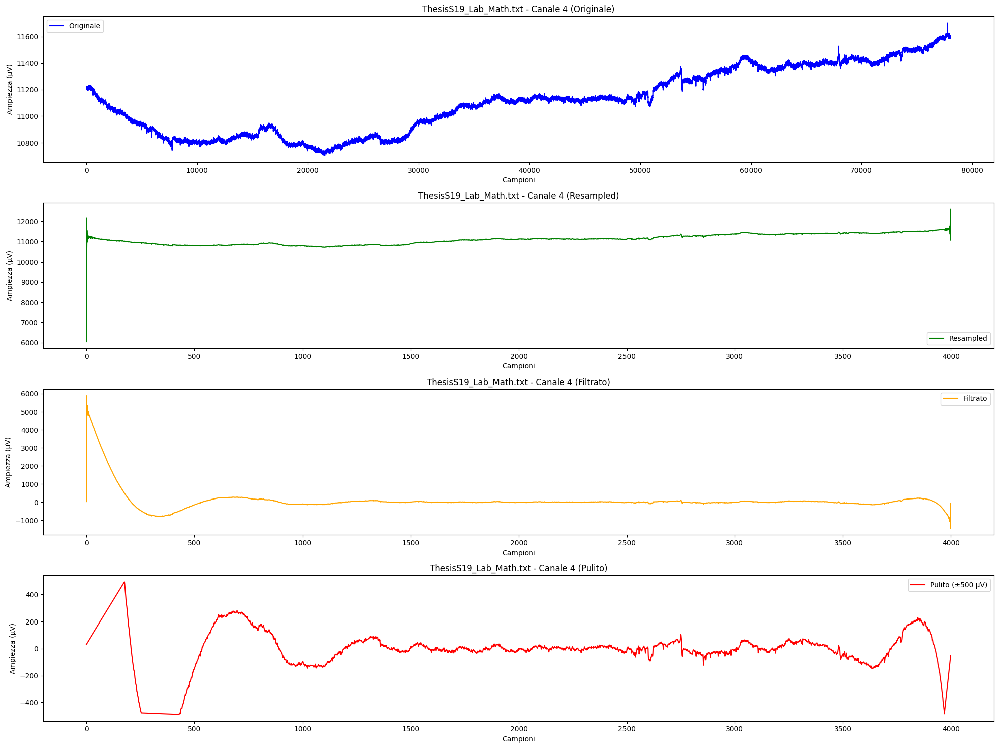

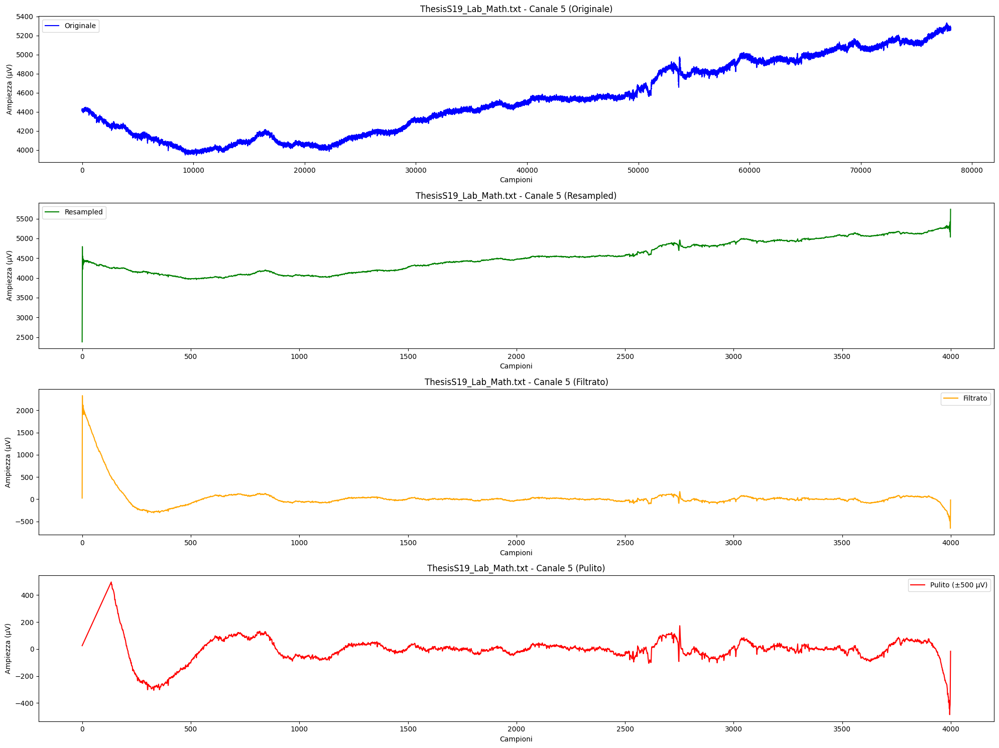

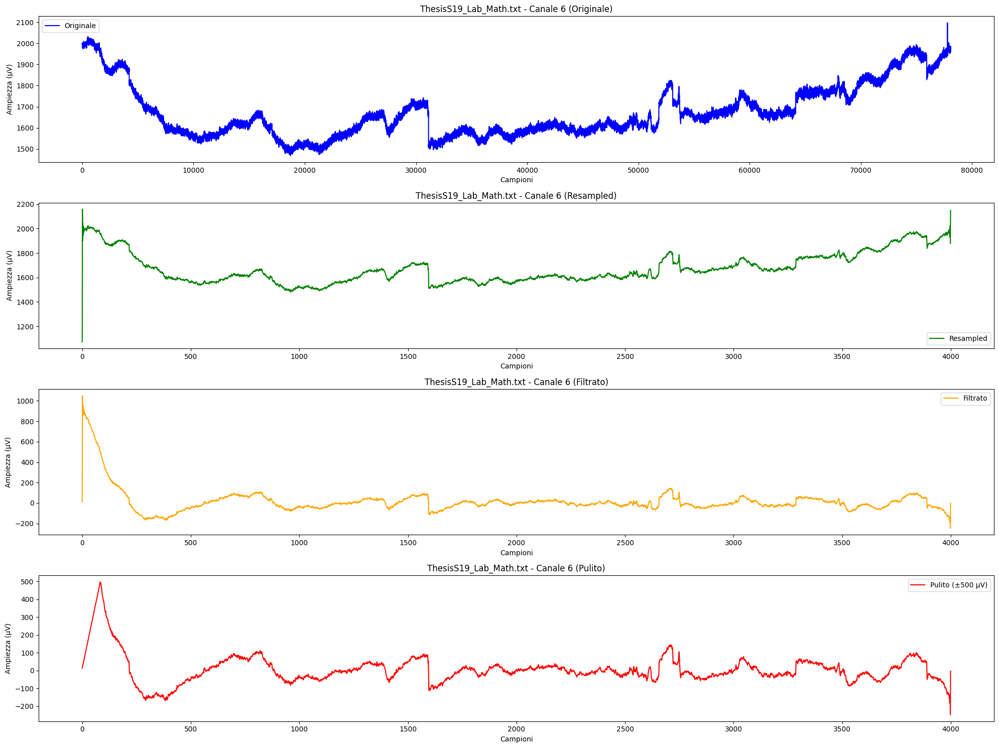

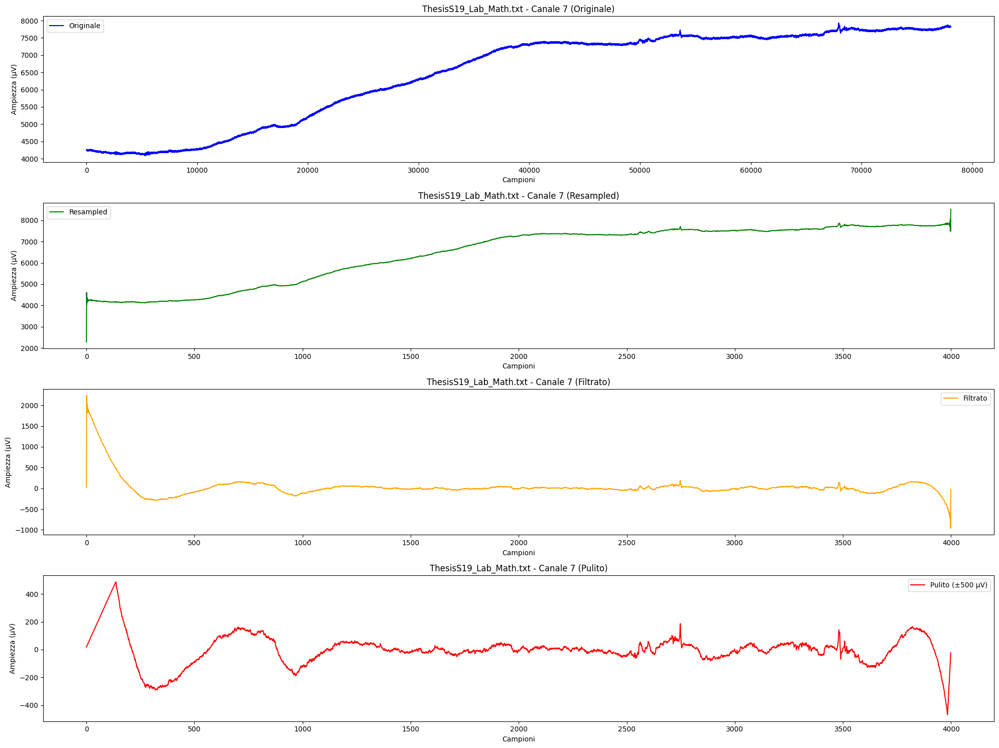

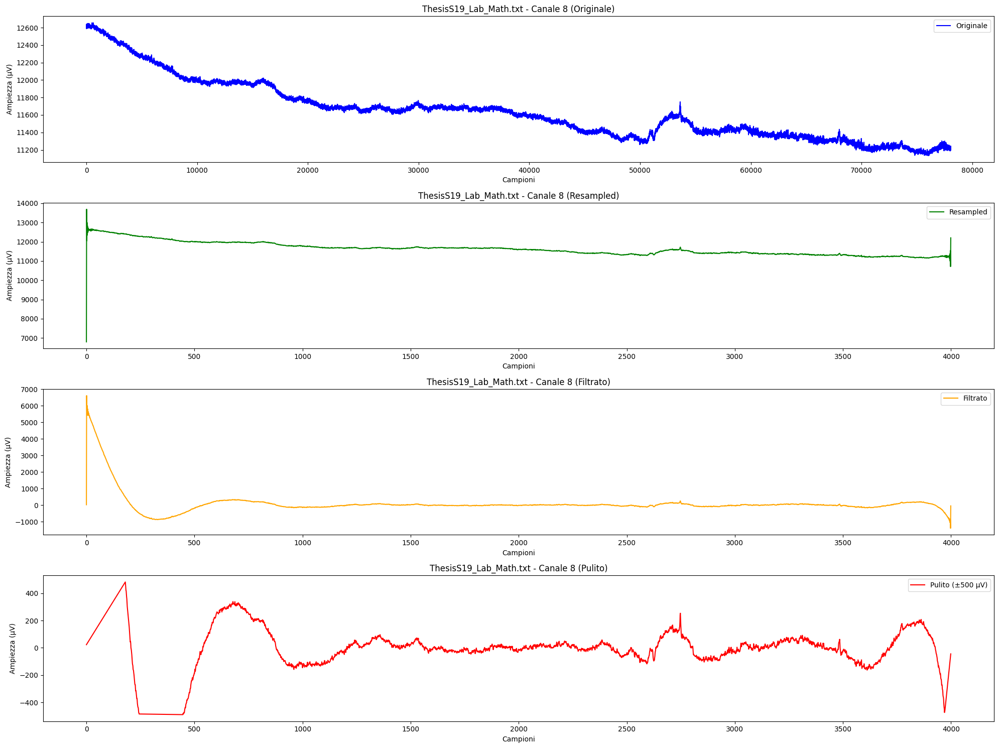

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x78299ce03880> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

In [6]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt
import librosa

# Funzione per il filtro band-pass Butterworth
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Funzione per applicare il filtro ai dati
def butter_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order)
    return filtfilt(b, a, data)

# Funzione per il resampling usando librosa
def librosa_resample(data, original_fs, target_fs):
    return librosa.resample(data, orig_sr=original_fs, target_sr=target_fs, res_type='soxr_hq')

# Funzione per plottare i segnali per ogni fase
def plot_signals_by_phase(original_signal, resampled_signal, filtered_signal, cleaned_signal, title, channel_idx):
    plt.figure(figsize=(20, 15))

    # Segnale originale
    plt.subplot(4, 1, 1)
    plt.plot(original_signal, label='Originale', color='blue')
    plt.title(f"{title} - Canale {channel_idx} (Originale)")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza (µV)")
    plt.legend()

    # Segnale resampled
    plt.subplot(4, 1, 2)
    plt.plot(resampled_signal, label='Resampled', color='green')
    plt.title(f"{title} - Canale {channel_idx} (Resampled)")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza (µV)")
    plt.legend()

    # Segnale filtrato
    plt.subplot(4, 1, 3)
    plt.plot(filtered_signal, label='Filtrato', color='orange')
    plt.title(f"{title} - Canale {channel_idx} (Filtrato)")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza (µV)")
    plt.legend()

    # Segnale pulito
    plt.subplot(4, 1, 4)
    plt.plot(cleaned_signal, label='Pulito (±500 µV)', color='red')
    plt.title(f"{title} - Canale {channel_idx} (Pulito)")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza (µV)")
    plt.legend()

    plt.tight_layout()
    plt.show()

# Percorso alla cartella contenente i file .txt
folder_path = '/kaggle/input/dataverse/dataverse_files'
folder1_path = '/kaggle/working/preprocessing'
os.makedirs(folder1_path, exist_ok=True)

# Ottieni la lista di tutti i file .txt nella cartella
file_paths = glob.glob(os.path.join(folder_path, '*.txt'))
#original_fs = 27000
# Parametri di frequenza di campionamento target
target_fs = 200  # Frequenza di campionamento desiderata

# Parametri per il filtro Butterworth
lowcut = 0.3
highcut = 80.0

# Durata del segnale in secondi
signal_duration = 20

# Loop per processare ogni file
for file_path in file_paths:
    # Estrai il nome del file per identificazione
    file_name = os.path.basename(file_path)
    print(f"Processando il file: {file_name}")
    
    # Carica il file .txt
    data = pd.read_csv(file_path, sep='\t', header=None)
    # Calcola la frequenza di campionamento originale
    num_samples = len(data)  # Numero totale di campioni
    original_fs = num_samples / signal_duration
    print(f"Frequenza di campionamento originale calcolata: {original_fs} Hz")
    # Per ogni canale
    for channel_idx in range(data.shape[1]):  # Itera su tutti i canali
        original_signal = data.iloc[:, channel_idx].values  # Estrarre il segnale come array NumPy

        # Resampling usando librosa
        resampled_signal = librosa_resample(original_signal, original_fs, target_fs)

        # Filtraggio
        filtered_signal = butter_filter(resampled_signal, lowcut, highcut, target_fs)

        # Rimozione valori ±500 µV
        cleaned_signal = filtered_signal.copy()
        cleaned_signal[np.abs(cleaned_signal) > 500] = np.nan  # Sostituisci con NaN
        cleaned_signal = pd.Series(cleaned_signal).interpolate().fillna(0).values  # Interpolazione per riempire i vuoti

        # Plot per ogni fase
        plot_signals_by_phase(
            original_signal,
            resampled_signal,
            filtered_signal,
            cleaned_signal,
            title=file_name,
            channel_idx=channel_idx
        )

    # Salva i dati preprocessati per tutti i canali
    cleaned_data = pd.DataFrame({
        col: butter_filter(
            librosa_resample(data.iloc[:, col].values, original_fs, target_fs),
            lowcut, highcut, target_fs
        )
        for col in range(data.shape[1])
    })
    cleaned_data = cleaned_data[(cleaned_data.abs() < 500).all(axis=1)]  # Rimuove righe con valori > ±500 µV
    output_path = os.path.join(folder1_path, f"preprocessing_{file_name}")
    cleaned_data.to_csv(output_path, index=False)
    print(f"File con preprocessing salvato come: {output_path}")


In [4]:
#ELIMINA I FILE VUOTI

# Percorso alla cartella contenente i file preprocessati
preprocessed_folder_path = '/kaggle/working/preprocessing'

preprocessed_file_paths = glob.glob(os.path.join(preprocessed_folder_path, '*.txt'))

# Loop per controllare ogni file preprocessato
for file_path in preprocessed_file_paths:
    file_name = os.path.basename(file_path)
    print(f"Verificando il file: {file_name}")
    
    # Controllo se il file è vuoto
    try:
        data = pd.read_csv(file_path)
        
        # Se il file è vuoto, elimino
        if data.empty:
            print(f"Il file {file_name} è vuoto. Eliminazione in corso...")
            os.remove(file_path)
        else:
            print(f"Il file {file_name} contiene dati validi.")
    
    except Exception as e:
        print(f"Errore nella lettura del file {file_name}: {e}")
        # Elimina il file se non leggibile
        os.remove(file_path)


Verificando il file: preprocessing_ThesisS22_Natural_Math.txt
Il file preprocessing_ThesisS22_Natural_Math.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS14_Natural_EyesOpen.txt
Il file preprocessing_ThesisS14_Natural_EyesOpen.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS5_Lab_Math.txt
Il file preprocessing_ThesisS5_Lab_Math.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS7_Natural_EyesClosed.txt
Il file preprocessing_ThesisS7_Natural_EyesClosed.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS16_Lab_EyesClosed.txt
Il file preprocessing_ThesisS16_Lab_EyesClosed.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS18_Lab_Math.txt
Il file preprocessing_ThesisS18_Lab_Math.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS17_Lab_EyesOpen.txt
Il file preprocessing_ThesisS17_Lab_EyesOpen.txt contiene dati validi.
Verificando il file: preprocessing_ThesisS23_Lab_EyesClosed.txt
I

In [5]:
#Reshape rimette in colonne da 16 i file txt, inizialmente sono separati da una ,e concatenati
input_folder = "/kaggle/working/preprocessing"  
output_folder = "/kaggle/working/reshaped"

os.makedirs(output_folder, exist_ok=True)

# Numero di colonne per il reshape
num_columns = 16 

for file_name in os.listdir(input_folder):
    if file_name.endswith(".txt"):
        file_path = os.path.join(input_folder, file_name)
        
        # Legge i dati dal file
        data = np.loadtxt(file_path, delimiter=',')  # Carica i dati come array
        
        # Esegue il reshape
        reshaped_data = data.reshape(-1, num_columns)
        
        # Definisce il percorso di output per il file reshaped
        output_path = os.path.join(output_folder, f"reshaped_{file_name}")
        
        np.savetxt(output_path, reshaped_data, delimiter='\t', fmt='%f')
        
        print(f"File {file_name} reshaped e salvato come {output_path}")

print("Operazione completata su tutti i file.")


File preprocessing_ThesisS22_Natural_Math.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS22_Natural_Math.txt
File preprocessing_ThesisS14_Natural_EyesOpen.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS14_Natural_EyesOpen.txt
File preprocessing_ThesisS5_Lab_Math.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS5_Lab_Math.txt
File preprocessing_ThesisS7_Natural_EyesClosed.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS7_Natural_EyesClosed.txt
File preprocessing_ThesisS16_Lab_EyesClosed.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS16_Lab_EyesClosed.txt
File preprocessing_ThesisS18_Lab_Math.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS18_Lab_Math.txt
File preprocessing_ThesisS17_Lab_EyesOpen.txt reshaped e salvato come /kaggle/working/reshaped/reshaped_preprocessing_ThesisS1

**FASE DI TRAINING DELL'ENCODER RICORRENTE E CONVOLUZIONALE**

********

In [8]:
# ------------------- Funzioni per Salvare e Caricare Modelli -------------------
save_path = "/kaggle/working/models"
os.makedirs(save_path, exist_ok=True)

def save_model(model, path):
    torch.save(model.state_dict(), path)
    print(f"Modello salvato in {path}")


#tolgo il module 
def load_model(model, path, device="cuda"):
    state_dict = torch.load(path, map_location=device)
    if "module." in list(state_dict.keys())[0]:
        state_dict = {k.replace("module.", ""): v for k, v in state_dict.items()}
    model.load_state_dict(state_dict)
    print(f"Modello caricato da {path}")

In [9]:
#AUGMENTATION E CHUNK DATI
def min_max_amplitude_scale(data, scale_min=0.5, scale_max=2):
    scale_factor = random.uniform(scale_min, scale_max)
    return data * scale_factor

def time_shift(data, shift_min=-50, shift_max=50):
    shift_samples = random.randint(shift_min, shift_max)
    return np.roll(data, shift_samples)

def dc_shift(data, shift_min=-10, shift_max=10):
    shift_value = random.uniform(shift_min, shift_max)
    return data + shift_value

def zero_masking(data, mask_min=0, mask_max=150):
    mask_size = random.randint(mask_min, mask_max)
    start_idx = random.randint(0, len(data) - mask_size)
    data[start_idx:start_idx+mask_size] = 0
    return data

def add_gaussian_noise(data, sigma_min=0, sigma_max=0.2):
    sigma = random.uniform(sigma_min, sigma_max)
    noise = np.random.normal(0, sigma, len(data))
    return data + noise

def apply_random_transformations_class(channel_data):
    transformations = [min_max_amplitude_scale, time_shift, dc_shift, zero_masking, add_gaussian_noise]
    selected_transform = random.choice(transformations)
    transformed_data = selected_transform(channel_data.copy())
    return transformed_data
    
def apply_random_transformations(channel_data):
    transformations = [min_max_amplitude_scale, time_shift, dc_shift, zero_masking, add_gaussian_noise]
    selected_transforms = random.sample(transformations, 2)
    transformed_data_1 = selected_transforms[0](channel_data.copy())
    transformed_data_2 = selected_transforms[1](channel_data.copy())
    return transformed_data_1, transformed_data_2
    
    
def chunk_data(data, chunk_size=4000):
    """Divide i dati in chunk della dimensione specificata."""
    chunks = []
    num_chunks = len(data) // chunk_size

    for i in range(num_chunks):
        start_idx = i * chunk_size
        end_idx = (i + 1) * chunk_size
        chunks.append(data[start_idx:end_idx])
    
    return chunks
    
# Funzione per estrarre l'etichetta dal nome del file
def extract_label_from_filename(file_name):
    file_name = os.path.basename(file_name)
    if "Lab" in file_name and "EyesClosed" in file_name:
        return 0  # Lab Eyes Closed
    elif "Lab" in file_name and "EyesOpen" in file_name:
        return 1  # Lab Eyes Open
    elif "Natural" in file_name and "EyesClosed" in file_name:
        return 2  # Natural Eyes Closed
    elif "Natural" in file_name and "EyesOpen" in file_name:
        return 3  # Natural Eyes Open
    elif "Math" in file_name:
        return 4  # Math
    else:
        print(f"Attenzione: classe sconosciuta per il file: {file_name}. Il file verrà ignorato.")
        return None


In [10]:
class ConvolutionalEncoder(nn.Module):
    def __init__(self, input_channels=1, output_dim=4, repeat_blocks=4):
        super(ConvolutionalEncoder, self).__init__()
        
        # Parallel convolutional paths
        self.conv1d_128 = nn.Sequential(
            nn.ReflectionPad1d((63, 64)),
            nn.Conv1d(input_channels, 100, kernel_size=128, stride=1)
        )
        self.conv1d_64 = nn.Sequential(
            nn.ReflectionPad1d((31, 32)),
            nn.Conv1d(input_channels, 100, kernel_size=64, stride=1)
        )
        self.conv1d_16 = nn.Sequential(
            nn.ReflectionPad1d((7, 8)),
            nn.Conv1d(input_channels, 50, kernel_size=16, stride=1)
        )

        # Dense layer to merge paths
        self.concat_dense = nn.Linear(100 + 100 + 50, 250)

        # Repeat N=4 blocks
        self.repeat_blocks = nn.ModuleList([
            nn.Sequential(
                nn.ReLU(),
                nn.BatchNorm1d(250),
                nn.ReflectionPad1d((31, 32)),
                nn.Conv1d(250, 250, kernel_size=64, stride=1)
            ) for _ in range(repeat_blocks)
        ])

        # Final block
        self.final_relu = nn.ReLU()
        self.final_bn = nn.BatchNorm1d(250)
        self.final_conv = nn.Sequential(
            nn.ReflectionPad1d((31, 32)),
            nn.Conv1d(250, output_dim, kernel_size=64, stride=1)
        )
        
    def forward(self, x):
        # Input shape: [batch_size, sequence_length, channels] modify

        
        x = x.permute(0, 2, 1)  #[batch_size, channels, sequence_length]
        
        # Parallel convolutional paths
        x1 = self.conv1d_128(x)
        x2 = self.conv1d_64(x)
        x3 = self.conv1d_16(x)

        # Concatenate paths
        x_cat = torch.cat([x1, x2, x3], dim=1)  # [batch_size, 250, sequence_length]
        
        # Dense layer
        x_dense = self.concat_dense(x_cat.permute(0, 2, 1)).permute(0, 2, 1)

        # Repeated blocks
        x_repeated = x_dense
        for block in self.repeat_blocks:
            x_repeated = x_repeated + block(x_repeated)  # Residual connection

        # Final block
        x_final = self.final_relu(x_repeated)
        x_final = self.final_bn(x_final)
        x_final = self.final_conv(x_final)
        x_final = x_final.permute(0, 2, 1)
        #print("xfinal:", x_final.shape)
        return x_final  # [batch_size, output_dim]

In [11]:
class RecurrentEncoder(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dim=128, repeat_n=2):
        super(RecurrentEncoder, self).__init__()

        self.gru_256 = nn.GRU(input_dim, 256, batch_first=True)
        self.downsample_256_128 = nn.Linear(256, 128)
        self.gru_128 = nn.GRU(128, 128, batch_first=True)
        self.downsample_128_64 = nn.Linear(128, 64)
        self.gru_64 = nn.GRU(64, 64, batch_first=True)

        self.upsample_64_128 = nn.Linear(64, 128)
        self.upsample_128_256 = nn.Linear(128, 256)

        self.concat_dense = nn.Linear(256 + 128 + 64, hidden_dim)

        self.rru = nn.ModuleList([
            nn.Sequential(
                nn.LayerNorm(hidden_dim),
                nn.GRU(hidden_dim, hidden_dim, batch_first=True)
            ) for _ in range(repeat_n)
        ])

        self.output_dense = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        x_256, _ = self.gru_256(x)
        x_128_input = F.relu(self.downsample_256_128(x_256))
        x_128, _ = self.gru_128(x_128_input)
        x_64_input = F.relu(self.downsample_128_64(x_128))
        x_64, _ = self.gru_64(x_64_input)

        x_128_up = F.relu(self.upsample_64_128(x_64))
        x_256_up = F.relu(self.upsample_128_256(x_128_up))

        x_concat = torch.cat([x_256, x_128, x_64], dim=-1)
        x_hidden = F.relu(self.concat_dense(x_concat))

        for i, rru_layer in enumerate(self.rru):
            residual, _ = rru_layer(x_hidden)
            x_hidden = x_hidden + residual

        output = self.output_dense(x_hidden)
        return output


In [12]:
class Projector(nn.Module):
    def __init__(self, input_dim, output_dim=32):
        super(Projector, self).__init__()

        self.downsample_1 = nn.Linear(input_dim, 256)
        self.bilstm_256 = nn.LSTM(256, 128, batch_first=True, bidirectional=True)

        self.downsample_2 = nn.Linear(256, 128)
        self.bilstm_128 = nn.LSTM(128, 64, batch_first=True, bidirectional=True)

        self.downsample_3 = nn.Linear(128, 64)
        self.bilstm_64 = nn.LSTM(64, 32, batch_first=True, bidirectional=True)

        self.concat_dense_1 = nn.Linear(256 + 128 + 64, 128)
        self.concat_dense_2 = nn.Linear(128, output_dim)

    def forward(self, x):
        #print("Input x:", x.shape)

        x_256 = F.relu(self.downsample_1(x))
        #print("Output x_256 (Downsample):", x_256.shape)

        x_256, (h_256, _) = self.bilstm_256(x_256)
        flo_256 = torch.cat([h_256[0], h_256[1]], dim=-1)
        #print("Output flo_256 (BiLSTM):", flo_256.shape)

        x_128 = F.relu(self.downsample_2(x_256))
        #print("Output x_128 (Downsample):", x_128.shape)

        x_128, (h_128, _) = self.bilstm_128(x_128)
        flo_128 = torch.cat([h_128[0], h_128[1]], dim=-1)
        #print("Output flo_128 (BiLSTM):", flo_128.shape)

        x_64 = F.relu(self.downsample_3(x_128))
        #print("Output x_64 (Downsample):", x_64.shape)

        x_64, (h_64, _) = self.bilstm_64(x_64)
        flo_64 = torch.cat([h_64[0], h_64[1]], dim=-1)
        #print("Output flo_64 (BiLSTM):", flo_64.shape)

        x_concat = torch.cat([flo_256, flo_128, flo_64], dim=-1)
        #print("Output x_concat (Concat):", x_concat.shape)

        x_hidden = F.relu(self.concat_dense_1(x_concat))
        #print("Output x_hidden (Dense):", x_hidden.shape)

        output = self.concat_dense_2(x_hidden)
        #print("Final Output projector:", output.shape)
        return output
        
class NTXentLoss(nn.Module):
    def __init__(self, temperature=0.05):
        super(NTXentLoss, self).__init__()
        self.temperature = temperature

    def forward(self, z_i, z_j, z_neg):
        z_i = F.normalize(z_i, p=2, dim=-1)
        z_j = F.normalize(z_j, p=2, dim=-1)
        z_neg = F.normalize(z_neg, p=2, dim=-1)

        # Similarità
        sim_ij = torch.matmul(z_i, z_j.T) / self.temperature  # Positiva
        sim_neg = torch.matmul(z_i, z_neg.T) / self.temperature  # Negative

        # Calcolo della loss
        numerator = torch.exp(sim_ij.diag())
        denominator = numerator + torch.sum(torch.exp(sim_neg), dim=1)

        loss = -torch.log(numerator / denominator)
        return loss.mean()

In [13]:
class CompleteContrastiveDataset(Dataset):
    def __init__(self, file_paths, chunk_size=4000):
        self.all_chunks = []  # Contiene tutti i chunk
        self.chunk_sources = []  # Contiene il file di origine di ogni chunk

        for file_path in file_paths:
            data = pd.read_csv(file_path, sep='\t', header=None)

            # Dividi ogni colonna in chunk
            for col in data.columns:
                channel_data = data[col].values.astype(float)
                chunks = chunk_data(channel_data, chunk_size)

                # Aggiungi i chunk e le loro sorgenti
                self.all_chunks.extend(chunks)
                self.chunk_sources.extend([file_path] * len(chunks))

        print(f"Dataset creato con {len(self.all_chunks)} chunk totali.")

    def __len__(self):
        return len(self.all_chunks)

    def __getitem__(self, idx):
        # Chunk corrispondente
        chunk = self.all_chunks[idx]
        source_file = self.chunk_sources[idx]

        # Crea trasformazioni per le coppie positive
        transformed_1, transformed_2 = apply_random_transformations(chunk)

        # Seleziona un chunk negativo proveniente da un file diverso
        possible_negatives = [
            i for i, src in enumerate(self.chunk_sources) if src != source_file
        ]
        neg_idx = random.choice(possible_negatives)
        negative_chunk = self.all_chunks[neg_idx]

        
        data1 = torch.tensor(transformed_1, dtype=torch.float32).unsqueeze(-1)
        data2 = torch.tensor(transformed_2, dtype=torch.float32).unsqueeze(-1)
        negative = torch.tensor(negative_chunk, dtype=torch.float32).unsqueeze(-1)

        return data1, data2, negative


# ------------------- Funzione di Addestramento -------------------
def train_contrastive_learning(model_type, file_paths, encoder, projector, optimizer, epochs=10, batch_size=10, device="cuda"):
    loss_fn = NTXentLoss()

    
    dataset = CompleteContrastiveDataset(file_paths, chunk_size=4000)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)
    
    # Parallelizzazione su più GPU
    encoder = nn.DataParallel(encoder)
    projector = nn.DataParallel(projector)
    encoder.to(device)
    projector.to(device)

    for epoch in range(epochs):
        print(f"=== Epoca {epoch + 1}/{epochs} ===")
        total_loss = 0

        for batch_idx, (data1, data2, neg_data) in enumerate(dataloader):
            data1, data2, neg_data= (
                data1.to(device),
                data2.to(device),
                neg_data.to(device),
            )

            # Passaggio attraverso encoder e projector
            z1 = projector(encoder(data1))
            z2 = projector(encoder(data2))
            z_neg = projector(encoder(neg_data))

            # Calcolo della loss
            loss = loss_fn(z1, z2, z_neg)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            print(f"Batch {batch_idx + 1}/{len(dataloader)}, Perdita: {loss.item():.4f}")

        print(f"Perdita totale per epoca {epoch + 1}: {total_loss:.4f}")
        save_model(encoder, os.path.join(save_path, f"{model_type}_epoch_{epoch + 1}.pth"))
        save_model(projector, os.path.join(save_path, f"projector_{model_type}_epoch_{epoch + 1}.pth"))


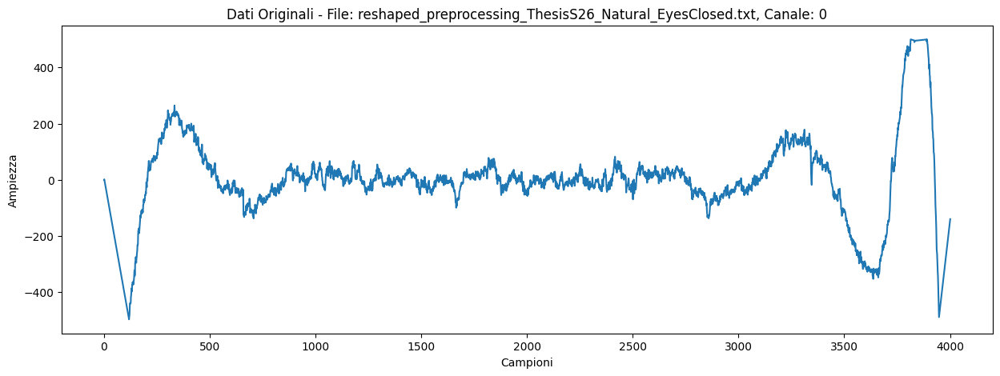

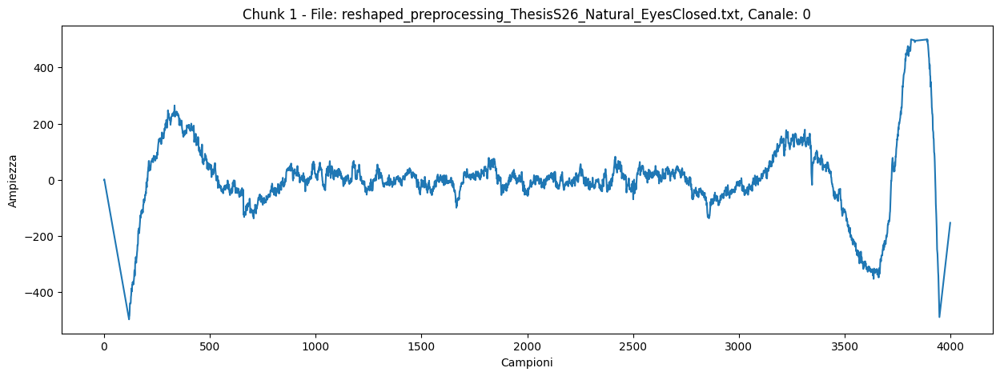

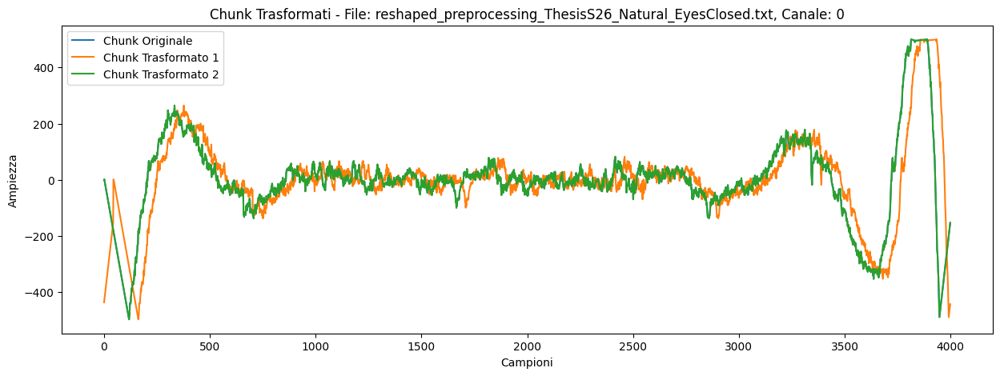

Dataset creato con 2016 chunk totali.
=== Epoca 1/30 ===


/opt/conda/lib/python3.10/site-packages/torch/nn/parallel/parallel_apply.py:79: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.device(device), torch.cuda.stream(stream), autocast(enabled=autocast_enabled):
/opt/conda/lib/python3.10/site-packages/torch/nn/modules/linear.py:117: UserWarning: Attempting to run cuBLAS, but there was no current CUDA context! Attempting to set the primary context... (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/cuda/CublasHandlePool.cpp:135.)
  return F.linear(input, self.weight, self.bias)


Batch 1/201, Perdita: 2.3454
Batch 2/201, Perdita: 2.1904
Batch 3/201, Perdita: 2.1035
Batch 4/201, Perdita: 2.0927
Batch 5/201, Perdita: 1.7192
Batch 6/201, Perdita: 2.1680


KeyboardInterrupt: 

In [16]:
#Esecuzione recurrent encoder training

if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped"
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    encoder = RecurrentEncoder(input_dim=1, output_dim=4)
    projector = Projector(input_dim=4, output_dim=32)
    if len(file_paths) > 0:
        sample_file = file_paths[0]  # Seleziona il primo file come esempio
        
        plot_data_stages(sample_file, channel_idx=0, chunk_size=4000, num_chunks_to_plot=1)
    optimizer = torch.optim.Adam(list(encoder.parameters()) + list(projector.parameters()), lr=1e-4)
    train_contrastive_learning( "Recurrent", file_paths, encoder, projector, optimizer, epochs=30, batch_size=10, device="cuda")

In [ ]:
#Esecuzione covnolutional encoder training
if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped" 
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    encoder = ConvolutionalEncoder(input_channels=1, output_dim=4)
    projector = Projector(input_dim=4, output_dim=32)

    optimizer = torch.optim.Adam(list(encoder.parameters()) + list(projector.parameters()), lr=1e-4)

    train_contrastive_learning("Convolutional", file_paths, encoder, projector, optimizer, epochs=30, batch_size=30, device="cuda")

*****


In [14]:
#TRAINING CLASSIFIER 


# ------------------- Dataset per Classificazione ------------------

class EEGClassificationDataset(Dataset):
    def __init__(self, file_paths, chunk_size=4000):
        self.samples = []
        self.labels = []

        for file_path in file_paths:
            label = extract_label_from_filename(file_path)
            if label is None:
                continue  # Ignora i file con etichette sconosciute

            data = pd.read_csv(file_path, sep='\t', header=None)
            for col in data.columns:
                channel_data = data[col].values.astype(float)
                # Suddivido il dato in chunk
                chunks = chunk_data(channel_data, chunk_size)
                for chunk in chunks:
                    # Applica trasformazioni di data augmentation solo su un chunk 
                    transformed_chunk = apply_random_transformations_class(chunk)
                    self.samples.append(transformed_chunk)
                    self.labels.append(label)

        # distribuzione delle classi
        self.label_counts = {}
        for label in self.labels:
            self.label_counts[label] = self.label_counts.get(label, 0) + 1
        print("Distribuzione delle classi nel dataset:", self.label_counts)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        data = torch.tensor(self.samples[idx], dtype=torch.float32).unsqueeze(-1)
        label = self.labels[idx]

        return data, label

class Classifier(nn.Module):
    def __init__(self, input_dim, num_classes):
        super(Classifier, self).__init__()

        # Stesso blocco del Projector ma con output_dim = num_classes
        self.downsample_1 = nn.Linear(input_dim, 256)
        self.bilstm_256 = nn.LSTM(256, 128, batch_first=True, bidirectional=True)

        self.downsample_2 = nn.Linear(256, 128)
        self.bilstm_128 = nn.LSTM(128, 64, batch_first=True, bidirectional=True)

        self.downsample_3 = nn.Linear(128, 64)
        self.bilstm_64 = nn.LSTM(64, 32, batch_first=True, bidirectional=True)

        self.concat_dense_1 = nn.Linear(256 + 128 + 64, 128)
        self.concat_dense_2 = nn.Linear(128, num_classes) 

        self.log_softmax = nn.LogSoftmax(dim=1)  # Aggiunta del layer LogSoftmax

    def forward(self, x):
        # x ha dimensione [batch_size, seq_len, input_dim]
        x_256 = F.relu(self.downsample_1(x))
        x_256, (h_256, _) = self.bilstm_256(x_256)
        flo_256 = torch.cat([h_256[0], h_256[1]], dim=-1)

        x_128 = F.relu(self.downsample_2(x_256))
        x_128, (h_128, _) = self.bilstm_128(x_128)
        flo_128 = torch.cat([h_128[0], h_128[1]], dim=-1)

        x_64 = F.relu(self.downsample_3(x_128))
        x_64, (h_64, _) = self.bilstm_64(x_64)
        flo_64 = torch.cat([h_64[0], h_64[1]], dim=-1)

        x_concat = torch.cat([flo_256, flo_128, flo_64], dim=-1)

        x_hidden = F.relu(self.concat_dense_1(x_concat))

        output = self.concat_dense_2(x_hidden)

        output = self.log_softmax(output)  # Aggiunta del LogSoftmax

        return output


# ------------------- Funzione di Addestramento per Classificazione -------------------
def train_classifier(model_type, file_paths, encoder, classifier, optimizer, epochs=80, batch_size=10, device="cuda"):
    dataset = EEGClassificationDataset(file_paths)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)

    encoder.eval()  # L'encoder è pre-addestrato e congelato
    for param in encoder.parameters():
        param.requires_grad = False
    encoder.to(device)
    classifier.to(device)

    classifier.train()
    loss_fn = nn.NLLLoss()

    for epoch in range(epochs):
        total_loss = 0
        correct_predictions = 0
        total_predictions = 0

        for batch_idx, (data, labels) in enumerate(dataloader):
            data = data.to(device)
            labels = labels.long().to(device)
            print("labels:", labels)
            # Estrai le embedding utilizzando l'encoder congelato
            with torch.no_grad():
                embeddings = encoder(data)

            # Passa le embedding al classificatore
            logits = classifier(embeddings)

            # Calcola la perdita
            loss = loss_fn(logits, labels)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

            # Calcolo dell'accuratezza
            _, predicted = torch.max(logits, 1)
            correct_predictions += (predicted == labels).sum().item()
            total_predictions += labels.size(0)

            if batch_idx % 10 == 0:
                accuracy = 100 * correct_predictions / total_predictions
                print(f"Epoca {epoch + 1}/{epochs}, Batch {batch_idx + 1}/{len(dataloader)}, Perdita: {loss.item():.4f}, Accuratezza: {accuracy:.2f}%")

        epoch_accuracy = 100 * correct_predictions / total_predictions
        print(f"Epoca {epoch + 1}/{epochs}, Perdita Totale: {total_loss:.4f}, Accuratezza: {epoch_accuracy:.2f}%")
        save_model(classifier, os.path.join(save_path, f"classifier_{model_type}_epoch_{epoch + 1}.pt"))


In [15]:
#Esecuzione Recurrent Encoder CLASSIFICATORE
# ------------------- Esecuzione -------------------
if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped"
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    # Modelli
    encoder = RecurrentEncoder(input_dim=1, output_dim=4)
    load_model(encoder, "/kaggle/input/recurrent_encoder/pytorch/default/1/Recurrent_epoch_30.pth", device="cuda")
    classifier = Classifier(input_dim=4, num_classes=5)

    # Ottimizzatore
    optimizer = torch.optim.Adam(classifier.parameters(), lr=1e-4)

    # Addestramento del classificatore
    train_classifier("Recurrent", file_paths, encoder, classifier, optimizer, epochs=80, batch_size=10, device="cuda")

/tmp/ipykernel_30/3554822503.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(path, map_location=device)


Modello caricato da /kaggle/input/recurrent_encoder/pytorch/default/1/Recurrent_epoch_30.pth
Distribuzione delle classi nel dataset: {2: 1056, 0: 976, 1: 1072, 4: 1904, 3: 1056}
labels: tensor([4, 2, 0, 4, 4, 4, 1, 3, 4, 3], device='cuda:0')
Epoca 1/80, Batch 1/606, Perdita: 1.6071, Accuratezza: 10.00%
labels: tensor([1, 1, 3, 3, 3, 3, 2, 4, 0, 0], device='cuda:0')
labels: tensor([4, 3, 2, 4, 3, 1, 3, 1, 1, 2], device='cuda:0')
labels: tensor([3, 2, 2, 4, 2, 1, 3, 4, 3, 4], device='cuda:0')
labels: tensor([4, 2, 1, 4, 4, 4, 3, 4, 3, 4], device='cuda:0')
labels: tensor([0, 2, 0, 0, 2, 4, 2, 2, 0, 0], device='cuda:0')
labels: tensor([4, 4, 1, 0, 4, 3, 3, 4, 2, 0], device='cuda:0')
labels: tensor([1, 0, 0, 0, 4, 4, 0, 4, 0, 3], device='cuda:0')
labels: tensor([4, 0, 3, 0, 4, 4, 2, 3, 1, 4], device='cuda:0')
labels: tensor([3, 4, 2, 4, 0, 1, 1, 4, 1, 4], device='cuda:0')
labels: tensor([4, 0, 1, 0, 3, 4, 1, 4, 4, 3], device='cuda:0')
Epoca 1/80, Batch 11/606, Perdita: 1.5716, Accuratezza: 

KeyboardInterrupt: 

In [ ]:
#Esecuzione Convolutional Encoder CLASSIFICATORE
# ------------------- Esecuzione -------------------
if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped" 
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    # Modelli
    encoder = ConvolutionalEncoder(input_channels=1, output_dim=4)
    load_model(encoder, "/kaggle/input/convolutional_encoder/pytorch/default/1/Convolutional_epoch_30.pth", device="cuda")
    classifier = Classifier(input_dim=4, num_classes=5)

    # Ottimizzatore
    optimizer = torch.optim.Adam(classifier.parameters(), lr=1e-4)

    # Addestramento del classificatore
    train_classifier("Convolutional", file_paths, encoder, classifier, optimizer, epochs=80, batch_size=30, device="cuda")

**EVALUATION**

***


In [18]:
# ------------------- Funzione di Valutazione -------------------
def load_model(model, path, device="cuda"):
    state_dict = torch.load(path, map_location=device)
   #se usi DataParallel)
    if next(iter(state_dict.keys())).startswith('module.'):
        state_dict = {k.partition('module.')[2]: v for k, v in state_dict.items()}
    model.load_state_dict(state_dict)
    model.to(device)
    print(f"Modello caricato da {path}")
class EEGEvaluationDataset(Dataset):
    def __init__(self, file_paths, chunk_size=4000):
        self.samples = []
        self.labels = []
        self.file_labels = []  # Lista per tenere traccia dei file e delle loro etichette

        for file_path in file_paths:
            label = extract_label_from_filename(file_path)
            if label is None:
                continue  # Ignora i file con etichette sconosciute

            # Stampa il nome del file e la sua etichetta
            print(f"File: {file_path}, Etichetta assegnata: {label}")

            data = pd.read_csv(file_path, sep='\t', header=None)
            for col in data.columns:
                channel_data = data[col].values.astype(float)
                # Suddividi il dato in chunk
                chunks = chunk_data(channel_data, chunk_size)
                for chunk in chunks:
                    # Non applicare data augmentation
                    self.samples.append(chunk)
                    self.labels.append(label)
                    self.file_labels.append((file_path, label))  # Aggiungi il file e l'etichetta corrispondente

        # Verifica la distribuzione delle classi
        self.label_counts = {}
        for label in self.labels:
            self.label_counts[label] = self.label_counts.get(label, 0) + 1
        print("Distribuzione delle classi nel dataset di valutazione:", self.label_counts)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        data = torch.tensor(self.samples[idx], dtype=torch.float32).unsqueeze(-1)
        label = self.labels[idx]
        file_path, file_label = self.file_labels[idx]
        return data, label
def evaluate_classifier(dataset, encoder, classifier, batch_size=10, device="cuda"):
    """
    Valuta un classificatore utilizzando un dataset condiviso.
    """
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

    # Imposta i modelli in modalità valutazione
    encoder.eval()
    classifier.eval()

    all_labels = []
    all_predictions = []

    with torch.no_grad():
        for data, labels in dataloader:
            data = data.to(device)
            labels = labels.long().to(device)

            # Passaggio attraverso l'encoder e il classifier
            embeddings = encoder(data)
            logits = classifier(embeddings)

            # predizioni
            _, predicted = torch.max(logits, 1)

            # Accumulo le etichette e le predizioni
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

    # Calcolo delle metriche
    report = classification_report(all_labels, all_predictions, target_names=['Lab Eyes Closed', 'Lab Eyes Open', 'Natural Eyes Closed', 'Natural Eyes Open', 'Math'])
    cm = confusion_matrix(all_labels, all_predictions)

    print("=== Report di Classificazione ===")
    print(report)
    print("=== Matrice di Confusione ===")
    print(cm)

# ------------------- Funzione di Plot -------------------
def plot_data_stages(file_path, channel_idx=0, chunk_size=4000, num_chunks_to_plot=1):
    # Carica i dati
    data = pd.read_csv(file_path, sep='\t', header=None)
    
    if channel_idx >= len(data.columns):
        print(f"Indice del canale {channel_idx} fuori range. Il file ha {len(data.columns)} canali.")
        return
    
    channel_data = data[channel_idx].values.astype(float)
    
    # 1. Plot dei dati originali (prima del chunking)
    plt.figure(figsize=(15, 5))
    plt.plot(channel_data)
    plt.title(f"Dati Originali - File: {os.path.basename(file_path)}, Canale: {channel_idx}")
    plt.xlabel("Campioni")
    plt.ylabel("Ampiezza")
    plt.show()
    
    # 2. Chunking dei dati
    chunks = chunk_data(channel_data, chunk_size)
    
    # Plot di alcuni chunk
    for i in range(min(num_chunks_to_plot, len(chunks))):
        plt.figure(figsize=(15, 5))
        plt.plot(chunks[i])
        plt.title(f"Chunk {i+1} - File: {os.path.basename(file_path)}, Canale: {channel_idx}")
        plt.xlabel("Campioni")
        plt.ylabel("Ampiezza")
        plt.show()
    
    # 3. Applicazione delle trasformazioni di data augmentation su un chunk e plot
    if len(chunks) > 0:
        original_chunk = chunks[0]
        transformed_1, transformed_2 = apply_random_transformations(original_chunk)
        
        plt.figure(figsize=(15, 5))
        plt.plot(original_chunk, label="Chunk Originale")
        plt.plot(transformed_1, label="Chunk Trasformato 1")
        plt.plot(transformed_2, label="Chunk Trasformato 2")
        plt.title(f"Chunk Trasformati - File: {os.path.basename(file_path)}, Canale: {channel_idx}")
        plt.xlabel("Campioni")
        plt.ylabel("Ampiezza")
        plt.legend()
        plt.show()


Creazione del dataset...
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS19_Natural_EyesClosed.txt, Etichetta assegnata: 2
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS20_Lab_EyesClosed.txt, Etichetta assegnata: 0
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS5_Lab_EyesOpen.txt, Etichetta assegnata: 1
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS23_Lab_EyesClosed.txt, Etichetta assegnata: 0
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS3_Natural_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS9_Natural_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS6_Natural_EyesClosed.txt, Etichetta assegnata: 2
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS9_Lab_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS11_Lab_EyesOpen.txt, Etichetta assegnata: 1
File: /kaggle/input/reshaped/reshaped_pre

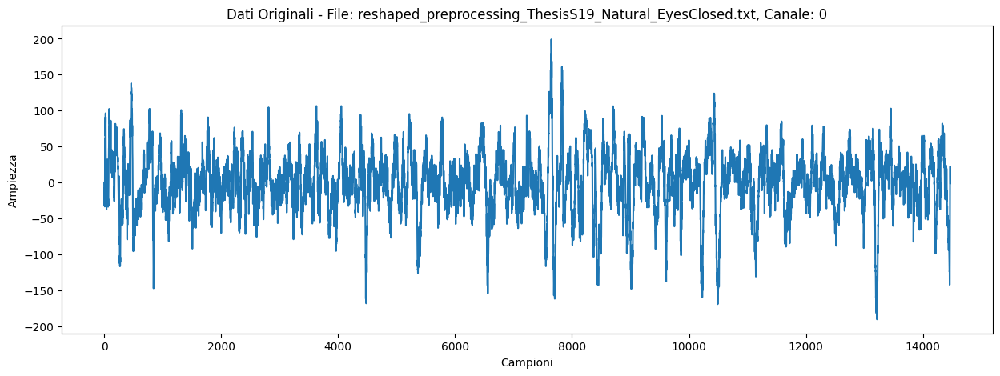

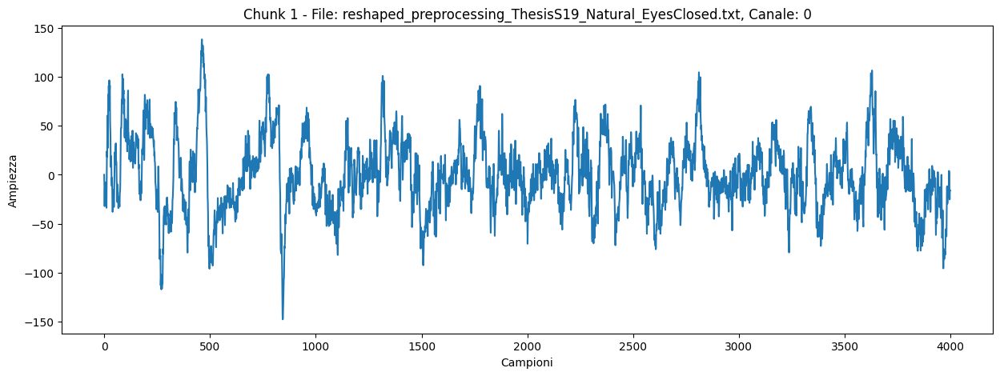

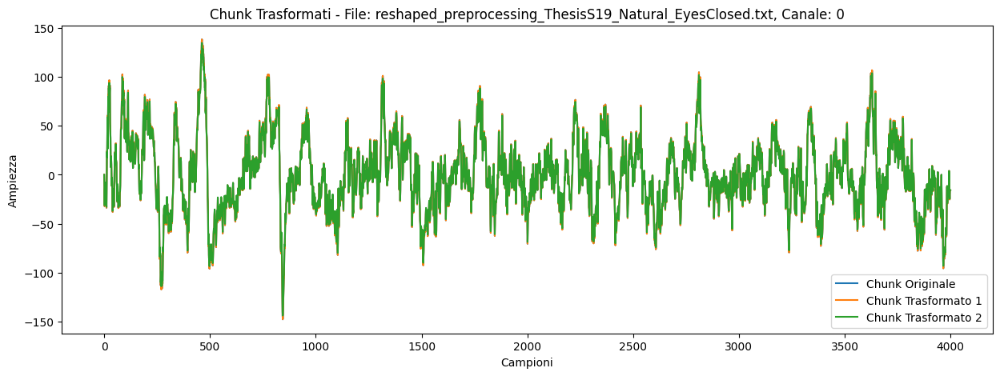


=== Valutazione del modello Convolutional ===


/tmp/ipykernel_30/1560292215.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(path, map_location=device)


Modello caricato da /kaggle/input/convolutional_encoder/pytorch/default/1/Convolutional_epoch_30.pth
Modello caricato da /kaggle/input/convolutional_classifier/pytorch/default/1/classifier_Convolutional_epoch_80.pt
=== Report di Classificazione ===
                     precision    recall  f1-score   support

    Lab Eyes Closed       0.53      0.51      0.52       976
      Lab Eyes Open       0.45      0.58      0.51      1072
Natural Eyes Closed       0.59      0.45      0.51      1056
  Natural Eyes Open       0.52      0.46      0.49      1056
               Math       0.62      0.65      0.63      1904

           accuracy                           0.55      6064
          macro avg       0.54      0.53      0.53      6064
       weighted avg       0.55      0.55      0.55      6064

=== Matrice di Confusione ===
[[ 500  174   65   78  159]
 [ 105  623   74   85  185]
 [ 115  159  474   92  216]
 [ 100  169   92  481  214]
 [ 128  248  104  184 1240]]

=== Valutazione del modello

/tmp/ipykernel_30/1560292215.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(path, map_location=device)


=== Report di Classificazione ===
                     precision    recall  f1-score   support

    Lab Eyes Closed       0.55      0.53      0.54       976
      Lab Eyes Open       0.58      0.51      0.54      1072
Natural Eyes Closed       0.57      0.52      0.54      1056
  Natural Eyes Open       0.54      0.53      0.54      1056
               Math       0.62      0.70      0.66      1904

           accuracy                           0.58      6064
          macro avg       0.57      0.56      0.56      6064
       weighted avg       0.58      0.58      0.58      6064

=== Matrice di Confusione ===
[[ 521   73   93   90  199]
 [  96  551   97  107  221]
 [ 121   87  544  112  192]
 [ 100   82   97  564  213]
 [ 111  164  128  163 1338]]


In [19]:
if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped"  
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    # Creazione del dataset
    print("Creazione del dataset...")
    evaluation_dataset = EEGEvaluationDataset(file_paths, chunk_size=4000)

    # Percorsi per i modelli convolutional
    conv_classifier_path = "/kaggle/input/convolutional_classifier/pytorch/default/1/classifier_Convolutional_epoch_80.pt"
    conv_encoder_path = "/kaggle/input/convolutional_encoder/pytorch/default/1/Convolutional_epoch_30.pth"

    # Percorsi per i modelli recurrent
    recurrent_classifier_path = "/kaggle/input/recurrent_classifier/pytorch/default/1/classifier_Recurrent_epoch_80.pt"
    recurrent_encoder_path = "/kaggle/input/recurrent_encoder/pytorch/default/1/Recurrent_epoch_30.pth"
    
    if len(file_paths) > 0:
        sample_file = file_paths[0]  
        plot_data_stages(sample_file, channel_idx=0, chunk_size=4000, num_chunks_to_plot=1)
    
    # Valutazione del modello convolutional
    print("\n=== Valutazione del modello Convolutional ===")
    conv_encoder = ConvolutionalEncoder(input_channels=1, output_dim=4)
    conv_classifier = Classifier(input_dim=4, num_classes=5)
    load_model(conv_encoder, conv_encoder_path, device="cuda")
    load_model(conv_classifier, conv_classifier_path, device="cuda")
    evaluate_classifier(evaluation_dataset, conv_encoder, conv_classifier, batch_size=30, device="cuda")

    # Valutazione del modello recurrent
    print("\n=== Valutazione del modello Recurrent ===")
    recurrent_encoder = RecurrentEncoder(input_dim=1, output_dim=4)
    recurrent_classifier = Classifier(input_dim=4, num_classes=5)
    load_model(recurrent_encoder, recurrent_encoder_path, device="cuda")
    load_model(recurrent_classifier, recurrent_classifier_path, device="cuda")
    evaluate_classifier(evaluation_dataset, recurrent_encoder, recurrent_classifier, batch_size=10, device="cuda")

/tmp/ipykernel_30/995847157.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(path, map_location=device)


Modello caricato da /kaggle/input/convolutional_encoder/pytorch/default/1/Convolutional_epoch_30.pth
Modello caricato da /kaggle/input/convolutional_classifier/pytorch/default/1/classifier_Convolutional_epoch_80.pt


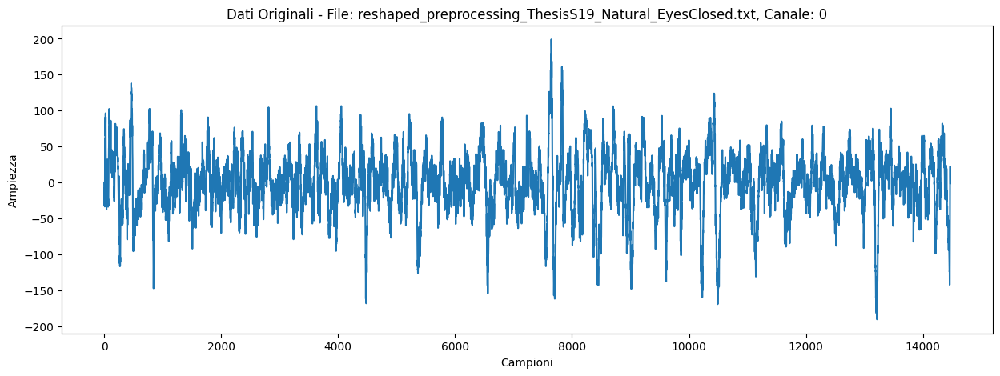

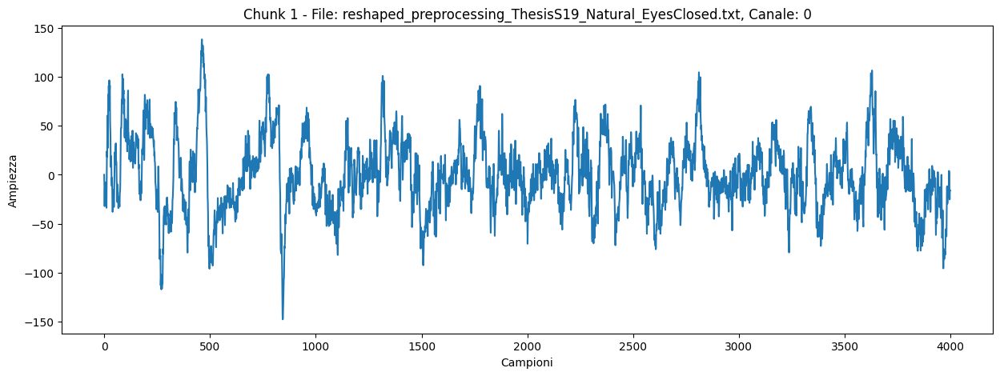

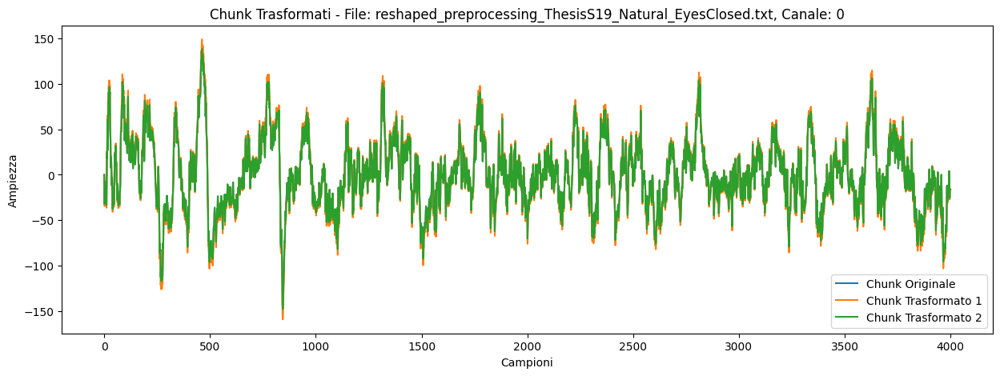

File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS19_Natural_EyesClosed.txt, Etichetta assegnata: 2
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS20_Lab_EyesClosed.txt, Etichetta assegnata: 0
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS5_Lab_EyesOpen.txt, Etichetta assegnata: 1
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS23_Lab_EyesClosed.txt, Etichetta assegnata: 0
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS3_Natural_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS9_Natural_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS6_Natural_EyesClosed.txt, Etichetta assegnata: 2
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS9_Lab_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS11_Lab_EyesOpen.txt, Etichetta assegnata: 1
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS19_Natu

In [14]:
#Evaluate conv classifier VECCHIA VERSIONE
"""if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped"  # Percorso ai file .txt
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    # Percorsi ai modelli salvati
    classifier_path = "/kaggle/input/convolutional_classifier/pytorch/default/1/classifier_Convolutional_epoch_80.pt"  # Sostituisci con il percorso corretto
    encoder_path = "/kaggle/input/convolutional_encoder/pytorch/default/1/Convolutional_epoch_30.pth"
    # Inizializza i modelli
    encoder = ConvolutionalEncoder(input_channels=1, output_dim=4)
    classifier = Classifier(input_dim=4, num_classes=5)

    # Carica i modelli pre-addestrati
    load_model(encoder, encoder_path, device="cuda")
    load_model(classifier, classifier_path, device="cuda")
    if len(file_paths) > 0:
        sample_file = file_paths[0]  # Seleziona il primo file come esempio
        # Puoi modificare channel_idx per visualizzare altri canali
        plot_data_stages(sample_file, channel_idx=0, chunk_size=4000, num_chunks_to_plot=1)

    # Esegui la valutazione
    evaluate_classifier(file_paths, encoder, classifier, batch_size=30, device="cuda")"""

/tmp/ipykernel_30/995847157.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(path, map_location=device)


Modello caricato da /kaggle/input/recurrent_encoder/pytorch/default/1/Recurrent_epoch_30.pth
Modello caricato da /kaggle/input/recurrent_classifier/pytorch/default/1/classifier_Recurrent_epoch_80.pt


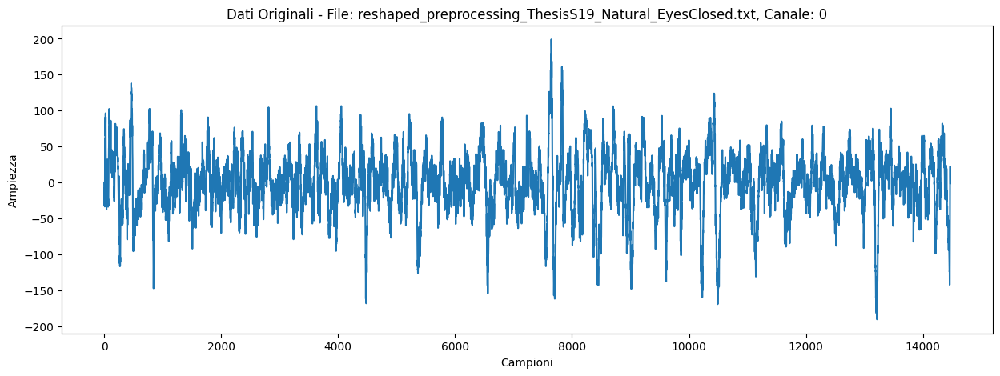

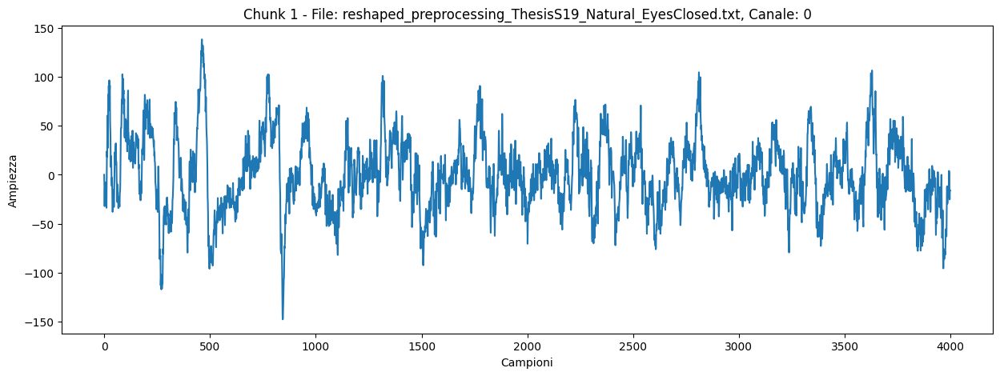

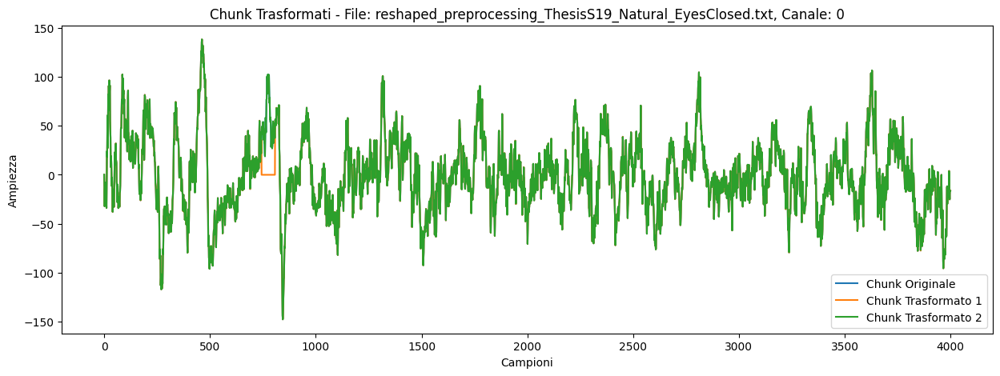

File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS19_Natural_EyesClosed.txt, Etichetta assegnata: 2
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS20_Lab_EyesClosed.txt, Etichetta assegnata: 0
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS5_Lab_EyesOpen.txt, Etichetta assegnata: 1
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS23_Lab_EyesClosed.txt, Etichetta assegnata: 0
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS3_Natural_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS9_Natural_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS6_Natural_EyesClosed.txt, Etichetta assegnata: 2
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS9_Lab_Math.txt, Etichetta assegnata: 4
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS11_Lab_EyesOpen.txt, Etichetta assegnata: 1
File: /kaggle/input/reshaped/reshaped_preprocessing_ThesisS19_Natu

KeyboardInterrupt: 

In [15]:
#Evaluate recurrent classifier VECCHIA VERSIONE
"""if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped"  # Percorso ai file .txt
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    # Percorsi ai modelli salvati
    classifier_path = "/kaggle/input/recurrent_classifier/pytorch/default/1/classifier_Recurrent_epoch_80.pt"  # Sostituisci con il percorso corretto
    encoder_path = "/kaggle/input/recurrent_encoder/pytorch/default/1/Recurrent_epoch_30.pth"
    # Inizializza i modelli
    encoder = RecurrentEncoder(input_dim=1, output_dim=4)
    classifier = Classifier(input_dim=4, num_classes=5)

    # Carica i modelli pre-addestrati
    load_model(encoder, encoder_path, device="cuda")
    load_model(classifier, classifier_path, device="cuda")
    if len(file_paths) > 0:
        sample_file = file_paths[0]  # Seleziona il primo file come esempio
        # Puoi modificare channel_idx per visualizzare altri canali
        plot_data_stages(sample_file, channel_idx=0, chunk_size=4000, num_chunks_to_plot=1)

    # Esegui la valutazione
    evaluate_classifier(file_paths, encoder, classifier, batch_size=10, device="cuda")"""

In [ ]:
#TRAINING ENCODER CON ETICHETTE fase di test per controllo su tutte le etichette
import os
import random
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset

def min_max_amplitude_scale(data, scale_min=0.5, scale_max=2):
    scale_factor = random.uniform(scale_min, scale_max)
    return data * scale_factor

def time_shift(data, shift_min=-50, shift_max=50):
    shift_samples = random.randint(shift_min, shift_max)
    return np.roll(data, shift_samples)

def dc_shift(data, shift_min=-10, shift_max=10):
    shift_value = random.uniform(shift_min, shift_max)
    return data + shift_value

def zero_masking(data, mask_min=0, mask_max=150):
    mask_size = random.randint(mask_min, mask_max)
    start_idx = random.randint(0, len(data) - mask_size)
    data[start_idx:start_idx+mask_size] = 0
    return data

def add_gaussian_noise(data, sigma_min=0, sigma_max=0.2):
    sigma = random.uniform(sigma_min, sigma_max)
    noise = np.random.normal(0, sigma, len(data))
    return data + noise

class CompleteContrastiveDatasetWithLabels(Dataset):
    def __init__(self, file_paths, chunk_size=4000):
        self.all_chunks = []  # Contiene tutti i chunk da tutti i file
        self.labels = []  # Contiene le etichette corrispondenti ai chunk

        for file_path in file_paths:
            # Estrai l'etichetta dal nome del file
            label = extract_label_from_filename(file_path)
            if label is None:
                continue  # Ignora i file con etichette sconosciute

            # Leggi il file
            data = pd.read_csv(file_path, sep='\t', header=None)

            # Dividi ogni colonna in chunk
            for col in data.columns:
                channel_data = data[col].values.astype(float)
                chunks = chunk_data(channel_data, chunk_size)

                # Aggiungi tutti i chunk e le etichette corrispondenti
                self.all_chunks.extend(chunks)
                self.labels.extend([label] * len(chunks))  # Stessa etichetta per tutti i chunk

        print(f"Dataset creato con {len(self.all_chunks)} chunk totali.")

    def __len__(self):
        return len(self.all_chunks)

    def __getitem__(self, idx):
        # Chunk e etichetta corrispondente
        chunk = self.all_chunks[idx]
        label = self.labels[idx]

        # Crea trasformazioni per le coppie positive
        transformed_1, transformed_2 = apply_random_transformations(chunk)

        # Seleziona un chunk casuale diverso per creare coppie negative
        neg_idx = random.randint(0, len(self.all_chunks) - 1)
        while neg_idx == idx:
            neg_idx = random.randint(0, len(self.all_chunks) - 1)
        negative_chunk = self.all_chunks[neg_idx]

        # Ritorna i chunk trasformati, un negativo casuale e l'etichetta
        data1 = torch.tensor(transformed_1, dtype=torch.float32).unsqueeze(-1)
        data2 = torch.tensor(transformed_2, dtype=torch.float32).unsqueeze(-1)
        negative = torch.tensor(negative_chunk, dtype=torch.float32).unsqueeze(-1)

        return data1, data2, negative, label


# Funzione per estrarre l'etichetta dal nome del file
def extract_label_from_filename(file_name):
    file_name = os.path.basename(file_name)
    if "Lab" in file_name and "EyesClosed" in file_name:
        return 0  # Lab Eyes Closed
    elif "Lab" in file_name and "EyesOpen" in file_name:
        return 1  # Lab Eyes Open
    elif "Natural" in file_name and "EyesClosed" in file_name:
        return 2  # Natural Eyes Closed
    elif "Natural" in file_name and "EyesOpen" in file_name:
        return 3  # Natural Eyes Open
    elif "Math" in file_name:
        return 4  # Math
    else:
        print(f"Attenzione: classe sconosciuta per il file: {file_name}. Il file verrà ignorato.")
        return None


# Funzione per suddividere i dati in chunk
def chunk_data(data, chunk_size=4000):
    chunks = []
    num_chunks = len(data) // chunk_size
    for i in range(num_chunks):
        start_idx = i * chunk_size
        end_idx = (i + 1) * chunk_size
        chunks.append(data[start_idx:end_idx])
    return chunks


# Funzione per testare la presenza di tutte le etichette
def check_labels_in_batches(dataloader):
    for batch_idx, (data1, data2, negative, labels) in enumerate(dataloader):
        unique_labels = set(labels.tolist())
        print(f"Batch {batch_idx + 1}: Labels -> {sorted(unique_labels)}")
        if len(unique_labels) < 5:
            print(f"Attenzione: batch {batch_idx + 1} non contiene tutte le etichette!")


class ConvolutionalEncoder(nn.Module):
    def __init__(self, input_channels=1, output_dim=4, repeat_blocks=4):
        super(ConvolutionalEncoder, self).__init__()
        
        # Parallel convolutional paths
        self.conv1d_128 = nn.Sequential(
            nn.ReflectionPad1d((63, 64)),
            nn.Conv1d(input_channels, 100, kernel_size=128, stride=1)
        )
        self.conv1d_64 = nn.Sequential(
            nn.ReflectionPad1d((31, 32)),
            nn.Conv1d(input_channels, 100, kernel_size=64, stride=1)
        )
        self.conv1d_16 = nn.Sequential(
            nn.ReflectionPad1d((7, 8)),
            nn.Conv1d(input_channels, 50, kernel_size=16, stride=1)
        )

        # Dense layer to merge paths
        self.concat_dense = nn.Linear(100 + 100 + 50, 250)

        # Repeat N=4 blocks
        self.repeat_blocks = nn.ModuleList([
            nn.Sequential(
                nn.ReLU(),
                nn.BatchNorm1d(250),
                nn.ReflectionPad1d((31, 32)),
                nn.Conv1d(250, 250, kernel_size=64, stride=1)
            ) for _ in range(repeat_blocks)
        ])

        # Final block
        self.final_relu = nn.ReLU()
        self.final_bn = nn.BatchNorm1d(250)
        self.final_conv = nn.Sequential(
            nn.ReflectionPad1d((31, 32)),
            nn.Conv1d(250, output_dim, kernel_size=64, stride=1)
        )
        

    def forward(self, x):
        # Input shape: [batch_size, sequence_length, channels]
        x = x.permute(0, 2, 1)  # Change to [batch_size, channels, sequence_length]
        
        # Parallel convolutional paths
        x1 = self.conv1d_128(x)
        x2 = self.conv1d_64(x)
        x3 = self.conv1d_16(x)

        # Concatenate paths
        x_cat = torch.cat([x1, x2, x3], dim=1)  # [batch_size, 250, sequence_length]
        
        # Dense layer
        x_dense = self.concat_dense(x_cat.permute(0, 2, 1)).permute(0, 2, 1)

        # Repeated blocks
        x_repeated = x_dense
        for block in self.repeat_blocks:
            x_repeated = x_repeated + block(x_repeated)  # Residual connection

        # Final block
        x_final = self.final_relu(x_repeated)
        x_final = self.final_bn(x_final)
        x_final = self.final_conv(x_final)
        x_final = x_final.permute(0, 2, 1)
        #print("xfinal:", x_final.shape)
        return x_final  # [batch_size, output_dim]


class Projector(nn.Module):
    def __init__(self, input_dim, output_dim=32):
        super(Projector, self).__init__()

        self.downsample_1 = nn.Linear(input_dim, 256)
        self.bilstm_256 = nn.LSTM(256, 128, batch_first=True, bidirectional=True)

        self.downsample_2 = nn.Linear(256, 128)
        self.bilstm_128 = nn.LSTM(128, 64, batch_first=True, bidirectional=True)

        self.downsample_3 = nn.Linear(128, 64)
        self.bilstm_64 = nn.LSTM(64, 32, batch_first=True, bidirectional=True)

        self.concat_dense_1 = nn.Linear(256 + 128 + 64, 128)
        self.concat_dense_2 = nn.Linear(128, output_dim)

    def forward(self, x):
        #print("Input x:", x.shape)

        x_256 = F.relu(self.downsample_1(x))
        #print("Output x_256 (Downsample):", x_256.shape)

        x_256, (h_256, _) = self.bilstm_256(x_256)
        flo_256 = torch.cat([h_256[0], h_256[1]], dim=-1)
        #print("Output flo_256 (BiLSTM):", flo_256.shape)

        x_128 = F.relu(self.downsample_2(x_256))
        #print("Output x_128 (Downsample):", x_128.shape)

        x_128, (h_128, _) = self.bilstm_128(x_128)
        flo_128 = torch.cat([h_128[0], h_128[1]], dim=-1)
        #print("Output flo_128 (BiLSTM):", flo_128.shape)

        x_64 = F.relu(self.downsample_3(x_128))
        #print("Output x_64 (Downsample):", x_64.shape)

        x_64, (h_64, _) = self.bilstm_64(x_64)
        flo_64 = torch.cat([h_64[0], h_64[1]], dim=-1)
        #print("Output flo_64 (BiLSTM):", flo_64.shape)

        x_concat = torch.cat([flo_256, flo_128, flo_64], dim=-1)
        #print("Output x_concat (Concat):", x_concat.shape)

        x_hidden = F.relu(self.concat_dense_1(x_concat))
        #print("Output x_hidden (Dense):", x_hidden.shape)

        output = self.concat_dense_2(x_hidden)
        #print("Final Output projector:", output.shape)
        return output
        
class NTXentLoss(nn.Module):
    def __init__(self, temperature=0.05):
        super(NTXentLoss, self).__init__()
        self.temperature = temperature

    def forward(self, z_i, z_j, z_neg):
        z_i = F.normalize(z_i, p=2, dim=-1)
        z_j = F.normalize(z_j, p=2, dim=-1)

        z_neg = F.normalize(z_neg, p=2, dim=-1)

        # Similarità
        sim_ij = torch.matmul(z_i, z_j.T) / self.temperature  # Positiva
        sim_neg = torch.matmul(z_i, z_neg.T) / self.temperature  # Negative

        # Calcolo della loss
        numerator = torch.exp(sim_ij.diag())
        denominator = numerator + torch.sum(torch.exp(sim_neg), dim=1)

        loss = -torch.log(numerator / denominator)
        return loss.mean()
        
save_path="/kaggle/working/models"
os.makedirs(save_path, exist_ok=True)
def save_model(model, path):
    torch.save(model.state_dict(), path)
    print(f"Modello salvato in {path}")
    
def load_model(model, path):
    model.load_state_dict(torch.load(path))
    print(f"Modello caricato da {path}")
    
def train_contrastive_learning(file_paths, encoder, projector, optimizer, epochs=10, batch_size=10, device="cuda"):
    loss_fn = NTXentLoss()

    # Dataset e DataLoader
    dataset = CompleteContrastiveDatasetWithLabels(file_paths, chunk_size=4000)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)
    
    # Parallelizzazione su più GPU
    encoder = nn.DataParallel(encoder)
    projector = nn.DataParallel(projector)
    encoder.to(device)
    projector.to(device)

    for epoch in range(epochs):
        print(f"=== Epoca {epoch + 1}/{epochs} ===")
        total_loss = 0

        for batch_idx, (data1, data2, neg_data, labels) in enumerate(dataloader):
            data1, data2, neg_data, labels = (
                data1.to(device),
                data2.to(device),
                neg_data.to(device),
                labels.to(device),
            )

            # Verifica delle etichette nel batch
            unique_labels = set(labels.tolist())
            print(f"Batch {batch_idx + 1}: Labels -> {sorted(unique_labels)}")
            if len(unique_labels) < 5:
                print(f"Attenzione: il batch {batch_idx + 1} non contiene tutte le etichette!")

            # Passaggio attraverso encoder e projector
            z1 = projector(encoder(data1))
            z2 = projector(encoder(data2))
            z_neg = projector(encoder(neg_data))

            # Calcolo della loss
            loss = loss_fn(z1, z2, z_neg)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            print(f"Batch {batch_idx + 1}/{len(dataloader)}, Perdita: {loss.item():.4f}")

        print(f"Perdita totale per epoca {epoch + 1}: {total_loss:.4f}")



if __name__ == "__main__":
    folder_path = "/kaggle/input/reshaped"  # Percorso ai file .txt
    file_paths = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.txt')]

    encoder = ConvolutionalEncoder(input_channels=1, output_dim=4)
    projector = Projector(input_dim=4, output_dim=32)

    optimizer = torch.optim.Adam(list(encoder.parameters()) + list(projector.parameters()), lr=1e-4)

    train_contrastive_learning(file_paths, encoder, projector, optimizer, epochs=10, batch_size=10, device="cuda")